In [1]:
import numpy as np
import matplotlib.pyplot as plt
import scipy
import sympy
import mpmath
from scipy import stats
from sklearn.neighbors import KernelDensity
import functools
import pandas as pd
import math
import random
import seaborn as sns
import itertools
from itertools import groupby
#import separation_algorithm as sepa
#import functions_eye_tracker_project as funcs
import sklearn
import os
from sklearn.neighbors import KernelDensity
from sklearn.linear_model import LinearRegression
import os
from sklearn.neighbors import KernelDensity
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
import copy
from sklearn.linear_model import LogisticRegressionCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.inspection import permutation_importance

In [2]:
def angle_two_vector(ldx,ldy):
    if np.any(np.isnan(ldx)):
        print("nan in input vector")
        return("nan in input vector")
    if np.any(np.isnan(ldy)):
        print("nan in input vector")
        return("nan in input vector")
    if len(ldx) != len(ldy):
        print("len of vectors should be the same")
        return( "len of vectors should be the same")
    angle_vec = []
    for i in range(len(ldx)-1):
        ldx_1 = ldx[i]
        ldx_2 = ldx[i+1]
        ldy_1 = ldy[i]
        ldy_2 = ldy[i+1]
        if (np.sqrt(ldx_1**2 +ldy_1**2)*np.sqrt(ldx_2**2 +ldy_2**2)) ==0:
            angle_vec.append(1)
        else:
            cos = (ldx_1*ldx_2 + ldy_1*ldy_2)/(np.sqrt(ldx_1**2 +ldy_1**2)*np.sqrt(ldx_2**2 +ldy_2**2))
            sin = (ldx_1*ldy_2 - ldy_1*ldx_2)/(np.sqrt(ldx_1**2 +ldy_1**2)*np.sqrt(ldx_2**2 +ldy_2**2))
            
            l_ang = np.angle(cos+sin*1.0j,deg = True)
            #if l_ang <0:
            #    l_ang = 360 + l_ang
            
            #l_ang = np.sign(180-l_ang)*np.min(np.abs(l_ang),np.abs(l_ang-360))
            angle_vec.append(l_ang)
            
        
        
            if 1.000000001 < abs(cos) or 1.000000001 < abs(sin)  :
                print( "error, cosine should be less than one")
        
    return(angle_vec)

        
############################# #1 - one variable ########################



def frequency_matrix_2D(d__ss,threshold,normalized):
    d__ss = np.array(d__ss)
    d__ss = (d__ss-min(d__ss))/((max(d__ss)-min(d__ss))*1.000001)
    binary_vector = np.array(d__ss>threshold).astype(int)
    matrix = np.histogram2d(binary_vector[1:], binary_vector[:-1],[0,1,2])[0]
    if normalized:
        for j in range(2):
            matrix[j,:] = matrix[j,:]/matrix.sum(axis=1)[j]
    return( matrix)
    

          

#in threshold array, 0 corresponds to the minimum of the vector while 1 is the maximum of the vector
def form_groups(vector,threshold_array,graph,x_label,title,x_axis_format):
    
    detectionfisher=[]
    detection=[]
    for i in threshold_array:
        matrix = frequency_matrix_2D(vector,i,False)
        detectionfisher.append(np.log(scipy.stats.fisher_exact(matrix)[1]))
        p = matrix.sum(axis=1)[0]/matrix.sum()
        if p==1 or p==0:
            detection.append(1)
        else:
            detection.append((matrix[1][0]) / (matrix.sum() *(p*(1-p))))

    
    minim = min(vector)
    diff = max(vector) - minim
    min_k = np.argmin(detection)*diff + minim
    min_fisher = np.argmin(detectionfisher)*diff + minim
    
    if graph:

        xticks_labels = [x_axis_format % (minim + diff*pipi) for pipi in threshold_array]
        
        
        plt.plot(detection)
        plt.xlabel(x_label)
        #plt.title(title +"k min = " +str(round(min_k,5)))
        plt.title(title)
        if len(threshold_array) > 40:
            plt.xticks(np.arange(len(threshold_array))[::int(len(threshold_array)/10)],xticks_labels[::int(len(threshold_array)/10)])
        else:
            plt.xticks(np.arange(len(threshold_array))[::4],xticks_labels[::4])
        plt.ylabel("k")
        plt.savefig("group_detection - k " + x_label + title+".png",dpi = 500)
        plt.show()
        plt.close()

        
        plt.plot(detectionfisher)
        plt.xlabel(x_label)
        plt.title(title)
        if len(threshold_array) > 40:
            plt.xticks(np.arange(len(threshold_array))[::int(len(threshold_array)/10)],xticks_labels[::int(len(threshold_array)/10)])
        else:
            plt.xticks(np.arange(len(threshold_array))[::4],xticks_labels[::4])
        plt.ylabel("log-fisher exact test")
        plt.savefig("group_detection - log-fisher " + x_label +title+ ".png",dpi = 500)
        plt.show()
        plt.close()
    
   
    return(detection, detectionfisher, min_k,min_fisher)
######################### 2 variables ################

def frequency_matrix_2D_multiple_angle(d__ss,angles,threshold,threshold2):
    
    d__ss = np.array(d__ss)
    d__ss = (d__ss-min(d__ss))/((max(d__ss)-min(d__ss))*1.000001)
    
    binary_vector1 = np.array(d__ss>threshold).astype(int)
    binary_vector2 = np.array(d__ss>threshold).astype(int)
    
    
    
    matrix = np.histogram2d(binary_vector[1:], binary_vector[:-1],[0,1,2])[0]
    if normalized:
        for j in range(2):
            matrix[j,:] = matrix[j,:]/matrix.sum(axis=1)[j]
            
            
            
    #vec1 = 
    new_bin = binary_vector_2D_multiple_angle(d__ss,angles,threshold,threshold2,min_consecutive_saccades_allowed)
    
    matrix = np.zeros((2,2))
    for i in range(len(new_bin)-1):
        matrix[int(new_bin[i])][int(new_bin[i+1])] +=1
        

    return( matrix)

def form_groups_2vec(vector1,vector2,lthreshold_array1,lthreshold_array2,min_consecutive_saccades_allowed):
    
    detectionfisher=[]
    detection=[]
#    threshold_array1 = lthreshold_array1/np.max(lthreshold_array1)
#    threshold_array2 = lthreshold_array2/np.max(lthreshold_array2)
    
    for i in range(len(lthreshold_array1)):
        detection.append([])
        detectionfisher.append([])
        for j in range(len(lthreshold_array2)):
            matrix = frequency_matrix_2D_multiple_angle(vector1,vector2,threshold_array1[i],threshold_array2[j])
            detectionfisher[i].append(np.log(scipy.stats.fisher_exact(matrix)[1]))
            p = matrix.sum(axis=0)[0]/matrix.sum()
            if p==1 or p==0:
                detection[i].append(1)
            else:
                detection[i].append((matrix[1][0])/(matrix.sum()*(p*(1-p))))
        
    
    min_k = np.min(detection)
    min_fisher = np.min(detectionfisher)
    vec1_min_k = lthreshold_array1[int(np.argmin(detection)/len(lthreshold_array1))]
    vec2_min_k =  lthreshold_array2[int(np.argmin(detection)%len(lthreshold_array2))]
    vec1_min_fisher = lthreshold_array1[int(np.argmin(detectionfisher)/len(lthreshold_array1))]
    vec2_min_fisher =  lthreshold_array2[int(np.argmin(detectionfisher)%len(lthreshold_array2))]
    
    return( detection,detectionfisher,min_k , min_fisher , vec1_min_k, vec2_min_k, vec1_min_fisher, vec2_min_fisher )

def frequency_matrix_2D(d__ss,threshold,normalized):
    d__ss = np.array(d__ss)
    d__ss = (d__ss-min(d__ss))/((max(d__ss)-min(d__ss))*1.000001)
    binary_vector = np.array(d__ss>threshold).astype(int)
    matrix = np.histogram2d(binary_vector[1:], binary_vector[:-1],[0,1,2])[0]
    if normalized:
        for j in range(2):
            matrix[j,:] = matrix[j,:]/matrix.sum(axis=1)[j]
    return( matrix)

###############################################


def real_k_and_fisher(binary_vector):
    matrix = np.zeros((2,2))
    for i in range(len(binary_vector)-1):
        matrix[int(binary_vector[i])][int(binary_vector[i+1])] +=1
    
    detectionfisher=[]
    detection=[]

    detectionfisher.append(np.log(scipy.stats.fisher_exact(matrix)[1]))
    p = matrix.sum(axis=1)[0]/matrix.sum()
    detection.append((matrix[1][0])/(matrix.sum()*(p*(1-p))))

    return( matrix,detection, detectionfisher)



In [3]:
def r_square(l_emp_points,l_emp_fit):
    l_num = np.mean((np.array(l_emp_points)-np.array(l_emp_fit))**2)
    l_den = np.std(np.array(l_emp_points))**2
    return(1 - l_num/l_den)


def adjusted_r_square(l_emp_points,l_emp_fit,degrees_freedom):
    n = len(l_emp_points)
    l_num = np.mean((np.array(l_emp_points)-np.array(l_emp_fit))**2)
    l_den = np.std(np.array(l_emp_points))**2
    rsqu = 1 - l_num/l_den
    return( 1 - (1 -rsqu)*( (n-1)/(n-degrees_freedom)  ))
    
    
    
def powerl_fit(l_tau,l_k,l_a):
    return(l_k*np.power(2,l_tau*l_a))

def Expr_variable_change(l_alpha,l_beta,D,v):
    l_lambdaD = l_beta(1-l_alpha)
    l_lambdaB = l_alpha*l_beta
    return(l_lambdaD,l_lambdaB,D,v)

def Expr_variable_change2(l_lambdaD,l_lambdaB,D,v):
    l_beta = l_lambdaB + l_lambdaD
    l_alpha = l_lambdaB/(l_beta)    
    return(l_alpha,l_beta,D,v)

def first_estimate_ple_averages_inc(l_emp_points,l_tau_list):
    if l_tau_list[1] != 2 * l_tau_list[0]:
        print("please use consecutive taus")
    if l_tau_list[2] != 2 * l_tau_list[1]:
        print("please use consecutive taus")
    
    lmbda_b = -(np.log(np.sqrt( (-l_emp_points[2] + 2*l_emp_points[1])/(-l_emp_points[1] + 2*l_emp_points[0])  ) - 1))/(l_tau_list[0])
    lk = np.exp(-lmbda_b*l_tau_list[0])
    
    C11 =  (-l_emp_points[1] + 2*l_emp_points[0]) /(1-lk)**2
    C12 =  (-l_emp_points[2] + 2*l_emp_points[1]) /(1-lk**2)**2
    l_C1 = (C11 + C12)/2
    
    C21 = (l_emp_points[0] - l_C1*(1-lk))/(l_tau_list[0])
    C22 = (l_emp_points[1] - l_C1*(1-lk**2))/(2*l_tau_list[0])
    C23 = (l_emp_points[2] - l_C1*(1-lk**4))/(4*l_tau_list[0])
    
    l_C2 = (C21 + C22 + C23)/3
    l_valid = 0
    if lmbda_b>0:
        if l_C2>0:
            l_valid = 1
    
    return([l_C1,l_C2,lmbda_b],l_valid)

def optimize(l_emp_points,l_tau_list,l_p0,max_iter,cutoff):
    init_ratio = 0.8
    C1_i,C2_i,lm_i = l_p0
    l_emp_points = np.log2(l_emp_points)
    log_tau_list = np.log2(l_tau_list)
    tau_log_incr =np.diff(log_tau_list)
    
    first_min_found = False
    
    if np.sum(tau_log_incr!=1)>0:
        print("tau list should be exponential with base 2")
#    print(l_emp_points)
    
    for i in range(max_iter):
        ratio = init_ratio+1
        C1_i,C2_i,lm_i =  C1_i/ratio,C2_i/ratio,lm_i/ratio
        error_list = []
        for factor1 in range(3):
            for factor2 in range(3):
                for factor3 in range(3):    
                    new_fit = log2_moment_scaling(l_tau_list,C1_i*(ratio**factor1),C2_i*(ratio**factor2),lm_i*(ratio**factor3))
                    new_fit[np.isnan(new_fit)] = 0
                    error_list.append(np.mean(( np.array(new_fit)-l_emp_points )**2))
#                    if factor1==factor2==factor3==1:
#                        print(log2_moment_scaling(l_tau_list,C1_i*(ratio**factor1),C2_i*(ratio**factor2),lm_i*(ratio**factor3)))
#                        print(C1_i*(ratio**factor1),C2_i*(ratio**factor2),lm_i*(ratio**factor3))
        
#        print(error_list)
        
        index_opt = np.argmin(error_list)
        opt_f1 = int(index_opt/9)
        opt_f2 = int( (index_opt%9)/3 )
        opt_f3 = int( index_opt%3 )
        C1_i = C1_i*(ratio**opt_f1)
        C2_i = C2_i*(ratio**opt_f2)
        lm_i = lm_i*(ratio**opt_f3)
#        print(opt_f1,opt_f2,opt_f3)
        
        if index_opt == 13:
            init_ratio = init_ratio/1.9
            first_min_found = True
        else:
            if not first_min_found:
                init_ratio = 1.9*init_ratio
                if i>cutoff:
                    return(C1_i,C2_i,lm_i)
                
    return(C1_i,C2_i,lm_i)

def Sergyi_expr_simp1(l_tau,l_alpha,l_beta,D,v):
    
    C1 = 2*((v/l_beta)**2) * (l_alpha - 1)/(l_alpha**2)
    C2 = 2*((1-l_alpha)/l_alpha) * ((v**2)/l_beta) + 4*D*l_alpha
    
    return(C1*(1-np.exp(-l_alpha*l_beta*l_tau)) + C2*l_tau )

def moment_scaling(tau_l,C1,C2,l_lambdaB):
    return(C1*(np.ones(len(tau_l))-np.exp(-l_lambdaB*np.array(tau_l)))  + C2*np.array(tau_l) )

def log2_moment_scaling(tau_l,C1,C2,l_lambdaB):
    return(np.log2(C1*(np.ones(len(tau_l))-np.exp(-l_lambdaB*np.array(tau_l)))  + C2*np.array(tau_l) ))

    
    
    
def C2_new2(l_alpha,l_beta,D,v):
    C2 = 2*((1-l_alpha)/l_alpha) * ((v**2)/l_beta) + 2*D*l_alpha
    return(C2)
    
def C3_new2(l_alpha,l_beta,D,v):
    C3 = 2*((1-l_alpha)/(l_alpha**2)) *((v/l_beta)**2)
    return(C3)
def C1_new2(l_alpha,l_beta,D,v):
    C1 = 2*((v/l_beta)**2) * (l_alpha - 1)/(l_alpha**2)
    return(C1)


def intermittent2(nt,dt,mean_bal_sac,diffusion,rate12,rate21):

    P1 = rate21/(rate12+rate21)
    if np.random.random()<P1:
        regime=1
        waitt   = -math.log(1.0-np.random.uniform(0.0,1.0,None))/rate12
    else:
        regime=2
        angle2 = np.random.randint(2)*math.pi
        waitt   = -math.log(1.0-np.random.uniform(0.0,1.0,None))/rate21

    dts = math.sqrt(dt)
    x = np.zeros(nt)
    y = np.zeros(nt)
    time_since_last_jump = 0
    for i in range(1,nt):
        angle = random.random()*2*math.pi
        time_since_last_jump += dt        
        if regime == 1:
            #diffu = diffusion*np.random.normal(0,1)*dts
            dx = diffusion*np.random.normal(0,1)*dts
            dy = diffusion*np.random.normal(0,1)*dts
            x[i] = x[i-1] + dx
            y[i] = y[i-1] + dy
            if time_since_last_jump> waitt:
                waitt   = -math.log(1.0-np.random.uniform(0.0,1.0,None))/rate21
                regime = 2
                angle2 = angle
                time_since_last_jump =0
        if regime == 2:
            angle3 = angle2 
            bal = mean_bal_sac*dt 
            dx = bal*math.cos(angle3)
            dy = bal*math.sin(angle3)
            x[i] = x[i-1] + dx
            y[i] = y[i-1] + dy

            if time_since_last_jump> waitt:
                waitt   = -math.log(1.0-np.random.uniform(0.0,1.0,None))/rate12
                time_since_last_jump =0
                regime = 1
        
    return(x,y)

def levy_flight_2D_2(n_redirections,n_max,lalpha,tmin,measuring_dt):
    if lalpha <= 1:
        print("alpha should be larger than 1")
        return("alpha should be larger than 1")
    

    t_redirection= tmin*(np.ones(n_redirections) - np.random.rand(n_redirections))**(1.0/(-lalpha+1))   
    cum_t_redirection = np.cumsum(t_redirection)


    angle = np.random.rand(len(t_redirection))*2*math.pi
    x_increments = t_redirection*np.cos(angle)
    y_increments = t_redirection*np.sin(angle)
    l_x_list = np.cumsum(x_increments)
    l_y_list = np.cumsum(y_increments)
    

    if n_max*measuring_dt < cum_t_redirection[-1]:

        x_measured = np.interp(np.arange(0,n_max*measuring_dt,measuring_dt),np.cumsum(t_redirection),l_x_list)
        y_measured = np.interp(np.arange(0,n_max*measuring_dt,measuring_dt),np.cumsum(t_redirection),l_y_list)
        
    else:
        
        n_max = int(cum_t_redirection[-1]/measuring_dt)
        #print("me<zasuring time greater than simulated time. n_max becomes " + str(n_max))
        x_measured = np.interp(np.arange(0,n_max*measuring_dt,measuring_dt),np.cumsum(t_redirection),l_x_list)
        y_measured = np.interp(np.arange(0,n_max*measuring_dt,measuring_dt),np.cumsum(t_redirection),l_y_list)
        #print("measuring time greater than simulated time.")
    return x_measured,y_measured,t_redirection


In [4]:
def angle_two_vector(ldx,ldy):
    if np.any(np.isnan(ldx)):
        print("nan in input vector")
        return("nan in input vector")
    if np.any(np.isnan(ldy)):
        print("nan in input vector")
        return("nan in input vector")
    if len(ldx) != len(ldy):
        print("len of vectors should be the same")
        return( "len of vectors should be the same")
    angle_vec = []
    for i in range(len(ldx)-1):
        ldx_1 = ldx[i]
        ldx_2 = ldx[i+1]
        ldy_1 = ldy[i]
        ldy_2 = ldy[i+1]
        if (np.sqrt(ldx_1**2 +ldy_1**2)*np.sqrt(ldx_2**2 +ldy_2**2)) ==0:
            angle_vec.append(1)
        else:
            cos = (ldx_1*ldx_2 + ldy_1*ldy_2)/(np.sqrt(ldx_1**2 +ldy_1**2)*np.sqrt(ldx_2**2 +ldy_2**2))
            sin = (ldx_1*ldy_2 - ldy_1*ldx_2)/(np.sqrt(ldx_1**2 +ldy_1**2)*np.sqrt(ldx_2**2 +ldy_2**2))
            
            l_ang = np.angle(cos+sin*1.0j,deg = True)
            if l_ang <0:
                l_ang = 360 + l_ang
        
            angle_vec.append(l_ang)
        
            if 1.000000001 < abs(cos) or 1.000000001 < abs(sin)  :
                print( "error, cosine should be less than one")
        
    return(angle_vec)

def angle_single_vector(ldx,ldy):
    if np.any(np.isnan(ldx)):
        print(  "nan in input vector")
        return( "nan in input vector")
    if np.any(np.isnan(ldy)):
        print( "nan in input vector")
        return( "nan in input vector")
    if len(ldx) != len(ldy):
        print( "len of vectors should be the same")
        return( "len of vectors should be the same")
    angle_vec = []
    for i in range(len(ldx)):
        ldx_1 = ldx[i]
        ldy_1 = ldy[i]
        if (np.sqrt(ldx_1**2 +ldy_1**2)) ==0:
            langle = 0
        else:
            langle = np.angle(ldx_1 + ldy_1*1.0j,deg = True)
            if langle <0:
                langle = 360 + langle
        angle_vec.append(langle)
    return( angle_vec)

In [5]:
def return_index(array,value):
    for i in range(len(array)):
        if array[i] == value:
            return(i)
    

In [6]:
experim_max = 26
part_max = 60
data = []
separation_threshold = 0
participant_list= []
current_part = 0
for part in range(1,part_max):
    for exper in range(1,experim_max):
        try:
            df = pd.read_excel('/Users/pedroreg/Desktop/research copy/Maryam_Eye-Tracking Dataset/ASD participant/'+str(part)+ ' ASD/E'+str(exper)+'('+str(part)+ ').xlsx',engine='openpyxl')
            df=df[df['Point of Regard Right X [px]'] !=0]
            df=df[df['Point of Regard Right Y [px]'] !=0]
            df= df[df['Category Right'].isin( ['Fixation', 'Saccade' ])]
            data.append(df)
            print('E'+str(exper)+'('+str(part)+ ')')
            separation_threshold +=1
            participant_list.append(part)
        except FileNotFoundError:
            0
            
        try:
            df = pd.read_excel('/Users/pedroreg/Desktop/research copy/Maryam_Eye-Tracking Dataset/TD participant/'+str(part)+ ' TD/E'+str(exper)+'('+str(part)+ ').xlsx',engine='openpyxl')
            df=df[df['Point of Regard Right X [px]'] !=0]
            df=df[df['Point of Regard Right Y [px]'] !=0]
            df= df[df['Category Right'].isin( ['Fixation', 'Saccade' ])]
            data.append(df)
            print('E'+str(exper)+'('+str(part)+ ')')
            participant_list.append(part)
        except FileNotFoundError:
            0



E9(1)
E12(1)
E18(1)
E19(1)
E9(2)
E12(2)
E18(2)
E19(2)
E9(3)
E12(3)
E18(3)
E19(3)
E9(4)
E12(4)
E18(4)
E19(4)
E9(5)
E12(5)
E18(5)
E19(5)
E9(6)
E12(6)
E18(6)
E19(6)
E9(7)
E12(7)
E18(7)
E19(7)
E9(8)
E12(8)
E18(8)
E19(8)
E9(9)
E12(9)
E18(9)
E19(9)
E9(10)
E12(10)
E18(10)
E19(10)
E5(11)
E9(11)
E12(11)
E13(11)
E18(11)
E19(11)
E6(13)
E10(13)
E21(13)
E22(13)
E24(13)
E25(13)
E6(14)
E10(14)
E21(14)
E22(14)
E24(14)
E25(14)
E1(15)
E4(15)
E6(15)
E10(15)
E16(15)
E22(15)
E24(15)
E25(15)
E1(17)
E4(17)
E6(17)
E10(17)
E14(17)
E16(17)
E21(17)
E22(17)
E24(17)
E25(17)
E1(18)
E4(18)
E6(18)
E10(18)
E14(18)
E16(18)
E21(18)
E22(18)
E24(18)
E25(18)
E1(19)
E4(19)
E6(19)
E10(19)
E14(19)
E16(19)
E21(19)
E22(19)
E24(19)
E25(19)
E1(20)
E4(20)
E6(20)
E10(20)
E14(20)
E16(20)
E21(20)
E22(20)
E24(20)
E25(20)
E4(21)
E6(21)
E10(21)
E14(21)
E16(21)
E21(21)
E22(21)
E24(21)
E25(21)
E17(22)
E20(22)
E23(22)
E25(22)
E1(23)
E5(23)
E6(23)
E9(23)
E10(23)
E16(23)
E18(23)
E21(23)
E25(23)
E7(24)
E17(24)
E20(24)
E23(24)
E25(24)
E3(25)
E

In [7]:
np.unique(participant_list)[28]

31

In [8]:
np.unique(participant_list)[28]
order_part_list = np.arange(len(np.unique(participant_list)))

In [9]:
order_part_list = np.arange(len(np.unique(participant_list)))

In [10]:
separation_threshold2 = 28

In [11]:
######## LOAD DATA

In [12]:
T = [[] for i in range(len(np.unique(participant_list))) ]
X = [[] for i in range(len(np.unique(participant_list))) ]
XX=[[] for i in range(len(np.unique(participant_list))) ]
Y = [[] for i in range(len(np.unique(participant_list))) ]
YY=[[] for i in range(len(np.unique(participant_list))) ]
T = [[] for i in range(len(np.unique(participant_list))) ]
TT = [[] for i in range(len(np.unique(participant_list))) ]
X = [[] for i in range(len(np.unique(participant_list))) ]
Y = [[] for i in range(len(np.unique(participant_list))) ]
d_X = [[] for i in range(len(np.unique(participant_list))) ]
d_Y = [[] for i in range(len(np.unique(participant_list))) ]
d_T = [[] for i in range(len(np.unique(participant_list))) ]
d_S = [[] for i in range(len(np.unique(participant_list))) ]
vS = [[] for i in range(len(np.unique(participant_list))) ]
vX = [[] for i in range(len(np.unique(participant_list))) ]
vY = [[] for i in range(len(np.unique(participant_list))) ]
dX = [[] for i in range(len(np.unique(participant_list))) ]
dY = [[] for i in range(len(np.unique(participant_list))) ]
dS = [[] for i in range(len(np.unique(participant_list))) ]
dT = [[] for i in range(len(np.unique(participant_list))) ]
saccade = [[] for i in range(len(np.unique(participant_list))) ]
dX_lag = [[] for i in range(len(np.unique(participant_list))) ]
dY_lag = [[] for i in range(len(np.unique(participant_list))) ]
dS2_lag = [[] for i in range(len(np.unique(participant_list))) ]
dS4_lag = [[] for i in range(len(np.unique(participant_list))) ]


for i in range(len(data)):

    if len(data[i])>100:
        
        temp_x = pd.to_numeric(data[i]['Point of Regard Right X [px]'])
        temp_y = pd.to_numeric(data[i]['Point of Regard Right X [px]'])
        temp_tt = pd.to_numeric(data[i]['RecordingTime [ms]'])
        temp_dtt = np.diff(temp_tt)

        distance = (temp_x**2 + temp_y**2)**0.5
        points_to_keep = distance > 25

    #        points_to_keep2 = temp_dtt >0
    #        points_to_keep2 = list(points_to_keep2)
    #        points_to_keep2.append(1)
    #        points_to_keep2 = np.array(points_to_keep2)

    #        points_to_keep = np.array(points_to_keep1) * points_to_keep2

        ltt = pd.to_numeric(data[i]['RecordingTime [ms]'], errors='coerce')[points_to_keep]
        lxx = pd.to_numeric(data[i]['Point of Regard Right X [px]'][points_to_keep], errors='coerce')
        lyy = pd.to_numeric(data[i]['Point of Regard Right Y [px]'][points_to_keep], errors='coerce')
        lsacc = np.array(data[i]['Category Right'][points_to_keep])=='Saccade'
        
        TT[return_index(np.unique(participant_list),participant_list[i])].append(ltt) 
        XX[return_index(np.unique(participant_list),participant_list[i])].append(lxx) 
        YY[return_index(np.unique(participant_list),participant_list[i])].append(lyy) 


        d_X[return_index(np.unique(participant_list),participant_list[i])].append(np.diff(lxx))
        d_Y[return_index(np.unique(participant_list),participant_list[i])].append(np.diff(lyy))
        d_T[return_index(np.unique(participant_list),participant_list[i])].append(np.diff(ltt))
        d_S[return_index(np.unique(participant_list),participant_list[i])].append(np.sqrt(np.diff(lxx)**2 + np.diff(lyy)**2))
        loc_vx = np.diff(lxx) / np.diff(ltt)
        loc_vy = np.diff(lyy) / np.diff(ltt)
        vX[return_index(np.unique(participant_list),participant_list[i])].append( loc_vx[~np.isnan(loc_vx)] )
        vY[return_index(np.unique(participant_list),participant_list[i])].append( loc_vy[~np.isnan(loc_vy)] )
        loc_vs = np.sqrt(np.diff(lxx)**2 + np.diff(lyy)**2)/ np.diff(ltt)
        vS[return_index(np.unique(participant_list),participant_list[i])].append(loc_vs[~np.isnan(loc_vs)]  )
        saccade[return_index(np.unique(participant_list),participant_list[i])].append(lsacc[:-1][~np.isnan(loc_vs)] )


        dX = d_X
        dY = d_Y
        dS = d_S
        dT = d_T
        
for i in range(len(dX)):
    TT[i] = np.hstack( TT[i])
    XX[i] = np.hstack( XX[i])
    YY[i] = np.hstack( YY[i])
    saccade[i] = np.hstack( saccade[i])


    d_X[i] = np.hstack(d_X[i])
    d_Y[i] = np.hstack(d_Y[i])
    d_T[i] = np.hstack(d_T[i])
    d_S[i] = np.hstack(d_S[i])

    vX[i] = np.hstack(vX[i])
    vY[i] = np.hstack(vY[i])

    vS[i] = np.hstack(vS[i])

    dX[i] = np.hstack(dX[i])
    dY[i] = np.hstack(dY[i])
    dS[i] = np.hstack(dS[i])
    dT[i] = np.hstack(dT[i])
        
        
        

/var/folders/t4/yj25b68j71bg4j7p_w5jwglm0000gn/T/ipykernel_83031/1360991965.py:61: RuntimeWarning: invalid value encountered in divide
  loc_vx = np.diff(lxx) / np.diff(ltt)
/var/folders/t4/yj25b68j71bg4j7p_w5jwglm0000gn/T/ipykernel_83031/1360991965.py:62: RuntimeWarning: invalid value encountered in divide
  loc_vy = np.diff(lyy) / np.diff(ltt)
/var/folders/t4/yj25b68j71bg4j7p_w5jwglm0000gn/T/ipykernel_83031/1360991965.py:65: RuntimeWarning: invalid value encountered in divide
  loc_vs = np.sqrt(np.diff(lxx)**2 + np.diff(lyy)**2)/ np.diff(ltt)


In [13]:
vx =vX
vy = vY

In [14]:
from tsai.all import *
from fastai.data.transforms import get_files
import sklearn.metrics as skm
#from nbdev.showdoc import *
#from fastai2.data.external import *
my_setup()

os              : macOS-10.16-x86_64-i386-64bit
python          : 3.9.12
tsai            : 0.3.7
fastai          : 2.7.12
fastcore        : 1.5.20
torch           : 2.0.1
cpu cores       : 10
threads per cpu : 1
RAM             : 64.0 GB
GPU memory      : N/A


In [15]:
X = []
Y = []
lN = 3000
data_AI = []
from tsai.all import *
from fastai.data.transforms import get_files
import sklearn.metrics as skm
#from nbdev.showdoc import *
#from fastai2.data.external import *
my_setup()
for i in range(50):
    iter_j = int(len(vx[i])/lN)
    for j in range(iter_j):
        if i<29:
            X.append( [vx[i][lN*j:lN*(j+1)],vy[i][lN*j:lN*(j+1)]] )
            #X.append( [(1/np.random.random())*np.log(np.random.random())*np.random.normal(0,1,2000),(1/np.random.random())*np.log(np.random.random())*np.random.normal(0,1,2000)])
            Y.append(1)
        if i>=29:
            X.append( [vx[i][lN*j:lN*(j+1)],vy[i][lN*j:lN*(j+1)]] )
            #X.append( [2*np.random.random(2000)-1,2*np.random.random(2000)-1])
            #X.append( [(1/np.random.random())*np.log(np.random.random())*(2*np.random.random(2000)-1),(1/np.random.random())*np.log(np.random.random())*(2*np.random.random(2000)-1)])
            Y.append(0)

os              : macOS-10.16-x86_64-i386-64bit
python          : 3.9.12
tsai            : 0.3.7
fastai          : 2.7.12
fastcore        : 1.5.20
torch           : 2.0.1
cpu cores       : 10
threads per cpu : 1
RAM             : 64.0 GB
GPU memory      : N/A


In [16]:
c = list(zip(X, Y))

random.shuffle(c)

X, Y = zip(*c)

In [17]:
np.shape(X)

(224, 2, 3000)

In [18]:
X_train,X_test = np.array(X[:int(0.8*len(X))]),np.array(X[int(0.8*len(X)):])
y_train,y_test = np.array(Y[:int(0.8*len(X))]),np.array(Y[int(0.8*len(X)):])

In [19]:
X, y, splits = combine_split_data([X_train, X_test], [y_train, y_test])

In [20]:
tfms  = [None, [Categorize()]]


In [21]:
dsets = TSDatasets(X, y, tfms=tfms, splits=splits, inplace=True)

In [22]:
dsets

(#224) [(TSTensor(vars:2, len:3000, device=cpu, dtype=torch.float32), TensorCategory(0)), (TSTensor(vars:2, len:3000, device=cpu, dtype=torch.float32), TensorCategory(1)), (TSTensor(vars:2, len:3000, device=cpu, dtype=torch.float32), TensorCategory(0)), (TSTensor(vars:2, len:3000, device=cpu, dtype=torch.float32), TensorCategory(0)), (TSTensor(vars:2, len:3000, device=cpu, dtype=torch.float32), TensorCategory(1)), (TSTensor(vars:2, len:3000, device=cpu, dtype=torch.float32), TensorCategory(0)), (TSTensor(vars:2, len:3000, device=cpu, dtype=torch.float32), TensorCategory(0)), (TSTensor(vars:2, len:3000, device=cpu, dtype=torch.float32), TensorCategory(0)), (TSTensor(vars:2, len:3000, device=cpu, dtype=torch.float32), TensorCategory(1)), (TSTensor(vars:2, len:3000, device=cpu, dtype=torch.float32), TensorCategory(0))] ...]

In [23]:
dls = TSDataLoaders.from_dsets(dsets.train, dsets.valid, bs=[64, 128], batch_tfms=[TSStandardize()], num_workers=0)

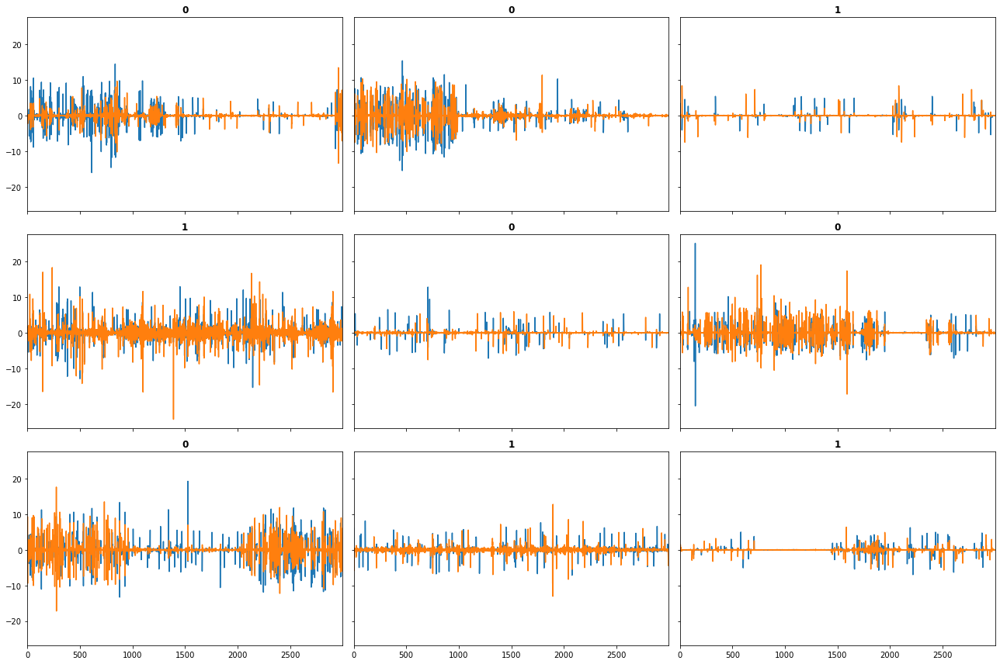

In [24]:
dls.show_batch(sharey=True)

In [25]:
model = InceptionTime(dls.vars, dls.c)
learn = Learner(dls, model, metrics=accuracy)
learn.save('stage0')

Path('models/stage0.pth')

SuggestedLRs(valley=0.009120108559727669)

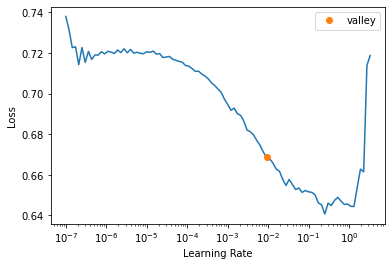

In [26]:
learn.load('stage0')
learn.lr_find()

In [27]:
learn.fit_one_cycle(50, lr_max=1e-3)
learn.save('stage1')

epoch,train_loss,valid_loss,accuracy,time
0,0.723696,0.693055,0.000000,00:00
1,0.721302,0.693022,0.000000,00:00
2,0.709340,0.692788,0.000000,00:00
3,0.704042,0.692103,0.000000,00:00
4,0.699747,0.691114,0.000000,00:00
5,0.693458,0.689126,0.000000,00:00
6,0.686575,0.684687,0.000000,00:00
7,0.679954,0.676200,0.000000,00:00
8,0.673489,0.676312,0.000000,00:00
9,0.670935,0.673336,0.000000,00:00


Path('models/stage1.pth')

In [42]:
learn.recorder.plot_metrics()

not enough values to plot a chart


In [43]:
valid_dl = dls.valid
b = next(iter(valid_dl))
b

(TSTensor(samples:45, vars:2, len:3000, device=mps:0, dtype=torch.float32),
 TensorCategory([0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0,
                 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0,
                 0, 1, 0], device='mps:0'))

In [44]:
valid_probas, valid_targets, valid_preds = learn.get_preds(dl=valid_dl, with_decoded=True)
#valid_probas, valid_targets, valid_preds

In [45]:
(valid_targets == valid_preds).float().mean()

tensor(0.8444)

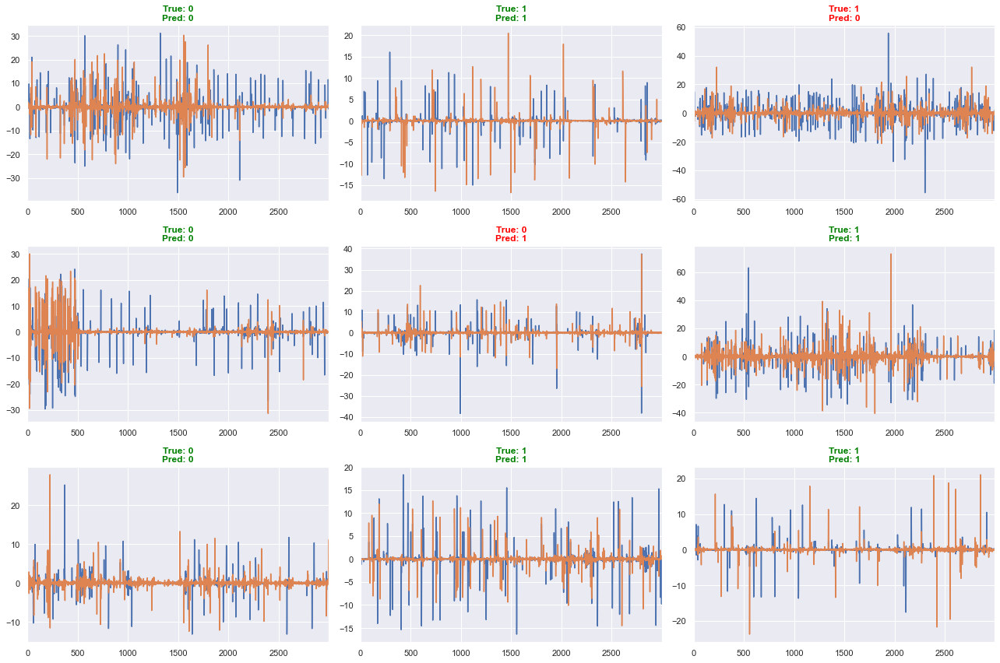

In [47]:
learn.show_results()

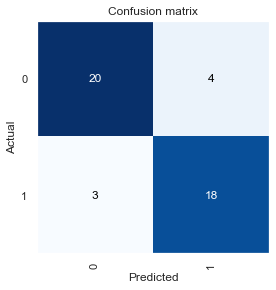

In [48]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

In [49]:
# Import libraries
import tsfel
import glob
import zipfile

import numpy as np
import pandas as pd
import seaborn as sns

from matplotlib import pyplot as plt
from sklearn import preprocessing
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
from sklearn.feature_selection import VarianceThreshold
from sklearn.metrics import confusion_matrix, accuracy_score
sns.set()

In [69]:
np.shape(np.swapaxes(X_train,0,1)[0][::1])

(179, 3000)

In [78]:
xxtrain = np.swapaxes(np.swapaxes(X_train,0,1)[0][::1],0,1)
xxtest = np.swapaxes(np.swapaxes(X_test,0,1)[0][::1],0,1)
yytrain = y_train[::1]
yytest = y_test[::1]

In [79]:
fs = 1000
cfg_file = tsfel.get_features_by_domain()   

In [80]:
#add features one time series 10 at the time to make it faster
X_train_TSF = tsfel.time_series_features_extractor(cfg_file, xxtrain, fs=fs)
X_test_TSF = tsfel.time_series_features_extractor(cfg_file, xxtest, fs=fs)


*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***


In [92]:
for i in X_train_TSF.columns:
    print(i)

0_Absolute energy
0_Area under the curve
0_Autocorrelation
0_Average power
0_Centroid
0_ECDF Percentile Count_0
0_ECDF Percentile Count_1
0_ECDF Percentile_0
0_ECDF Percentile_1
0_ECDF_0
0_ECDF_1
0_ECDF_2
0_ECDF_3
0_ECDF_4
0_ECDF_5
0_ECDF_6
0_ECDF_7
0_ECDF_8
0_ECDF_9
0_Entropy
0_FFT mean coefficient_0
0_FFT mean coefficient_1
0_FFT mean coefficient_10
0_FFT mean coefficient_100
0_FFT mean coefficient_101
0_FFT mean coefficient_102
0_FFT mean coefficient_103
0_FFT mean coefficient_104
0_FFT mean coefficient_105
0_FFT mean coefficient_106
0_FFT mean coefficient_107
0_FFT mean coefficient_108
0_FFT mean coefficient_109
0_FFT mean coefficient_11
0_FFT mean coefficient_110
0_FFT mean coefficient_111
0_FFT mean coefficient_112
0_FFT mean coefficient_113
0_FFT mean coefficient_114
0_FFT mean coefficient_115
0_FFT mean coefficient_116
0_FFT mean coefficient_117
0_FFT mean coefficient_118
0_FFT mean coefficient_119
0_FFT mean coefficient_12
0_FFT mean coefficient_120
0_FFT mean coefficient_121


105_FFT mean coefficient_179
105_FFT mean coefficient_18
105_FFT mean coefficient_180
105_FFT mean coefficient_181
105_FFT mean coefficient_182
105_FFT mean coefficient_183
105_FFT mean coefficient_184
105_FFT mean coefficient_185
105_FFT mean coefficient_186
105_FFT mean coefficient_187
105_FFT mean coefficient_188
105_FFT mean coefficient_189
105_FFT mean coefficient_19
105_FFT mean coefficient_190
105_FFT mean coefficient_191
105_FFT mean coefficient_192
105_FFT mean coefficient_193
105_FFT mean coefficient_194
105_FFT mean coefficient_195
105_FFT mean coefficient_196
105_FFT mean coefficient_197
105_FFT mean coefficient_198
105_FFT mean coefficient_199
105_FFT mean coefficient_2
105_FFT mean coefficient_20
105_FFT mean coefficient_200
105_FFT mean coefficient_201
105_FFT mean coefficient_202
105_FFT mean coefficient_203
105_FFT mean coefficient_204
105_FFT mean coefficient_205
105_FFT mean coefficient_206
105_FFT mean coefficient_207
105_FFT mean coefficient_208
105_FFT mean coeffi

110_FFT mean coefficient_99
110_Fundamental frequency
110_Histogram_0
110_Histogram_1
110_Histogram_2
110_Histogram_3
110_Histogram_4
110_Histogram_5
110_Histogram_6
110_Histogram_7
110_Histogram_8
110_Histogram_9
110_Human range energy
110_Interquartile range
110_Kurtosis
110_LPCC_0
110_LPCC_1
110_LPCC_10
110_LPCC_11
110_LPCC_2
110_LPCC_3
110_LPCC_4
110_LPCC_5
110_LPCC_6
110_LPCC_7
110_LPCC_8
110_LPCC_9
110_MFCC_0
110_MFCC_1
110_MFCC_10
110_MFCC_11
110_MFCC_2
110_MFCC_3
110_MFCC_4
110_MFCC_5
110_MFCC_6
110_MFCC_7
110_MFCC_8
110_MFCC_9
110_Max
110_Max power spectrum
110_Maximum frequency
110_Mean
110_Mean absolute deviation
110_Mean absolute diff
110_Mean diff
110_Median
110_Median absolute deviation
110_Median absolute diff
110_Median diff
110_Median frequency
110_Min
110_Negative turning points
110_Neighbourhood peaks
110_Peak to peak distance
110_Positive turning points
110_Power bandwidth
110_Root mean square
110_Signal distance
110_Skewness
110_Slope
110_Spectral centroid
110_Spec

117_FFT mean coefficient_126
117_FFT mean coefficient_127
117_FFT mean coefficient_128
117_FFT mean coefficient_129
117_FFT mean coefficient_13
117_FFT mean coefficient_130
117_FFT mean coefficient_131
117_FFT mean coefficient_132
117_FFT mean coefficient_133
117_FFT mean coefficient_134
117_FFT mean coefficient_135
117_FFT mean coefficient_136
117_FFT mean coefficient_137
117_FFT mean coefficient_138
117_FFT mean coefficient_139
117_FFT mean coefficient_14
117_FFT mean coefficient_140
117_FFT mean coefficient_141
117_FFT mean coefficient_142
117_FFT mean coefficient_143
117_FFT mean coefficient_144
117_FFT mean coefficient_145
117_FFT mean coefficient_146
117_FFT mean coefficient_147
117_FFT mean coefficient_148
117_FFT mean coefficient_149
117_FFT mean coefficient_15
117_FFT mean coefficient_150
117_FFT mean coefficient_151
117_FFT mean coefficient_152
117_FFT mean coefficient_153
117_FFT mean coefficient_154
117_FFT mean coefficient_155
117_FFT mean coefficient_156
117_FFT mean coef

122_FFT mean coefficient_46
122_FFT mean coefficient_47
122_FFT mean coefficient_48
122_FFT mean coefficient_49
122_FFT mean coefficient_5
122_FFT mean coefficient_50
122_FFT mean coefficient_51
122_FFT mean coefficient_52
122_FFT mean coefficient_53
122_FFT mean coefficient_54
122_FFT mean coefficient_55
122_FFT mean coefficient_56
122_FFT mean coefficient_57
122_FFT mean coefficient_58
122_FFT mean coefficient_59
122_FFT mean coefficient_6
122_FFT mean coefficient_60
122_FFT mean coefficient_61
122_FFT mean coefficient_62
122_FFT mean coefficient_63
122_FFT mean coefficient_64
122_FFT mean coefficient_65
122_FFT mean coefficient_66
122_FFT mean coefficient_67
122_FFT mean coefficient_68
122_FFT mean coefficient_69
122_FFT mean coefficient_7
122_FFT mean coefficient_70
122_FFT mean coefficient_71
122_FFT mean coefficient_72
122_FFT mean coefficient_73
122_FFT mean coefficient_74
122_FFT mean coefficient_75
122_FFT mean coefficient_76
122_FFT mean coefficient_77
122_FFT mean coefficien

128_Wavelet variance_3
128_Wavelet variance_4
128_Wavelet variance_5
128_Wavelet variance_6
128_Wavelet variance_7
128_Wavelet variance_8
128_Zero crossing rate
129_Absolute energy
129_Area under the curve
129_Autocorrelation
129_Average power
129_Centroid
129_ECDF Percentile Count_0
129_ECDF Percentile Count_1
129_ECDF Percentile_0
129_ECDF Percentile_1
129_ECDF_0
129_ECDF_1
129_ECDF_2
129_ECDF_3
129_ECDF_4
129_ECDF_5
129_ECDF_6
129_ECDF_7
129_ECDF_8
129_ECDF_9
129_Entropy
129_FFT mean coefficient_0
129_FFT mean coefficient_1
129_FFT mean coefficient_10
129_FFT mean coefficient_100
129_FFT mean coefficient_101
129_FFT mean coefficient_102
129_FFT mean coefficient_103
129_FFT mean coefficient_104
129_FFT mean coefficient_105
129_FFT mean coefficient_106
129_FFT mean coefficient_107
129_FFT mean coefficient_108
129_FFT mean coefficient_109
129_FFT mean coefficient_11
129_FFT mean coefficient_110
129_FFT mean coefficient_111
129_FFT mean coefficient_112
129_FFT mean coefficient_113
129_F

134_FFT mean coefficient_223
134_FFT mean coefficient_224
134_FFT mean coefficient_225
134_FFT mean coefficient_226
134_FFT mean coefficient_227
134_FFT mean coefficient_228
134_FFT mean coefficient_229
134_FFT mean coefficient_23
134_FFT mean coefficient_230
134_FFT mean coefficient_231
134_FFT mean coefficient_232
134_FFT mean coefficient_233
134_FFT mean coefficient_234
134_FFT mean coefficient_235
134_FFT mean coefficient_236
134_FFT mean coefficient_237
134_FFT mean coefficient_238
134_FFT mean coefficient_239
134_FFT mean coefficient_24
134_FFT mean coefficient_240
134_FFT mean coefficient_241
134_FFT mean coefficient_242
134_FFT mean coefficient_243
134_FFT mean coefficient_244
134_FFT mean coefficient_245
134_FFT mean coefficient_246
134_FFT mean coefficient_247
134_FFT mean coefficient_248
134_FFT mean coefficient_249
134_FFT mean coefficient_25
134_FFT mean coefficient_250
134_FFT mean coefficient_251
134_FFT mean coefficient_252
134_FFT mean coefficient_253
134_FFT mean coef

13_Median diff
13_Median frequency
13_Min
13_Negative turning points
13_Neighbourhood peaks
13_Peak to peak distance
13_Positive turning points
13_Power bandwidth
13_Root mean square
13_Signal distance
13_Skewness
13_Slope
13_Spectral centroid
13_Spectral decrease
13_Spectral distance
13_Spectral entropy
13_Spectral kurtosis
13_Spectral positive turning points
13_Spectral roll-off
13_Spectral roll-on
13_Spectral skewness
13_Spectral slope
13_Spectral spread
13_Spectral variation
13_Standard deviation
13_Sum absolute diff
13_Variance
13_Wavelet absolute mean_0
13_Wavelet absolute mean_1
13_Wavelet absolute mean_2
13_Wavelet absolute mean_3
13_Wavelet absolute mean_4
13_Wavelet absolute mean_5
13_Wavelet absolute mean_6
13_Wavelet absolute mean_7
13_Wavelet absolute mean_8
13_Wavelet energy_0
13_Wavelet energy_1
13_Wavelet energy_2
13_Wavelet energy_3
13_Wavelet energy_4
13_Wavelet energy_5
13_Wavelet energy_6
13_Wavelet energy_7
13_Wavelet energy_8
13_Wavelet entropy
13_Wavelet standard

147_FFT mean coefficient_102
147_FFT mean coefficient_103
147_FFT mean coefficient_104
147_FFT mean coefficient_105
147_FFT mean coefficient_106
147_FFT mean coefficient_107
147_FFT mean coefficient_108
147_FFT mean coefficient_109
147_FFT mean coefficient_11
147_FFT mean coefficient_110
147_FFT mean coefficient_111
147_FFT mean coefficient_112
147_FFT mean coefficient_113
147_FFT mean coefficient_114
147_FFT mean coefficient_115
147_FFT mean coefficient_116
147_FFT mean coefficient_117
147_FFT mean coefficient_118
147_FFT mean coefficient_119
147_FFT mean coefficient_12
147_FFT mean coefficient_120
147_FFT mean coefficient_121
147_FFT mean coefficient_122
147_FFT mean coefficient_123
147_FFT mean coefficient_124
147_FFT mean coefficient_125
147_FFT mean coefficient_126
147_FFT mean coefficient_127
147_FFT mean coefficient_128
147_FFT mean coefficient_129
147_FFT mean coefficient_13
147_FFT mean coefficient_130
147_FFT mean coefficient_131
147_FFT mean coefficient_132
147_FFT mean coef

152_Wavelet standard deviation_7
152_Wavelet standard deviation_8
152_Wavelet variance_0
152_Wavelet variance_1
152_Wavelet variance_2
152_Wavelet variance_3
152_Wavelet variance_4
152_Wavelet variance_5
152_Wavelet variance_6
152_Wavelet variance_7
152_Wavelet variance_8
152_Zero crossing rate
153_Absolute energy
153_Area under the curve
153_Autocorrelation
153_Average power
153_Centroid
153_ECDF Percentile Count_0
153_ECDF Percentile Count_1
153_ECDF Percentile_0
153_ECDF Percentile_1
153_ECDF_0
153_ECDF_1
153_ECDF_2
153_ECDF_3
153_ECDF_4
153_ECDF_5
153_ECDF_6
153_ECDF_7
153_ECDF_8
153_ECDF_9
153_Entropy
153_FFT mean coefficient_0
153_FFT mean coefficient_1
153_FFT mean coefficient_10
153_FFT mean coefficient_100
153_FFT mean coefficient_101
153_FFT mean coefficient_102
153_FFT mean coefficient_103
153_FFT mean coefficient_104
153_FFT mean coefficient_105
153_FFT mean coefficient_106
153_FFT mean coefficient_107
153_FFT mean coefficient_108
153_FFT mean coefficient_109
153_FFT mean c

15_FFT mean coefficient_251
15_FFT mean coefficient_252
15_FFT mean coefficient_253
15_FFT mean coefficient_254
15_FFT mean coefficient_255
15_FFT mean coefficient_26
15_FFT mean coefficient_27
15_FFT mean coefficient_28
15_FFT mean coefficient_29
15_FFT mean coefficient_3
15_FFT mean coefficient_30
15_FFT mean coefficient_31
15_FFT mean coefficient_32
15_FFT mean coefficient_33
15_FFT mean coefficient_34
15_FFT mean coefficient_35
15_FFT mean coefficient_36
15_FFT mean coefficient_37
15_FFT mean coefficient_38
15_FFT mean coefficient_39
15_FFT mean coefficient_4
15_FFT mean coefficient_40
15_FFT mean coefficient_41
15_FFT mean coefficient_42
15_FFT mean coefficient_43
15_FFT mean coefficient_44
15_FFT mean coefficient_45
15_FFT mean coefficient_46
15_FFT mean coefficient_47
15_FFT mean coefficient_48
15_FFT mean coefficient_49
15_FFT mean coefficient_5
15_FFT mean coefficient_50
15_FFT mean coefficient_51
15_FFT mean coefficient_52
15_FFT mean coefficient_53
15_FFT mean coefficient_54

165_FFT mean coefficient_231
165_FFT mean coefficient_232
165_FFT mean coefficient_233
165_FFT mean coefficient_234
165_FFT mean coefficient_235
165_FFT mean coefficient_236
165_FFT mean coefficient_237
165_FFT mean coefficient_238
165_FFT mean coefficient_239
165_FFT mean coefficient_24
165_FFT mean coefficient_240
165_FFT mean coefficient_241
165_FFT mean coefficient_242
165_FFT mean coefficient_243
165_FFT mean coefficient_244
165_FFT mean coefficient_245
165_FFT mean coefficient_246
165_FFT mean coefficient_247
165_FFT mean coefficient_248
165_FFT mean coefficient_249
165_FFT mean coefficient_25
165_FFT mean coefficient_250
165_FFT mean coefficient_251
165_FFT mean coefficient_252
165_FFT mean coefficient_253
165_FFT mean coefficient_254
165_FFT mean coefficient_255
165_FFT mean coefficient_26
165_FFT mean coefficient_27
165_FFT mean coefficient_28
165_FFT mean coefficient_29
165_FFT mean coefficient_3
165_FFT mean coefficient_30
165_FFT mean coefficient_31
165_FFT mean coefficient

171_FFT mean coefficient_37
171_FFT mean coefficient_38
171_FFT mean coefficient_39
171_FFT mean coefficient_4
171_FFT mean coefficient_40
171_FFT mean coefficient_41
171_FFT mean coefficient_42
171_FFT mean coefficient_43
171_FFT mean coefficient_44
171_FFT mean coefficient_45
171_FFT mean coefficient_46
171_FFT mean coefficient_47
171_FFT mean coefficient_48
171_FFT mean coefficient_49
171_FFT mean coefficient_5
171_FFT mean coefficient_50
171_FFT mean coefficient_51
171_FFT mean coefficient_52
171_FFT mean coefficient_53
171_FFT mean coefficient_54
171_FFT mean coefficient_55
171_FFT mean coefficient_56
171_FFT mean coefficient_57
171_FFT mean coefficient_58
171_FFT mean coefficient_59
171_FFT mean coefficient_6
171_FFT mean coefficient_60
171_FFT mean coefficient_61
171_FFT mean coefficient_62
171_FFT mean coefficient_63
171_FFT mean coefficient_64
171_FFT mean coefficient_65
171_FFT mean coefficient_66
171_FFT mean coefficient_67
171_FFT mean coefficient_68
171_FFT mean coefficien

17_FFT mean coefficient_165
17_FFT mean coefficient_166
17_FFT mean coefficient_167
17_FFT mean coefficient_168
17_FFT mean coefficient_169
17_FFT mean coefficient_17
17_FFT mean coefficient_170
17_FFT mean coefficient_171
17_FFT mean coefficient_172
17_FFT mean coefficient_173
17_FFT mean coefficient_174
17_FFT mean coefficient_175
17_FFT mean coefficient_176
17_FFT mean coefficient_177
17_FFT mean coefficient_178
17_FFT mean coefficient_179
17_FFT mean coefficient_18
17_FFT mean coefficient_180
17_FFT mean coefficient_181
17_FFT mean coefficient_182
17_FFT mean coefficient_183
17_FFT mean coefficient_184
17_FFT mean coefficient_185
17_FFT mean coefficient_186
17_FFT mean coefficient_187
17_FFT mean coefficient_188
17_FFT mean coefficient_189
17_FFT mean coefficient_19
17_FFT mean coefficient_190
17_FFT mean coefficient_191
17_FFT mean coefficient_192
17_FFT mean coefficient_193
17_FFT mean coefficient_194
17_FFT mean coefficient_195
17_FFT mean coefficient_196
17_FFT mean coefficient

23_Wavelet standard deviation_1
23_Wavelet standard deviation_2
23_Wavelet standard deviation_3
23_Wavelet standard deviation_4
23_Wavelet standard deviation_5
23_Wavelet standard deviation_6
23_Wavelet standard deviation_7
23_Wavelet standard deviation_8
23_Wavelet variance_0
23_Wavelet variance_1
23_Wavelet variance_2
23_Wavelet variance_3
23_Wavelet variance_4
23_Wavelet variance_5
23_Wavelet variance_6
23_Wavelet variance_7
23_Wavelet variance_8
23_Zero crossing rate
24_Absolute energy
24_Area under the curve
24_Autocorrelation
24_Average power
24_Centroid
24_ECDF Percentile Count_0
24_ECDF Percentile Count_1
24_ECDF Percentile_0
24_ECDF Percentile_1
24_ECDF_0
24_ECDF_1
24_ECDF_2
24_ECDF_3
24_ECDF_4
24_ECDF_5
24_ECDF_6
24_ECDF_7
24_ECDF_8
24_ECDF_9
24_Entropy
24_FFT mean coefficient_0
24_FFT mean coefficient_1
24_FFT mean coefficient_10
24_FFT mean coefficient_100
24_FFT mean coefficient_101
24_FFT mean coefficient_102
24_FFT mean coefficient_103
24_FFT mean coefficient_104
24_FFT 

30_FFT mean coefficient_83
30_FFT mean coefficient_84
30_FFT mean coefficient_85
30_FFT mean coefficient_86
30_FFT mean coefficient_87
30_FFT mean coefficient_88
30_FFT mean coefficient_89
30_FFT mean coefficient_9
30_FFT mean coefficient_90
30_FFT mean coefficient_91
30_FFT mean coefficient_92
30_FFT mean coefficient_93
30_FFT mean coefficient_94
30_FFT mean coefficient_95
30_FFT mean coefficient_96
30_FFT mean coefficient_97
30_FFT mean coefficient_98
30_FFT mean coefficient_99
30_Fundamental frequency
30_Histogram_0
30_Histogram_1
30_Histogram_2
30_Histogram_3
30_Histogram_4
30_Histogram_5
30_Histogram_6
30_Histogram_7
30_Histogram_8
30_Histogram_9
30_Human range energy
30_Interquartile range
30_Kurtosis
30_LPCC_0
30_LPCC_1
30_LPCC_10
30_LPCC_11
30_LPCC_2
30_LPCC_3
30_LPCC_4
30_LPCC_5
30_LPCC_6
30_LPCC_7
30_LPCC_8
30_LPCC_9
30_MFCC_0
30_MFCC_1
30_MFCC_10
30_MFCC_11
30_MFCC_2
30_MFCC_3
30_MFCC_4
30_MFCC_5
30_MFCC_6
30_MFCC_7
30_MFCC_8
30_MFCC_9
30_Max
30_Max power spectrum
30_Maximum

38_FFT mean coefficient_211
38_FFT mean coefficient_212
38_FFT mean coefficient_213
38_FFT mean coefficient_214
38_FFT mean coefficient_215
38_FFT mean coefficient_216
38_FFT mean coefficient_217
38_FFT mean coefficient_218
38_FFT mean coefficient_219
38_FFT mean coefficient_22
38_FFT mean coefficient_220
38_FFT mean coefficient_221
38_FFT mean coefficient_222
38_FFT mean coefficient_223
38_FFT mean coefficient_224
38_FFT mean coefficient_225
38_FFT mean coefficient_226
38_FFT mean coefficient_227
38_FFT mean coefficient_228
38_FFT mean coefficient_229
38_FFT mean coefficient_23
38_FFT mean coefficient_230
38_FFT mean coefficient_231
38_FFT mean coefficient_232
38_FFT mean coefficient_233
38_FFT mean coefficient_234
38_FFT mean coefficient_235
38_FFT mean coefficient_236
38_FFT mean coefficient_237
38_FFT mean coefficient_238
38_FFT mean coefficient_239
38_FFT mean coefficient_24
38_FFT mean coefficient_240
38_FFT mean coefficient_241
38_FFT mean coefficient_242
38_FFT mean coefficient

45_FFT mean coefficient_11
45_FFT mean coefficient_110
45_FFT mean coefficient_111
45_FFT mean coefficient_112
45_FFT mean coefficient_113
45_FFT mean coefficient_114
45_FFT mean coefficient_115
45_FFT mean coefficient_116
45_FFT mean coefficient_117
45_FFT mean coefficient_118
45_FFT mean coefficient_119
45_FFT mean coefficient_12
45_FFT mean coefficient_120
45_FFT mean coefficient_121
45_FFT mean coefficient_122
45_FFT mean coefficient_123
45_FFT mean coefficient_124
45_FFT mean coefficient_125
45_FFT mean coefficient_126
45_FFT mean coefficient_127
45_FFT mean coefficient_128
45_FFT mean coefficient_129
45_FFT mean coefficient_13
45_FFT mean coefficient_130
45_FFT mean coefficient_131
45_FFT mean coefficient_132
45_FFT mean coefficient_133
45_FFT mean coefficient_134
45_FFT mean coefficient_135
45_FFT mean coefficient_136
45_FFT mean coefficient_137
45_FFT mean coefficient_138
45_FFT mean coefficient_139
45_FFT mean coefficient_14
45_FFT mean coefficient_140
45_FFT mean coefficient_

51_MFCC_6
51_MFCC_7
51_MFCC_8
51_MFCC_9
51_Max
51_Max power spectrum
51_Maximum frequency
51_Mean
51_Mean absolute deviation
51_Mean absolute diff
51_Mean diff
51_Median
51_Median absolute deviation
51_Median absolute diff
51_Median diff
51_Median frequency
51_Min
51_Negative turning points
51_Neighbourhood peaks
51_Peak to peak distance
51_Positive turning points
51_Power bandwidth
51_Root mean square
51_Signal distance
51_Skewness
51_Slope
51_Spectral centroid
51_Spectral decrease
51_Spectral distance
51_Spectral entropy
51_Spectral kurtosis
51_Spectral positive turning points
51_Spectral roll-off
51_Spectral roll-on
51_Spectral skewness
51_Spectral slope
51_Spectral spread
51_Spectral variation
51_Standard deviation
51_Sum absolute diff
51_Variance
51_Wavelet absolute mean_0
51_Wavelet absolute mean_1
51_Wavelet absolute mean_2
51_Wavelet absolute mean_3
51_Wavelet absolute mean_4
51_Wavelet absolute mean_5
51_Wavelet absolute mean_6
51_Wavelet absolute mean_7
51_Wavelet absolute me

59_FFT mean coefficient_28
59_FFT mean coefficient_29
59_FFT mean coefficient_3
59_FFT mean coefficient_30
59_FFT mean coefficient_31
59_FFT mean coefficient_32
59_FFT mean coefficient_33
59_FFT mean coefficient_34
59_FFT mean coefficient_35
59_FFT mean coefficient_36
59_FFT mean coefficient_37
59_FFT mean coefficient_38
59_FFT mean coefficient_39
59_FFT mean coefficient_4
59_FFT mean coefficient_40
59_FFT mean coefficient_41
59_FFT mean coefficient_42
59_FFT mean coefficient_43
59_FFT mean coefficient_44
59_FFT mean coefficient_45
59_FFT mean coefficient_46
59_FFT mean coefficient_47
59_FFT mean coefficient_48
59_FFT mean coefficient_49
59_FFT mean coefficient_5
59_FFT mean coefficient_50
59_FFT mean coefficient_51
59_FFT mean coefficient_52
59_FFT mean coefficient_53
59_FFT mean coefficient_54
59_FFT mean coefficient_55
59_FFT mean coefficient_56
59_FFT mean coefficient_57
59_FFT mean coefficient_58
59_FFT mean coefficient_59
59_FFT mean coefficient_6
59_FFT mean coefficient_60
59_FF

66_FFT mean coefficient_157
66_FFT mean coefficient_158
66_FFT mean coefficient_159
66_FFT mean coefficient_16
66_FFT mean coefficient_160
66_FFT mean coefficient_161
66_FFT mean coefficient_162
66_FFT mean coefficient_163
66_FFT mean coefficient_164
66_FFT mean coefficient_165
66_FFT mean coefficient_166
66_FFT mean coefficient_167
66_FFT mean coefficient_168
66_FFT mean coefficient_169
66_FFT mean coefficient_17
66_FFT mean coefficient_170
66_FFT mean coefficient_171
66_FFT mean coefficient_172
66_FFT mean coefficient_173
66_FFT mean coefficient_174
66_FFT mean coefficient_175
66_FFT mean coefficient_176
66_FFT mean coefficient_177
66_FFT mean coefficient_178
66_FFT mean coefficient_179
66_FFT mean coefficient_18
66_FFT mean coefficient_180
66_FFT mean coefficient_181
66_FFT mean coefficient_182
66_FFT mean coefficient_183
66_FFT mean coefficient_184
66_FFT mean coefficient_185
66_FFT mean coefficient_186
66_FFT mean coefficient_187
66_FFT mean coefficient_188
66_FFT mean coefficient

70_FFT mean coefficient_120
70_FFT mean coefficient_121
70_FFT mean coefficient_122
70_FFT mean coefficient_123
70_FFT mean coefficient_124
70_FFT mean coefficient_125
70_FFT mean coefficient_126
70_FFT mean coefficient_127
70_FFT mean coefficient_128
70_FFT mean coefficient_129
70_FFT mean coefficient_13
70_FFT mean coefficient_130
70_FFT mean coefficient_131
70_FFT mean coefficient_132
70_FFT mean coefficient_133
70_FFT mean coefficient_134
70_FFT mean coefficient_135
70_FFT mean coefficient_136
70_FFT mean coefficient_137
70_FFT mean coefficient_138
70_FFT mean coefficient_139
70_FFT mean coefficient_14
70_FFT mean coefficient_140
70_FFT mean coefficient_141
70_FFT mean coefficient_142
70_FFT mean coefficient_143
70_FFT mean coefficient_144
70_FFT mean coefficient_145
70_FFT mean coefficient_146
70_FFT mean coefficient_147
70_FFT mean coefficient_148
70_FFT mean coefficient_149
70_FFT mean coefficient_15
70_FFT mean coefficient_150
70_FFT mean coefficient_151
70_FFT mean coefficient

76_MFCC_11
76_MFCC_2
76_MFCC_3
76_MFCC_4
76_MFCC_5
76_MFCC_6
76_MFCC_7
76_MFCC_8
76_MFCC_9
76_Max
76_Max power spectrum
76_Maximum frequency
76_Mean
76_Mean absolute deviation
76_Mean absolute diff
76_Mean diff
76_Median
76_Median absolute deviation
76_Median absolute diff
76_Median diff
76_Median frequency
76_Min
76_Negative turning points
76_Neighbourhood peaks
76_Peak to peak distance
76_Positive turning points
76_Power bandwidth
76_Root mean square
76_Signal distance
76_Skewness
76_Slope
76_Spectral centroid
76_Spectral decrease
76_Spectral distance
76_Spectral entropy
76_Spectral kurtosis
76_Spectral positive turning points
76_Spectral roll-off
76_Spectral roll-on
76_Spectral skewness
76_Spectral slope
76_Spectral spread
76_Spectral variation
76_Standard deviation
76_Sum absolute diff
76_Variance
76_Wavelet absolute mean_0
76_Wavelet absolute mean_1
76_Wavelet absolute mean_2
76_Wavelet absolute mean_3
76_Wavelet absolute mean_4
76_Wavelet absolute mean_5
76_Wavelet absolute mean_

82_Wavelet energy_6
82_Wavelet energy_7
82_Wavelet energy_8
82_Wavelet entropy
82_Wavelet standard deviation_0
82_Wavelet standard deviation_1
82_Wavelet standard deviation_2
82_Wavelet standard deviation_3
82_Wavelet standard deviation_4
82_Wavelet standard deviation_5
82_Wavelet standard deviation_6
82_Wavelet standard deviation_7
82_Wavelet standard deviation_8
82_Wavelet variance_0
82_Wavelet variance_1
82_Wavelet variance_2
82_Wavelet variance_3
82_Wavelet variance_4
82_Wavelet variance_5
82_Wavelet variance_6
82_Wavelet variance_7
82_Wavelet variance_8
82_Zero crossing rate
83_Absolute energy
83_Area under the curve
83_Autocorrelation
83_Average power
83_Centroid
83_ECDF Percentile Count_0
83_ECDF Percentile Count_1
83_ECDF Percentile_0
83_ECDF Percentile_1
83_ECDF_0
83_ECDF_1
83_ECDF_2
83_ECDF_3
83_ECDF_4
83_ECDF_5
83_ECDF_6
83_ECDF_7
83_ECDF_8
83_ECDF_9
83_Entropy
83_FFT mean coefficient_0
83_FFT mean coefficient_1
83_FFT mean coefficient_10
83_FFT mean coefficient_100
83_FFT m

89_Wavelet absolute mean_7
89_Wavelet absolute mean_8
89_Wavelet energy_0
89_Wavelet energy_1
89_Wavelet energy_2
89_Wavelet energy_3
89_Wavelet energy_4
89_Wavelet energy_5
89_Wavelet energy_6
89_Wavelet energy_7
89_Wavelet energy_8
89_Wavelet entropy
89_Wavelet standard deviation_0
89_Wavelet standard deviation_1
89_Wavelet standard deviation_2
89_Wavelet standard deviation_3
89_Wavelet standard deviation_4
89_Wavelet standard deviation_5
89_Wavelet standard deviation_6
89_Wavelet standard deviation_7
89_Wavelet standard deviation_8
89_Wavelet variance_0
89_Wavelet variance_1
89_Wavelet variance_2
89_Wavelet variance_3
89_Wavelet variance_4
89_Wavelet variance_5
89_Wavelet variance_6
89_Wavelet variance_7
89_Wavelet variance_8
89_Zero crossing rate
8_Absolute energy
8_Area under the curve
8_Autocorrelation
8_Average power
8_Centroid
8_ECDF Percentile Count_0
8_ECDF Percentile Count_1
8_ECDF Percentile_0
8_ECDF Percentile_1
8_ECDF_0
8_ECDF_1
8_ECDF_2
8_ECDF_3
8_ECDF_4
8_ECDF_5
8_ECDF_

95_FFT mean coefficient_200
95_FFT mean coefficient_201
95_FFT mean coefficient_202
95_FFT mean coefficient_203
95_FFT mean coefficient_204
95_FFT mean coefficient_205
95_FFT mean coefficient_206
95_FFT mean coefficient_207
95_FFT mean coefficient_208
95_FFT mean coefficient_209
95_FFT mean coefficient_21
95_FFT mean coefficient_210
95_FFT mean coefficient_211
95_FFT mean coefficient_212
95_FFT mean coefficient_213
95_FFT mean coefficient_214
95_FFT mean coefficient_215
95_FFT mean coefficient_216
95_FFT mean coefficient_217
95_FFT mean coefficient_218
95_FFT mean coefficient_219
95_FFT mean coefficient_22
95_FFT mean coefficient_220
95_FFT mean coefficient_221
95_FFT mean coefficient_222
95_FFT mean coefficient_223
95_FFT mean coefficient_224
95_FFT mean coefficient_225
95_FFT mean coefficient_226
95_FFT mean coefficient_227
95_FFT mean coefficient_228
95_FFT mean coefficient_229
95_FFT mean coefficient_23
95_FFT mean coefficient_230
95_FFT mean coefficient_231
95_FFT mean coefficient

In [81]:
np.shape(X_train_TSF)

(1, 69631)

In [82]:
69631 / 179

389.0

In [83]:
N_features = np.shape(X_train_TSF)[1] / np.shape(xxtrain)[1]
if N_features - int(N_features) >0:
    print("error number of features is not integer")
N_features = int(N_features)

In [117]:
results = []
Logistic_accuracy = []
for i in range(N_features):
    lr_XX_train = np.array(X_train_TSF)[0][i::int(N_features)]
    lr_XX_test = np.array(X_test_TSF)[0][i::int(N_features)]
    
    log_reg = LogisticRegression(penalty='none', random_state=0)
    clf = log_reg.fit(lr_XX_train.reshape(-1, 1), yytrain)
    Logistic_accuracy.append(1 - np.sum(np.abs(clf.predict(np.array(lr_XX_train).reshape(-1, 1)) - np.array(yytrain)))/len(yytrain))
    

In [88]:
N_features = np.shape(X_train_TSF)[1] / np.shape(xxtrain)[1]
if N_features - int(N_features) >0:
    print("error number of features is not integer")
N_features = int(N_features)

In [96]:
np.argmax(Logistic_accuracy)

296

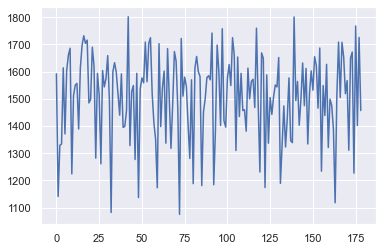

In [97]:
plt.plot(lr_XX_train)

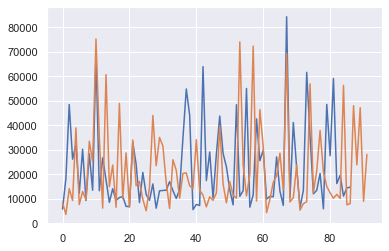

0


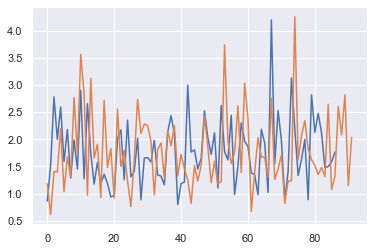

1


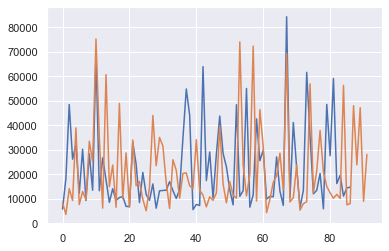

2


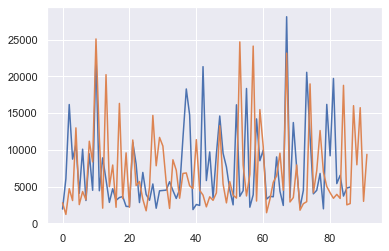

3


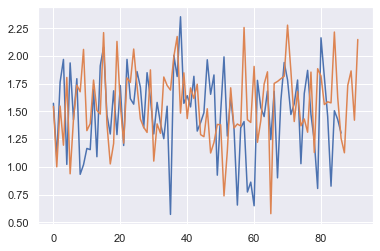

4


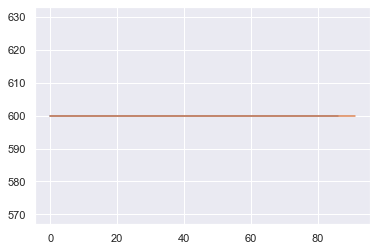

5


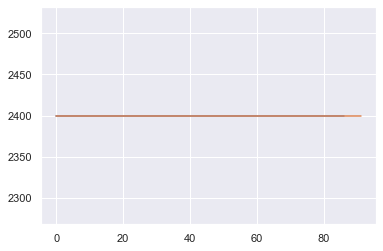

6


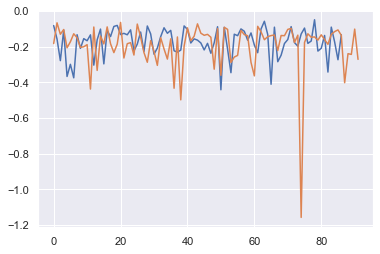

7


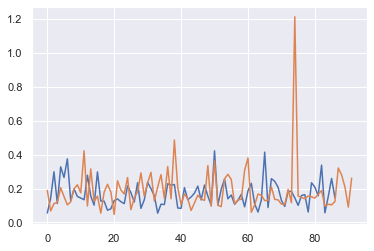

8


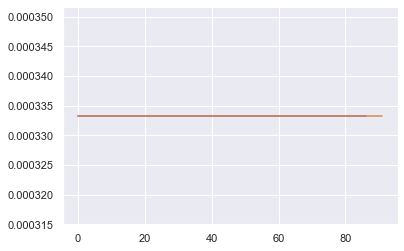

9


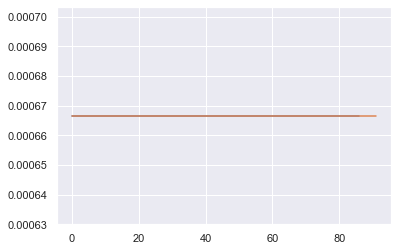

10


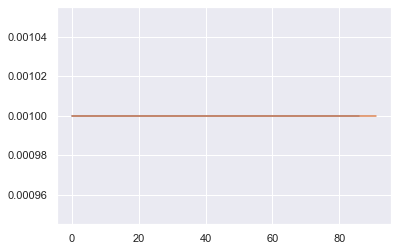

11


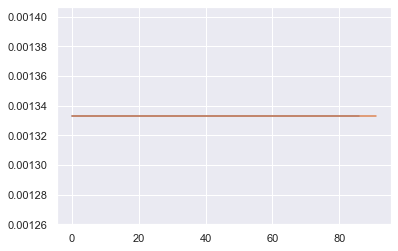

12


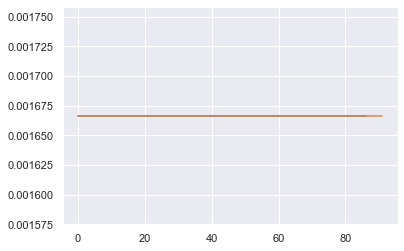

13


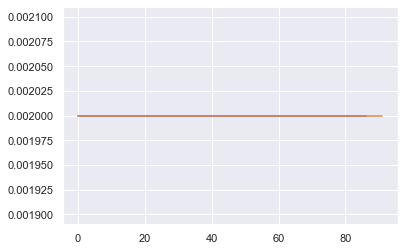

14


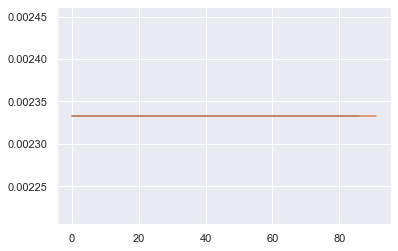

15


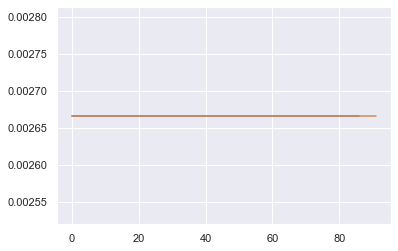

16


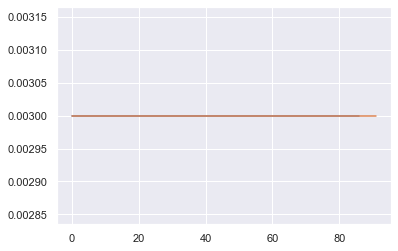

17


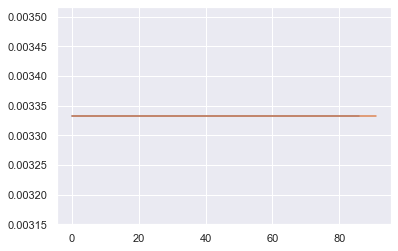

18


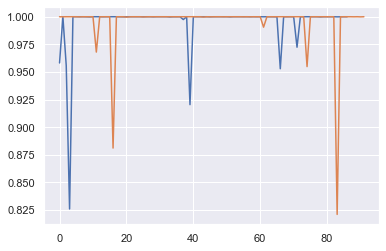

19


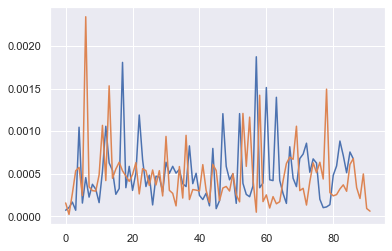

20


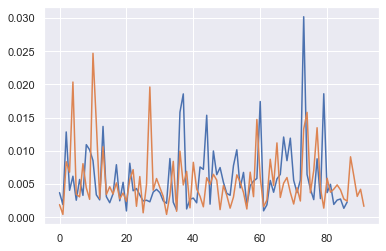

21


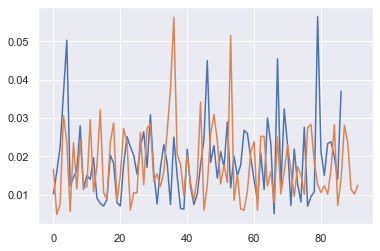

22


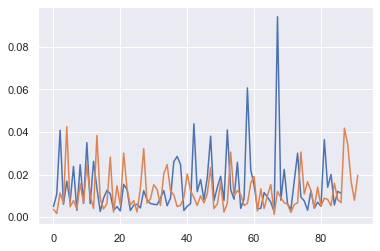

23


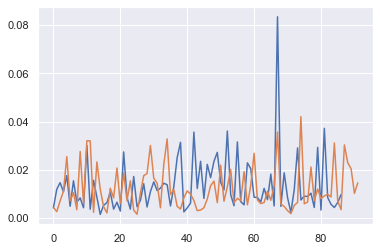

24


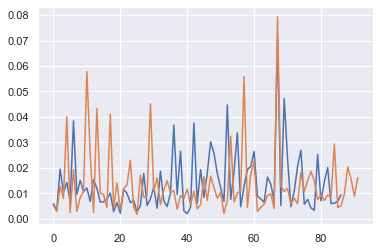

25


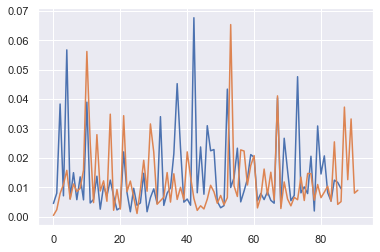

26


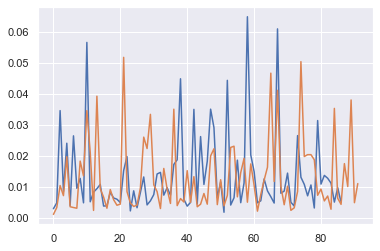

27


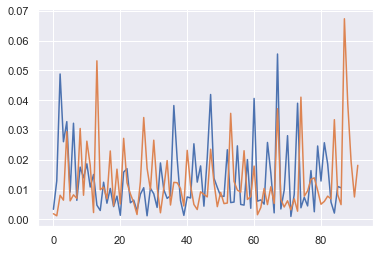

28


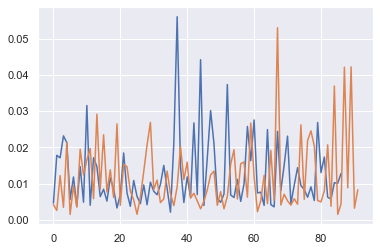

29


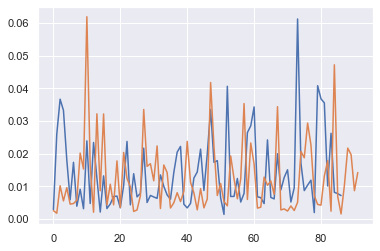

30


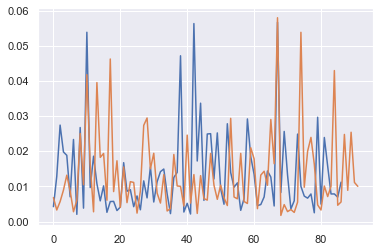

31


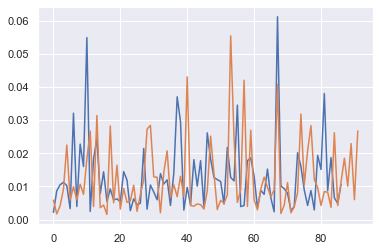

32


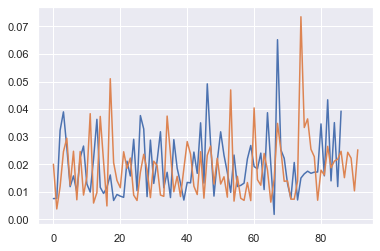

33


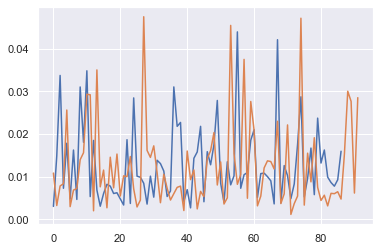

34


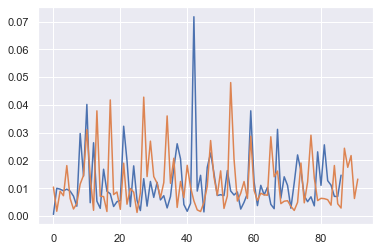

35


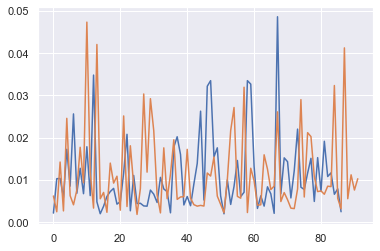

36


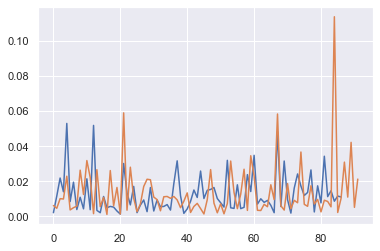

37


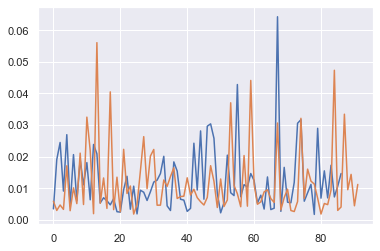

38


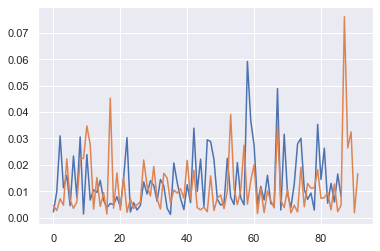

39


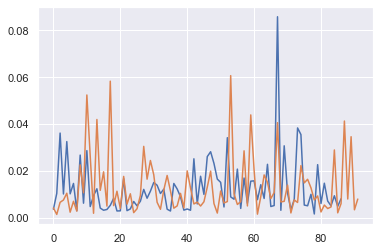

40


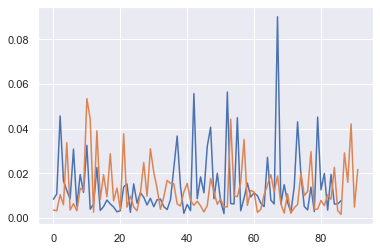

41


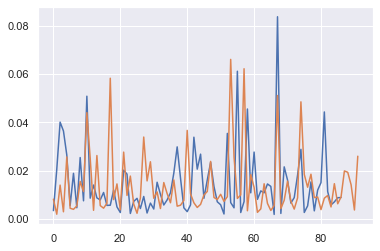

42


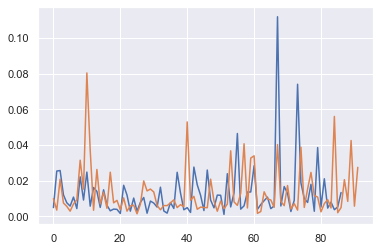

43


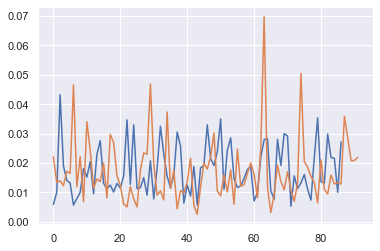

44


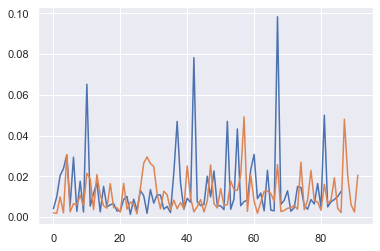

45


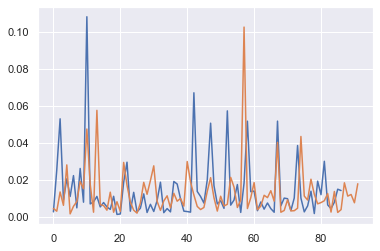

46


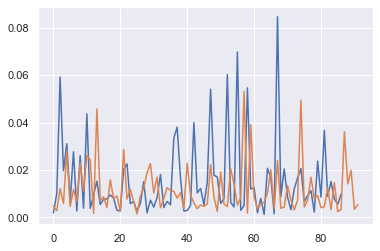

47


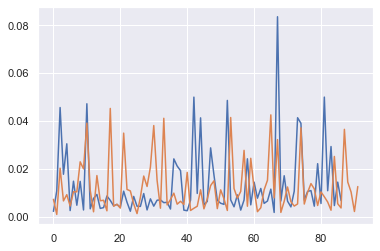

48


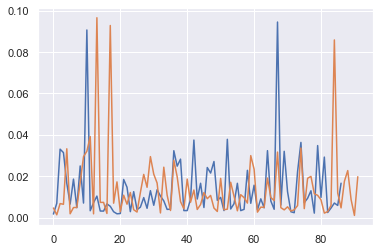

49


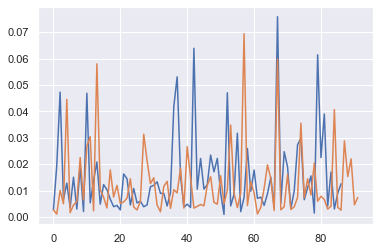

50


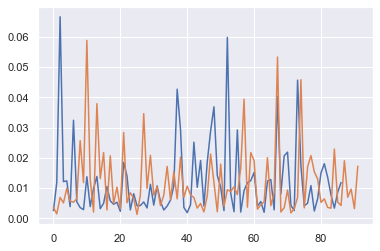

51


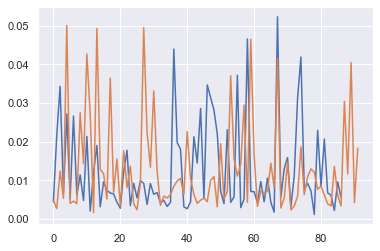

52


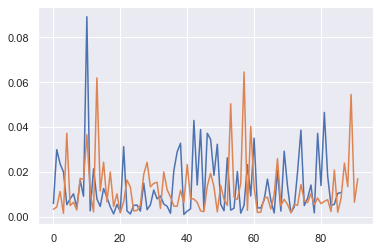

53


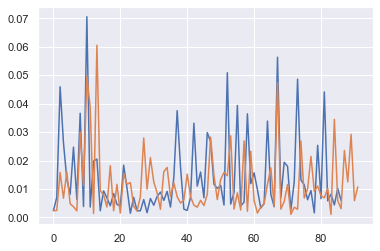

54


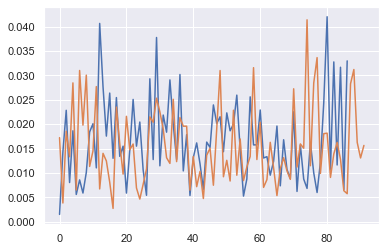

55


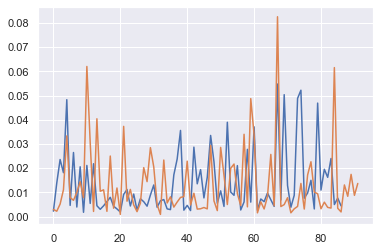

56


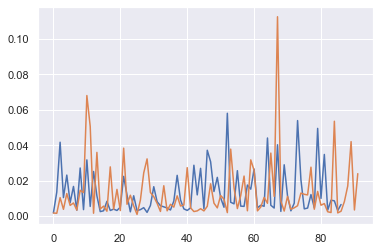

57


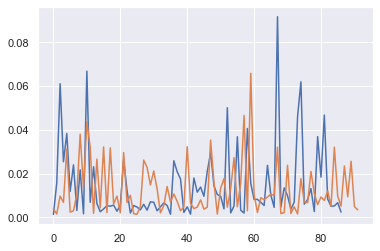

58


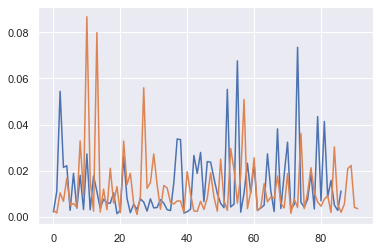

59


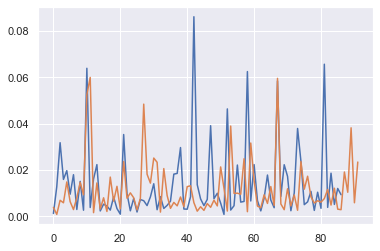

60


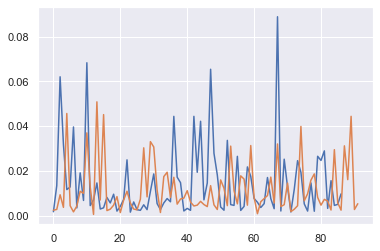

61


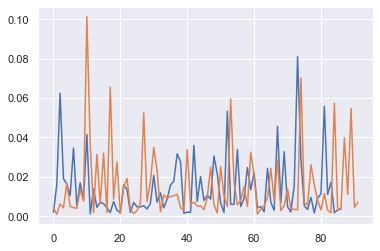

62


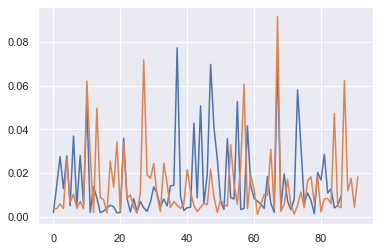

63


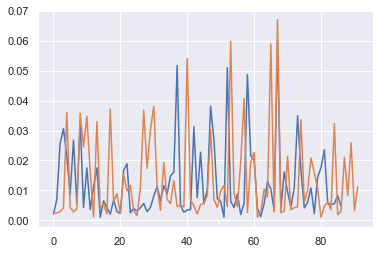

64


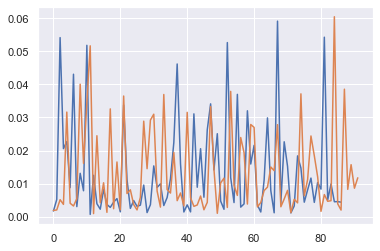

65


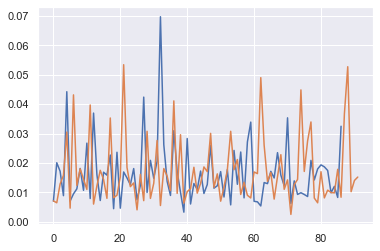

66


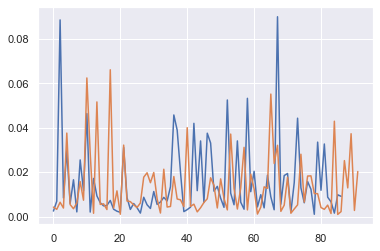

67


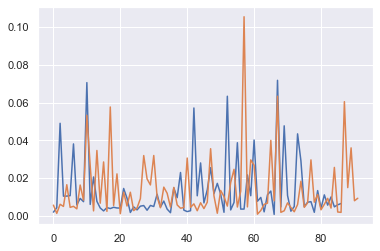

68


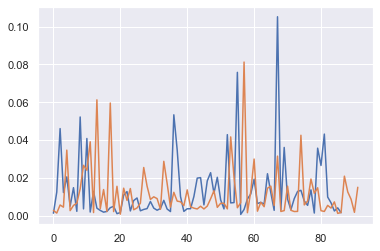

69


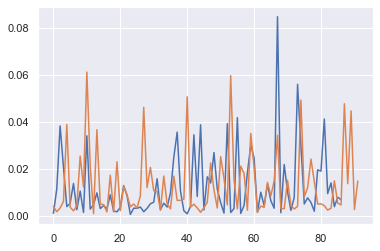

70


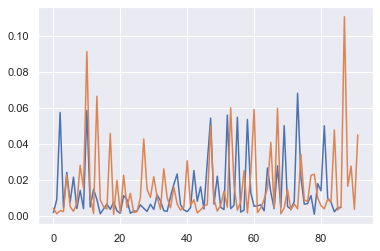

71


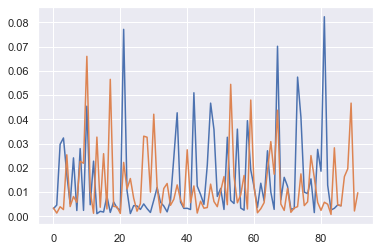

72


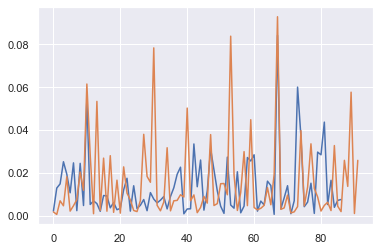

73


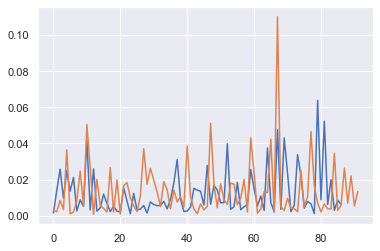

74


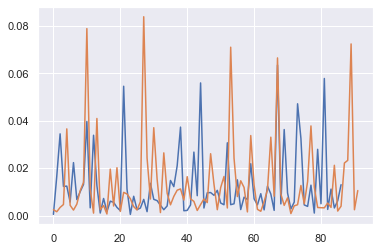

75


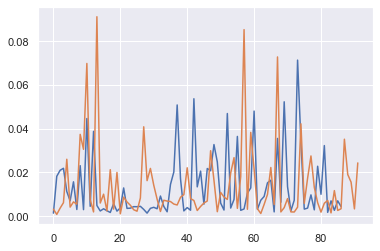

76


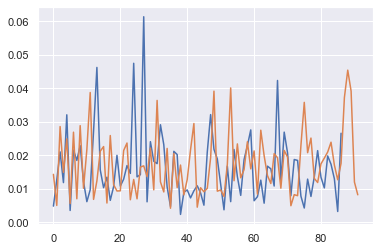

77


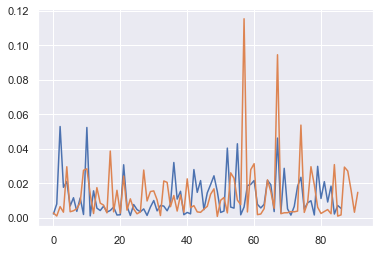

78


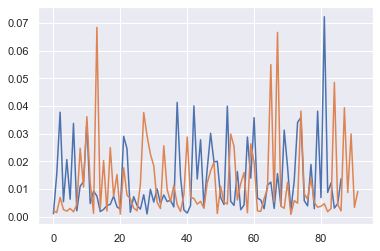

79


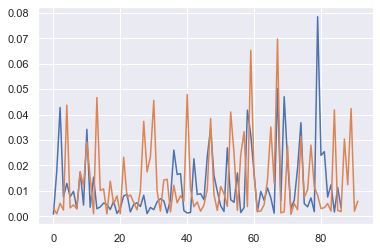

80


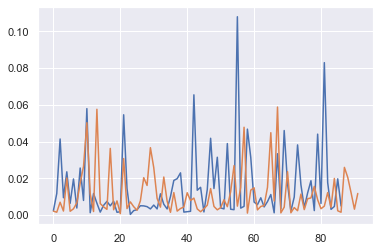

81


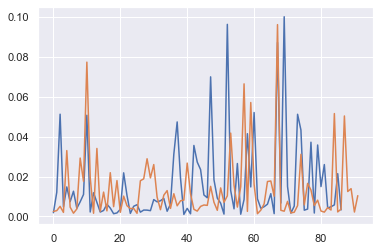

82


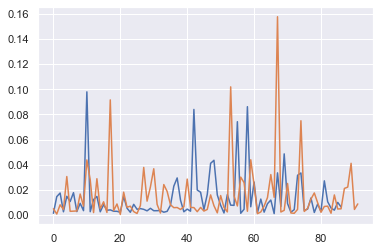

83


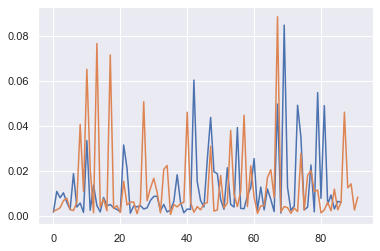

84


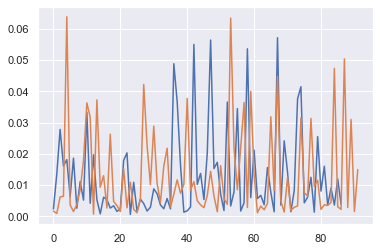

85


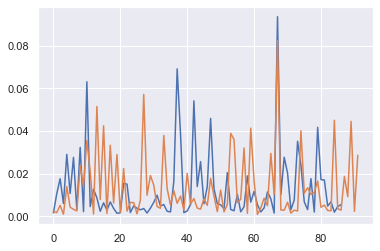

86


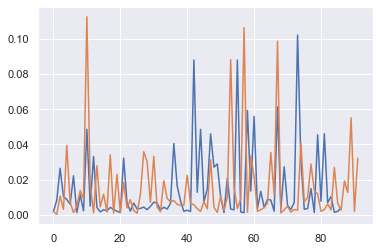

87


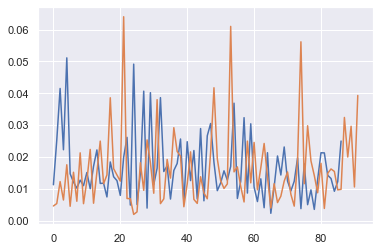

88


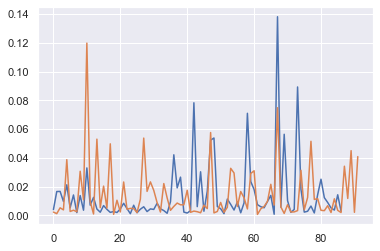

89


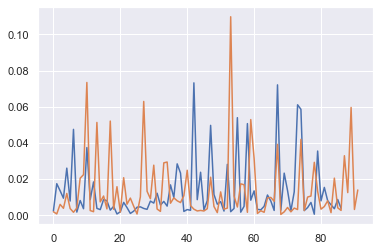

90


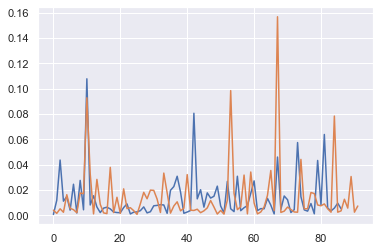

91


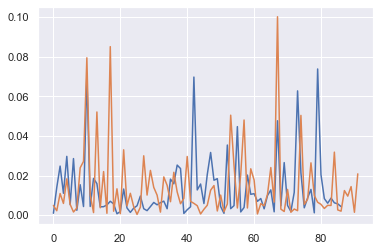

92


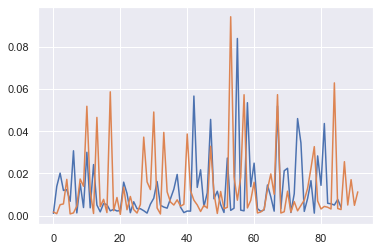

93


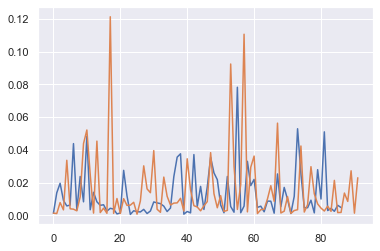

94


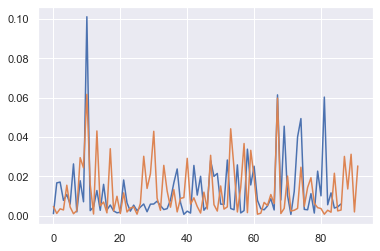

95


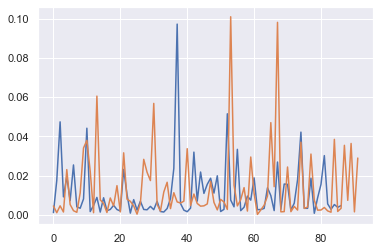

96


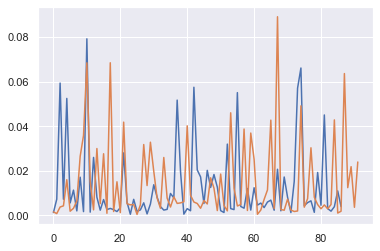

97


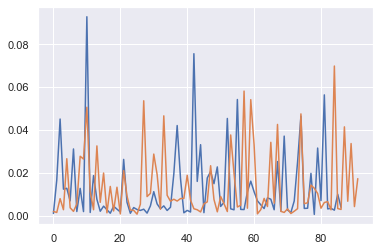

98


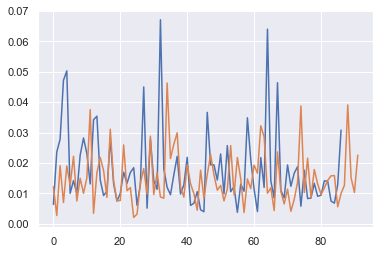

99


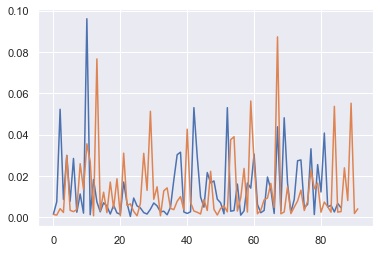

100


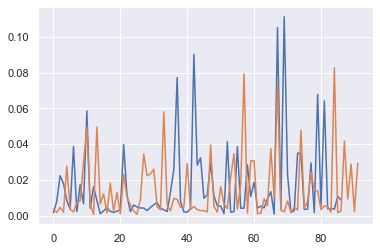

101


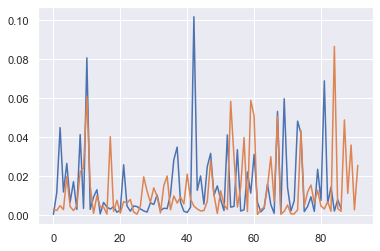

102


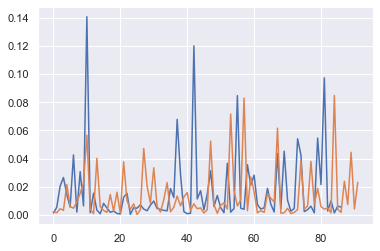

103


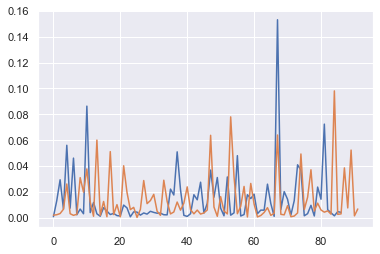

104


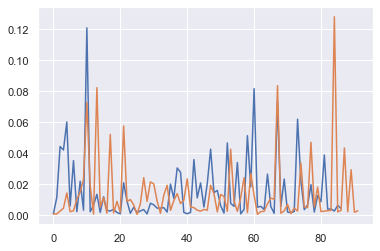

105


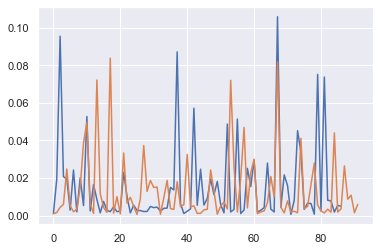

106


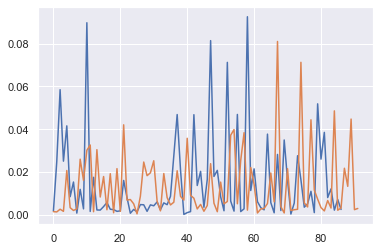

107


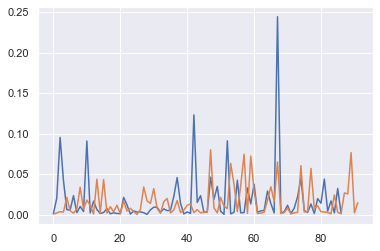

108


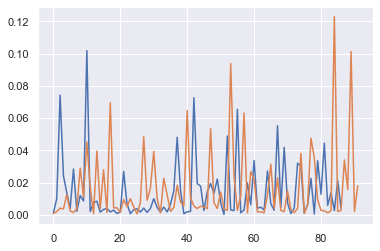

109


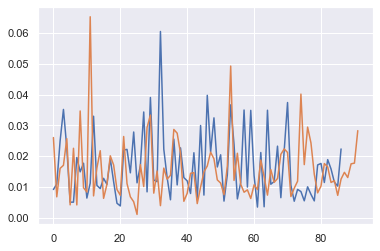

110


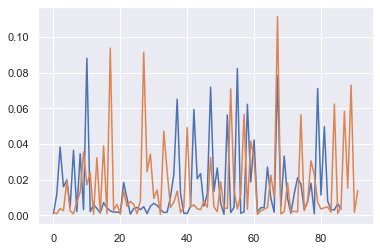

111


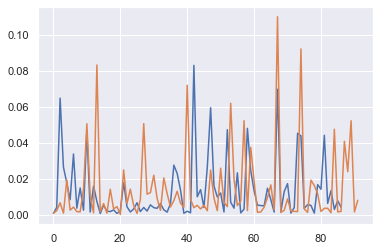

112


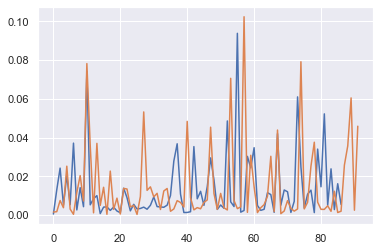

113


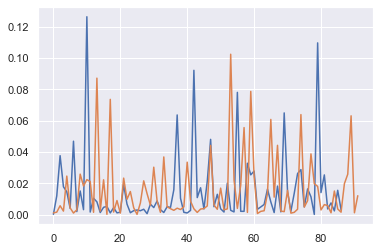

114


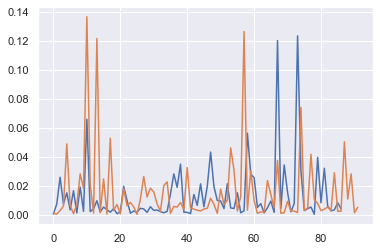

115


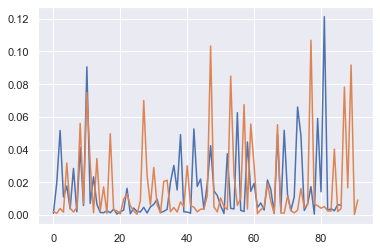

116


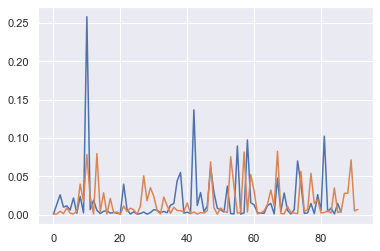

117


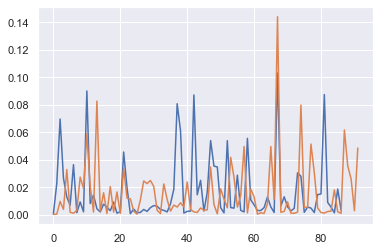

118


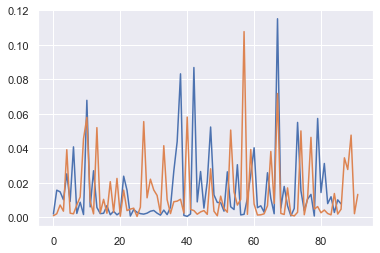

119


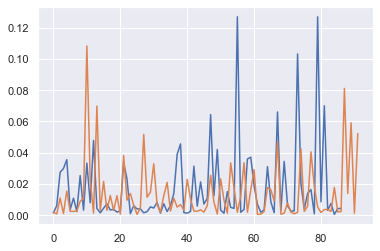

120


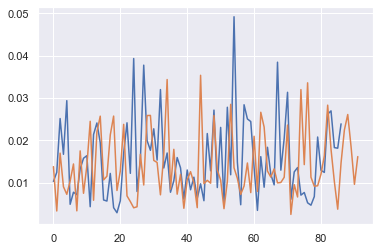

121


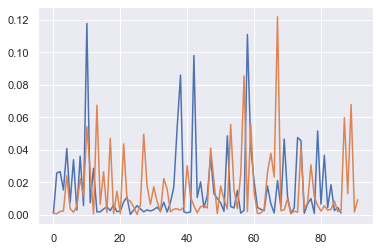

122


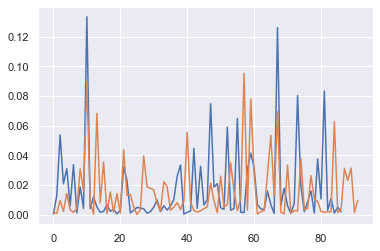

123


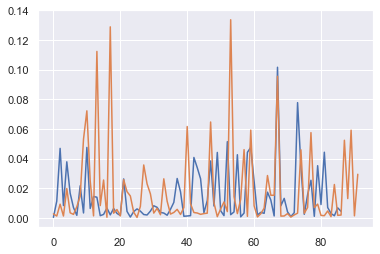

124


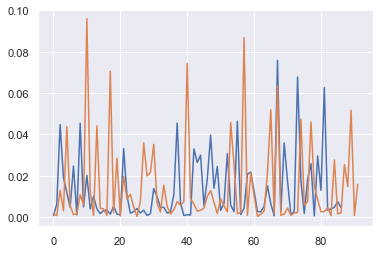

125


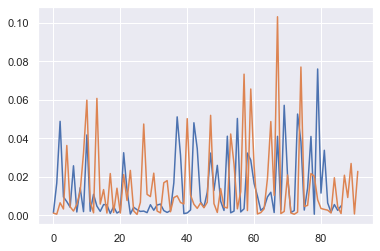

126


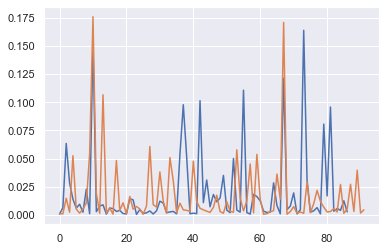

127


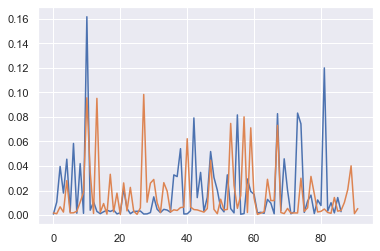

128


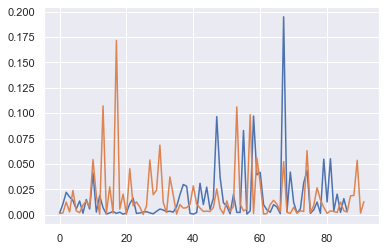

129


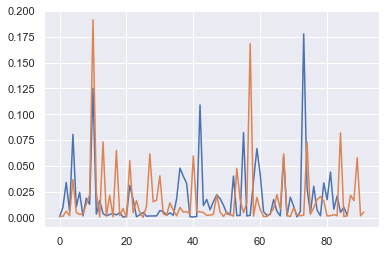

130


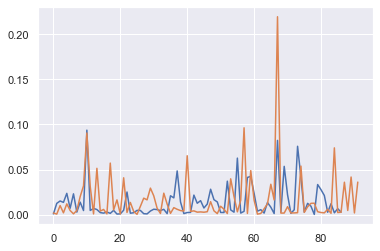

131


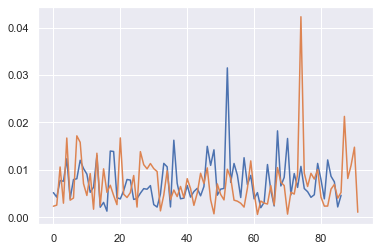

132


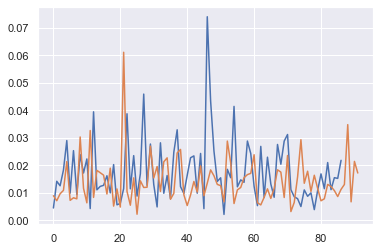

133


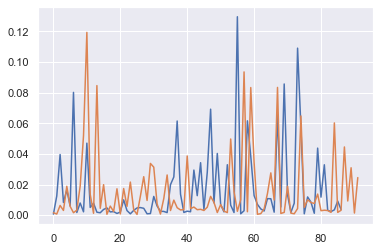

134


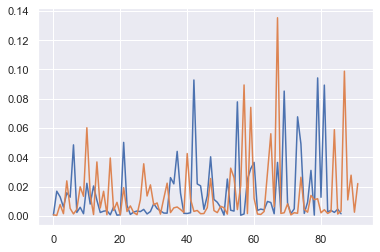

135


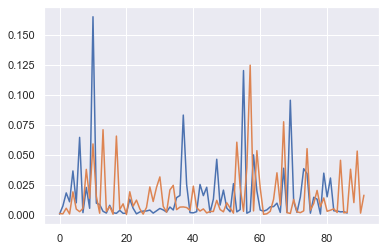

136


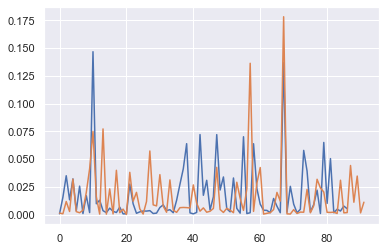

137


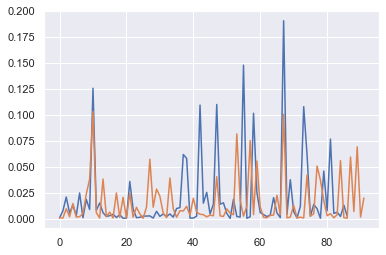

138


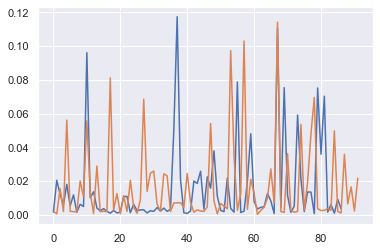

139


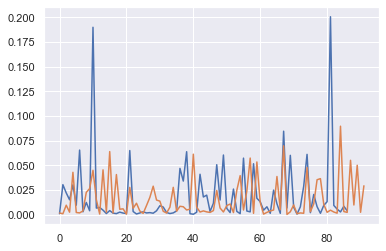

140


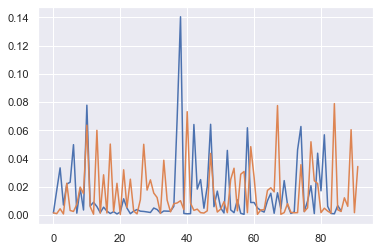

141


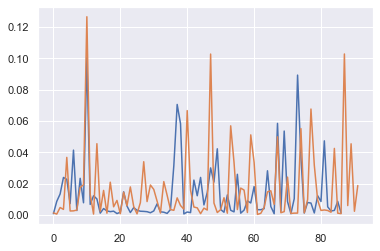

142


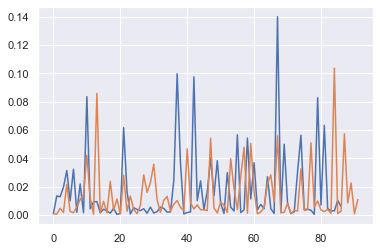

143


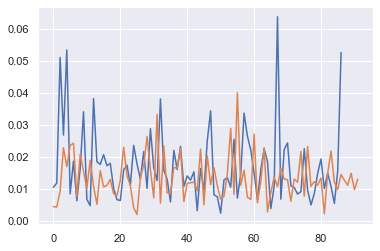

144


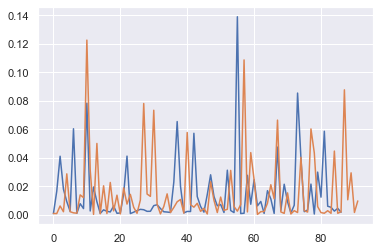

145


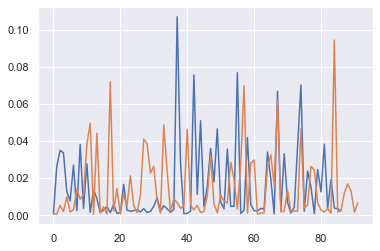

146


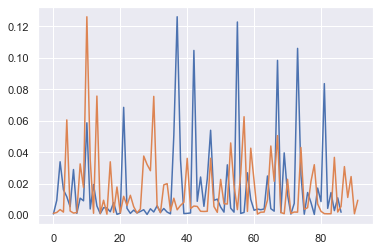

147


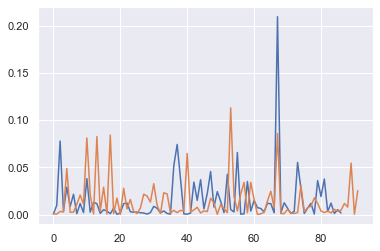

148


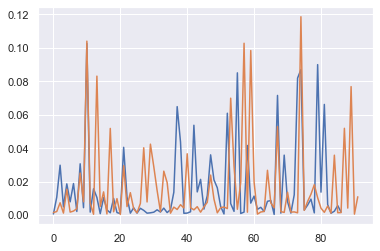

149


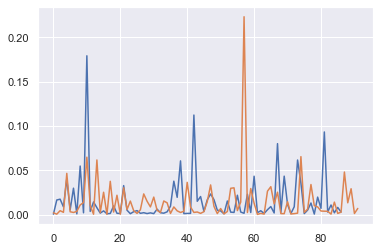

150


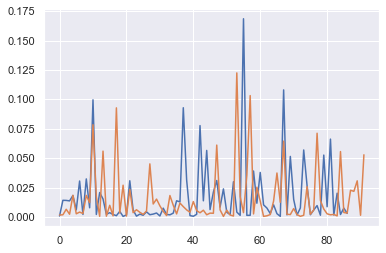

151


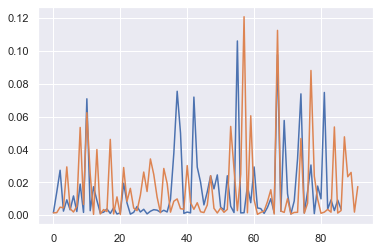

152


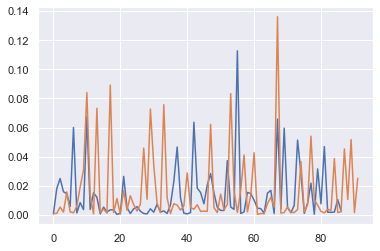

153


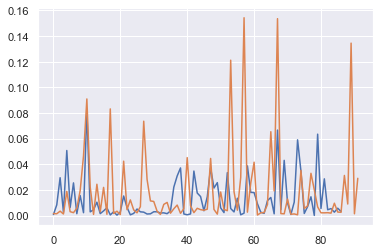

154


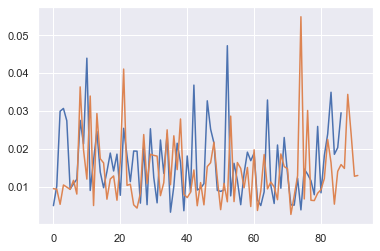

155


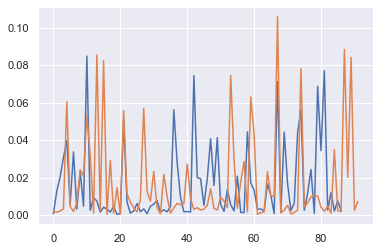

156


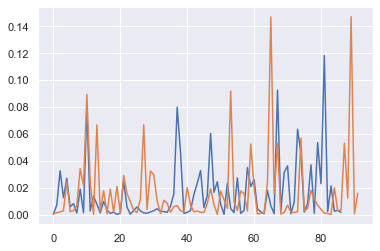

157


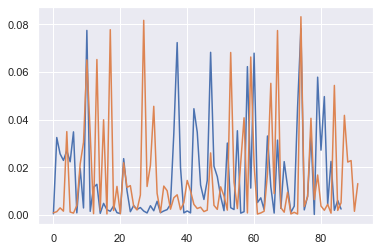

158


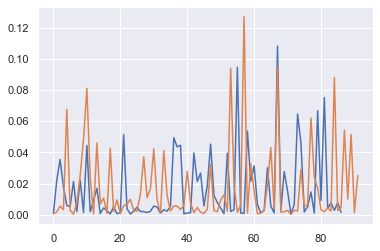

159


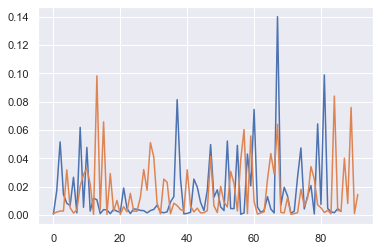

160


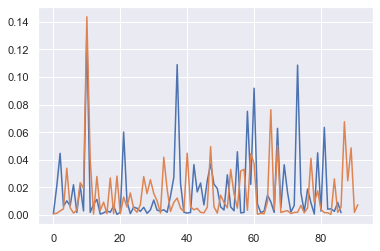

161


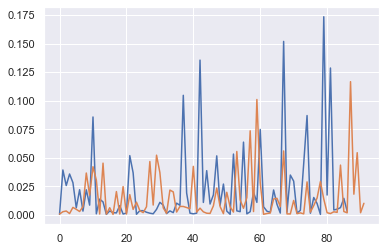

162


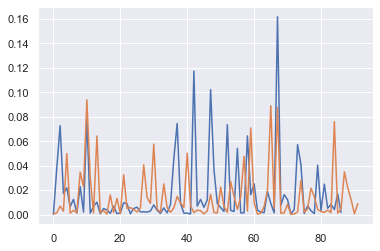

163


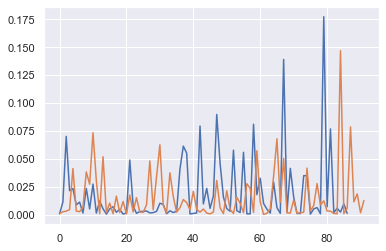

164


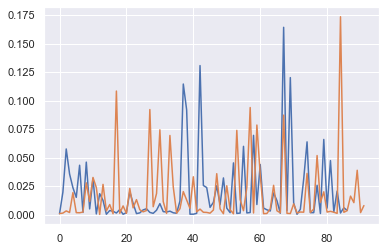

165


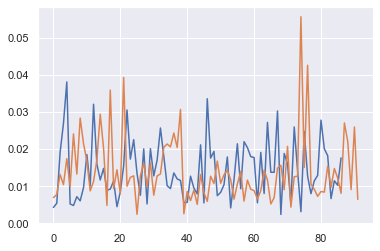

166


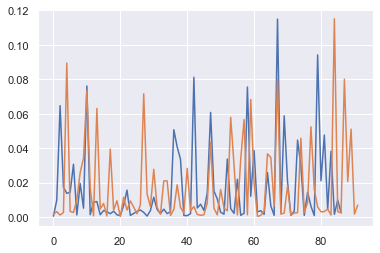

167


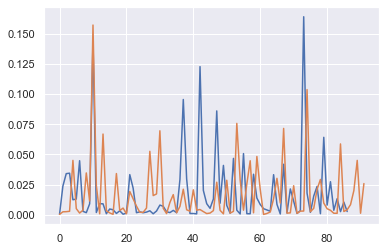

168


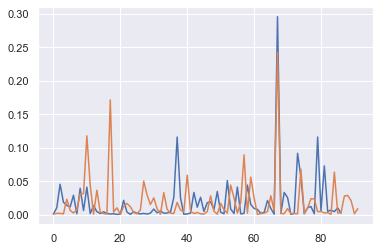

169


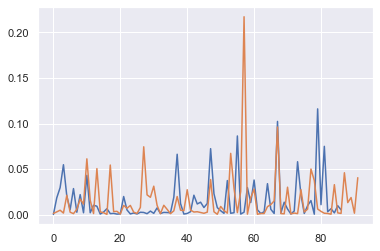

170


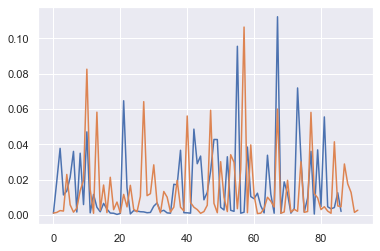

171


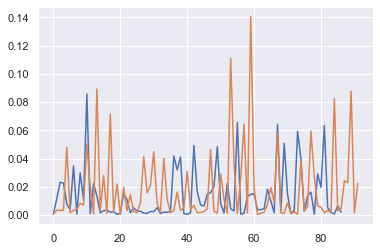

172


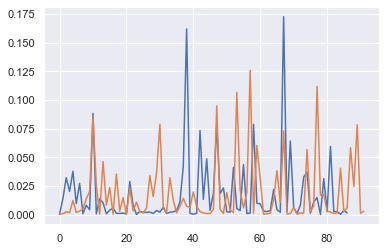

173


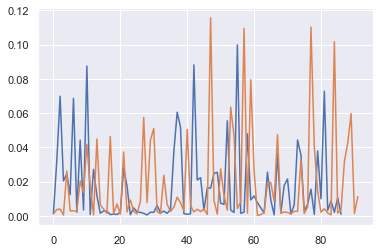

174


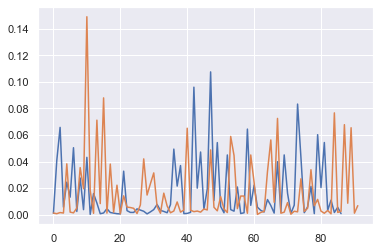

175


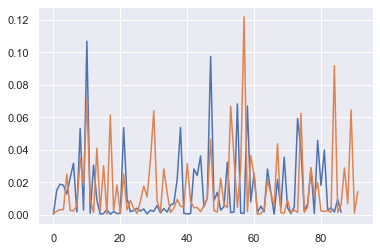

176


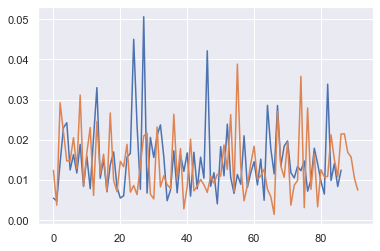

177


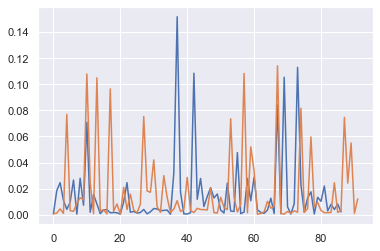

178


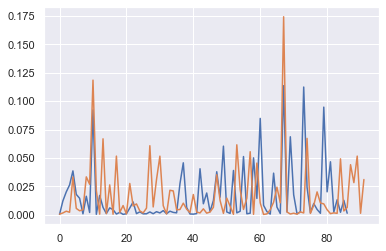

179


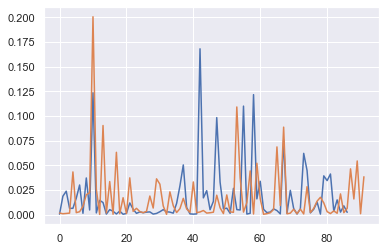

180


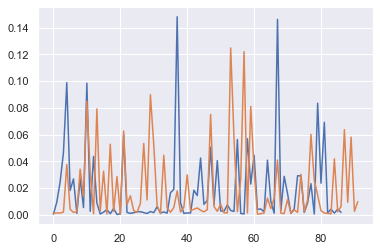

181


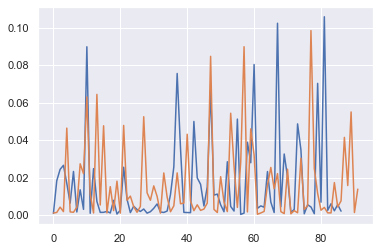

182


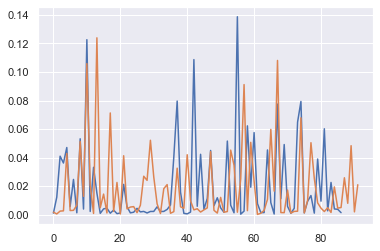

183


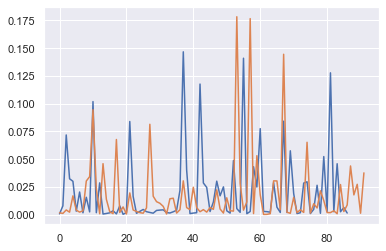

184


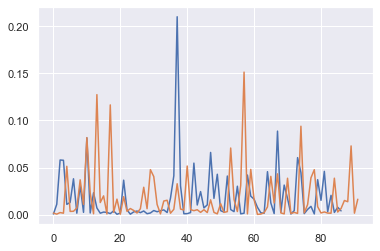

185


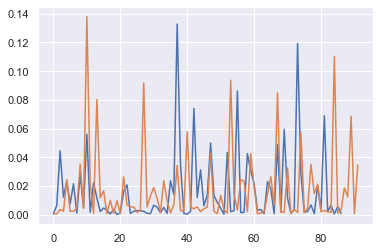

186


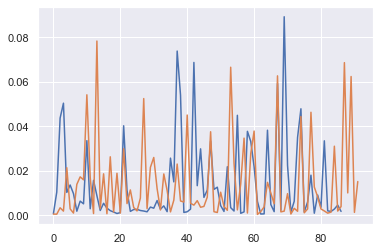

187


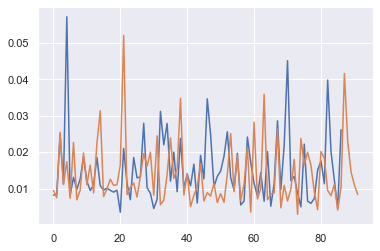

188


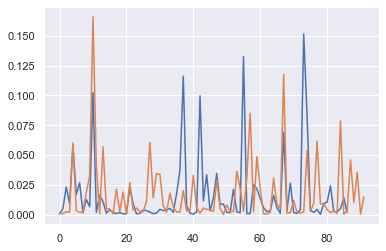

189


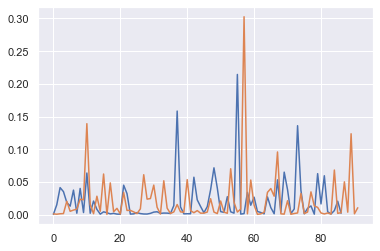

190


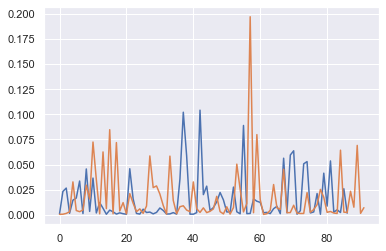

191


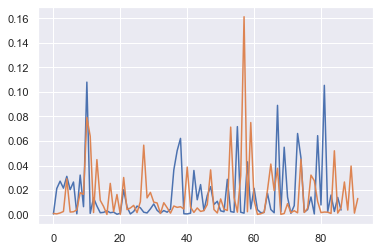

192


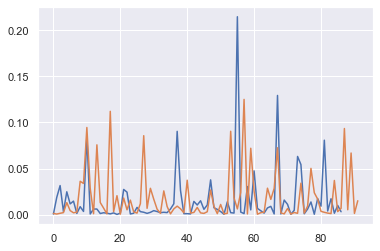

193


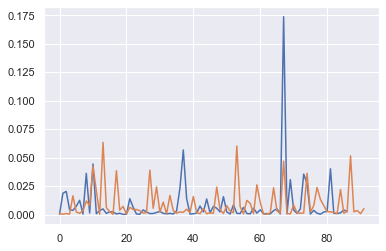

194


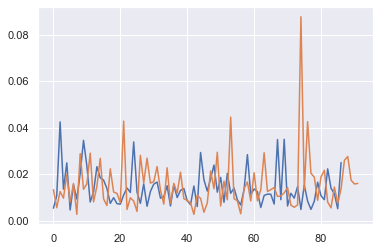

195


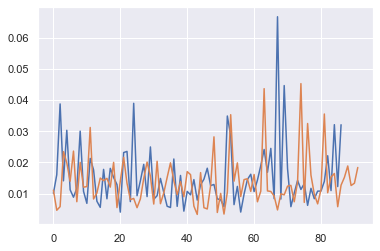

196


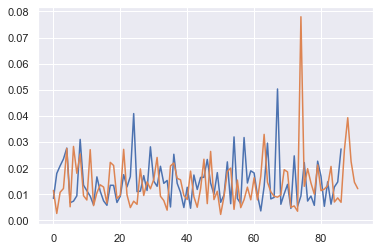

197


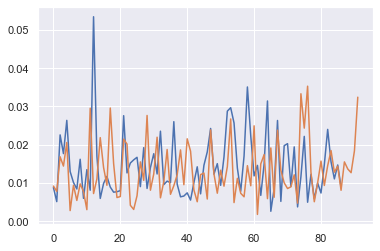

198


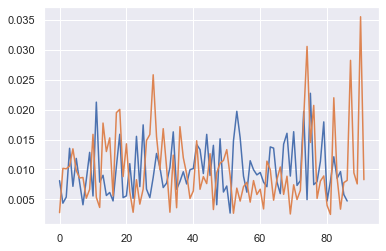

199


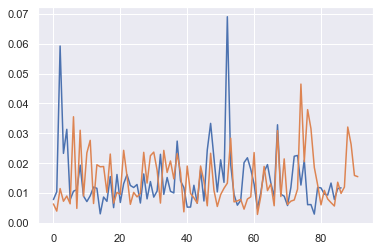

200


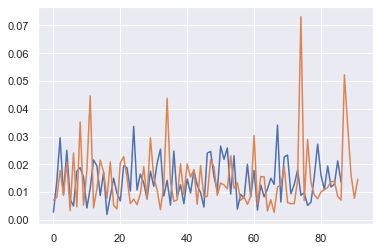

201


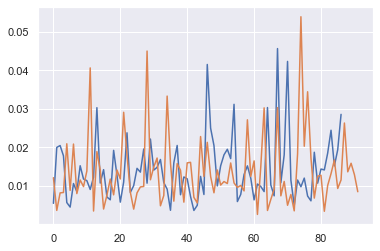

202


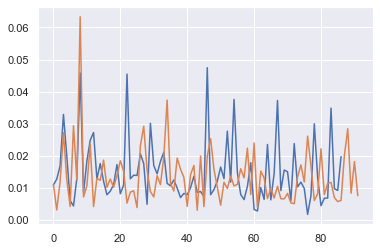

203


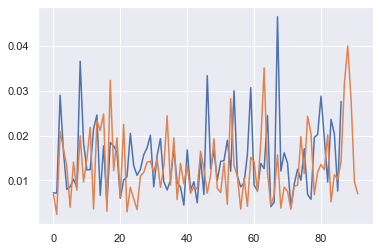

204


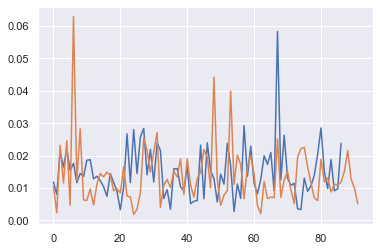

205


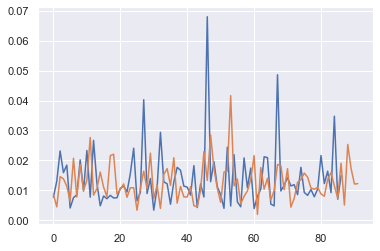

206


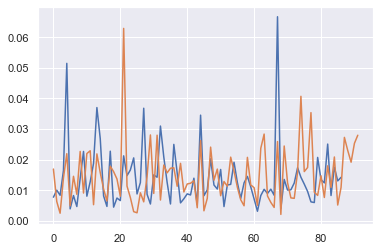

207


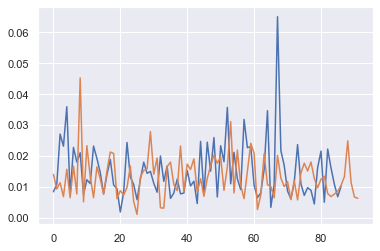

208


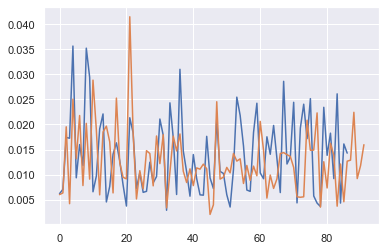

209


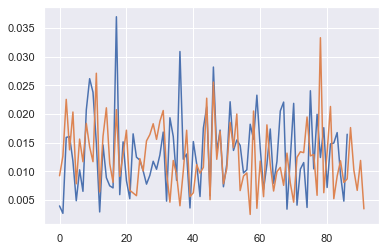

210


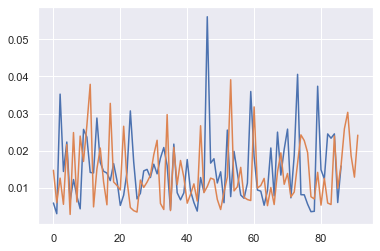

211


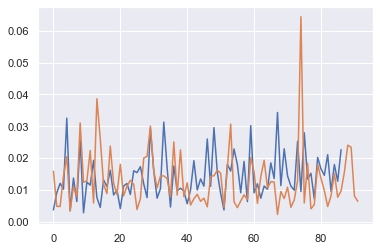

212


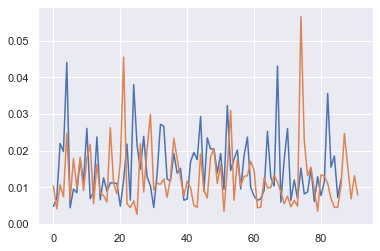

213


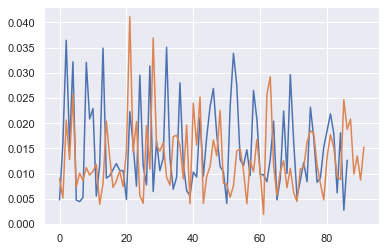

214


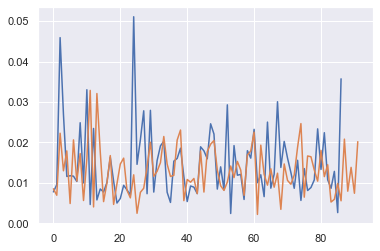

215


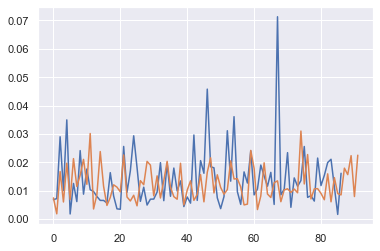

216


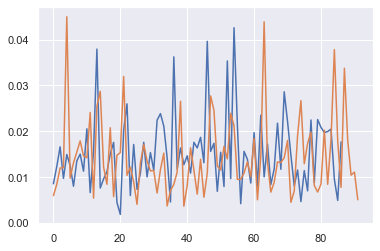

217


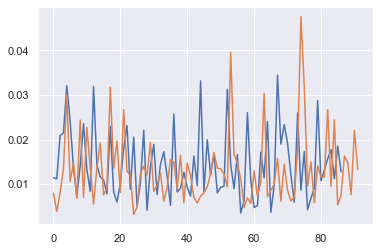

218


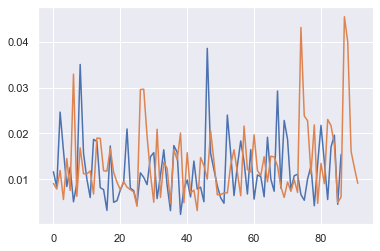

219


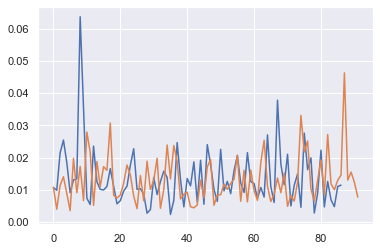

220


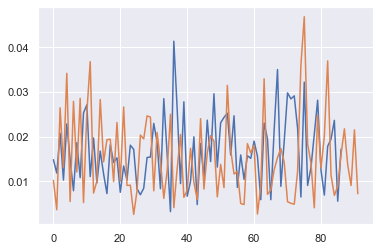

221


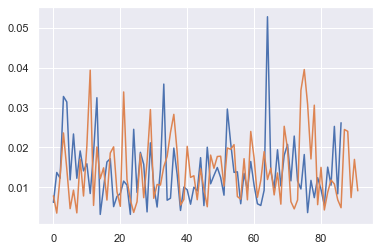

222


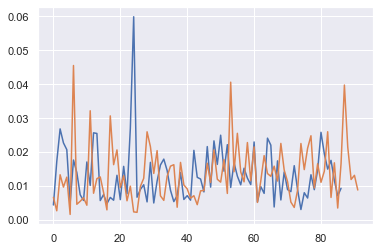

223


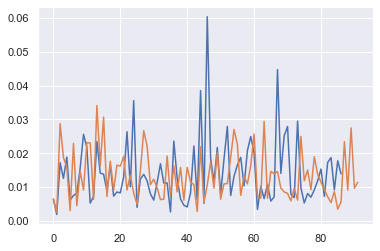

224


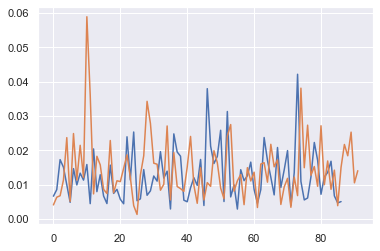

225


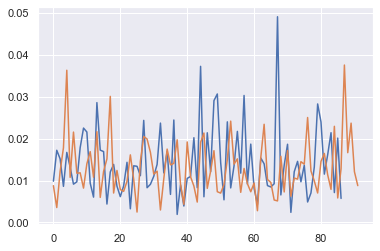

226


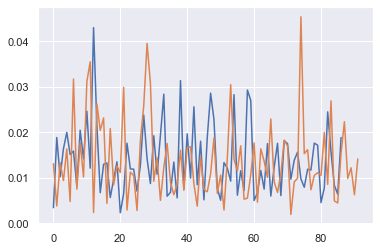

227


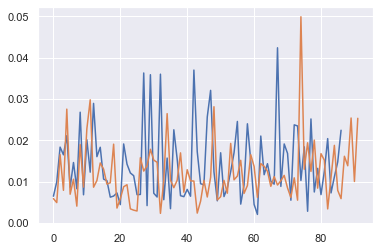

228


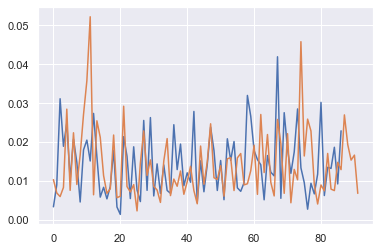

229


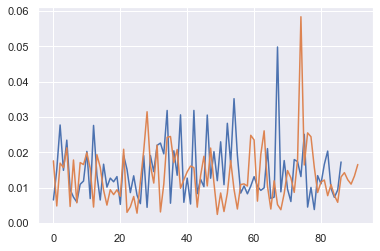

230


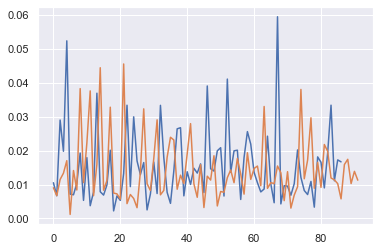

231


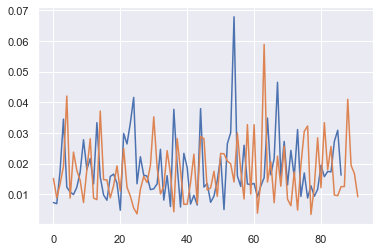

232


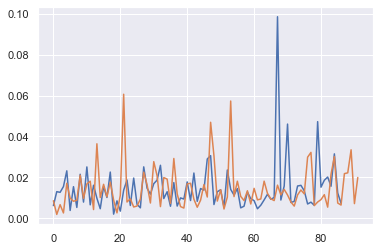

233


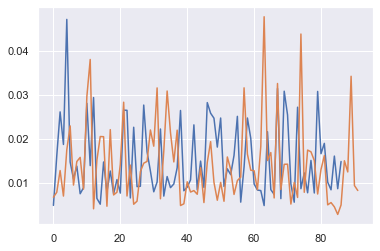

234


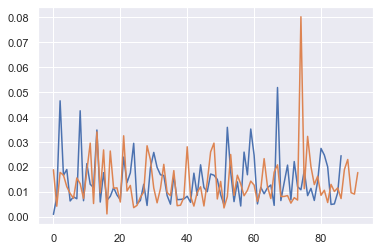

235


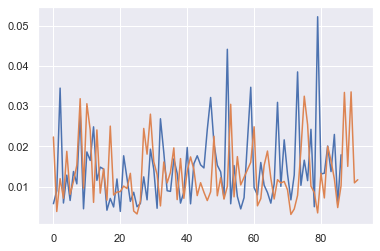

236


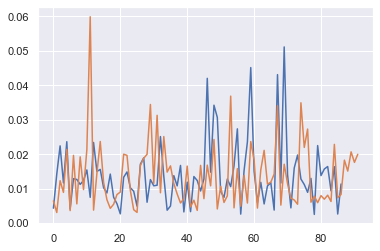

237


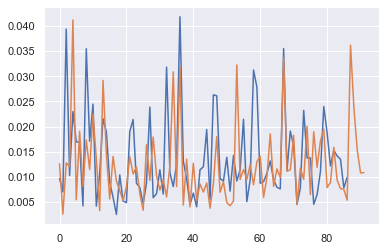

238


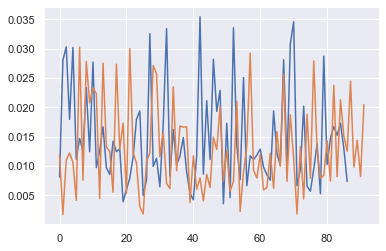

239


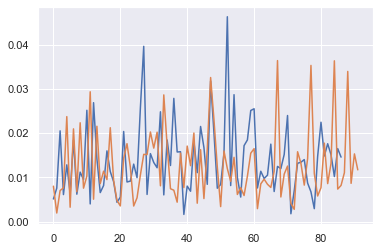

240


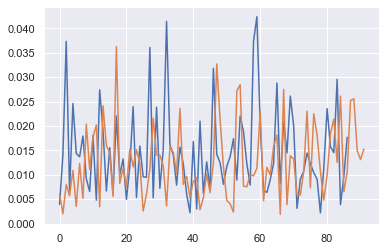

241


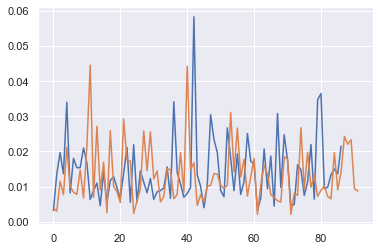

242


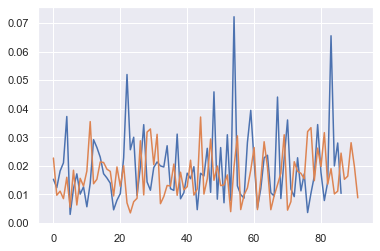

243


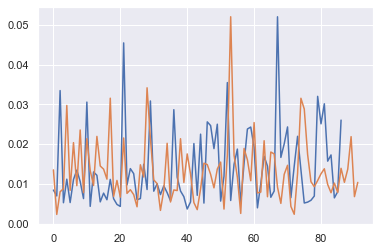

244


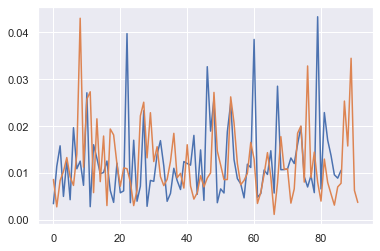

245


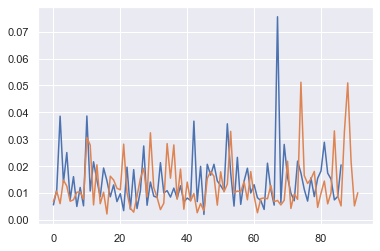

246


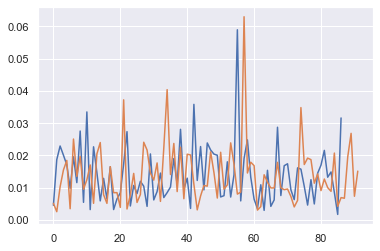

247


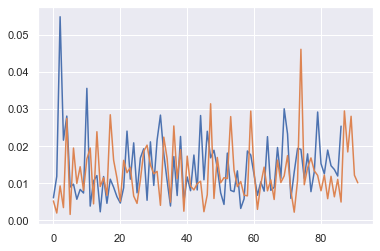

248


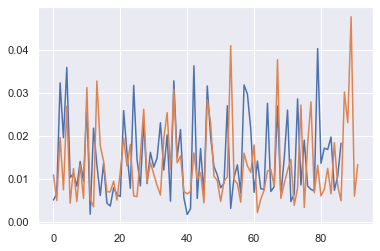

249


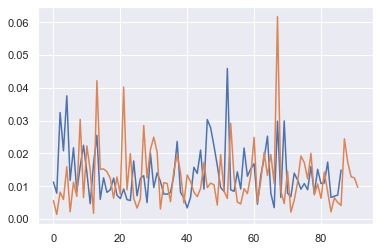

250


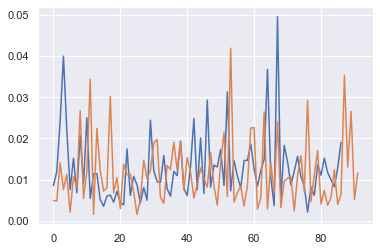

251


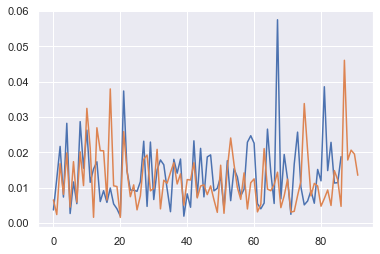

252


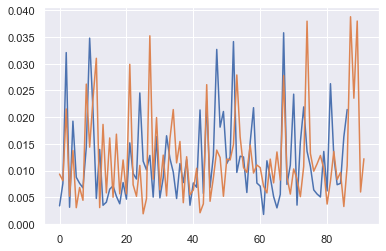

253


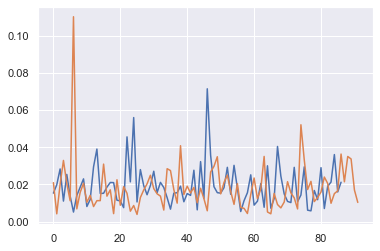

254


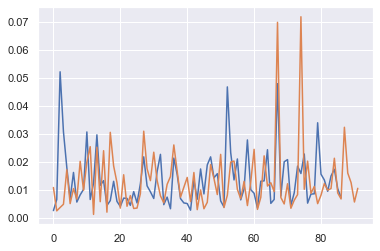

255


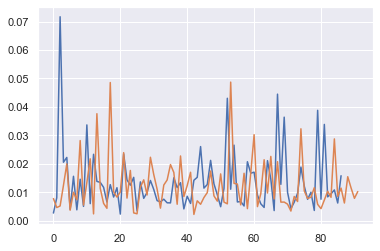

256


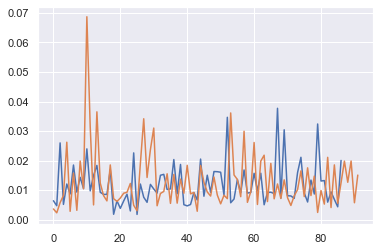

257


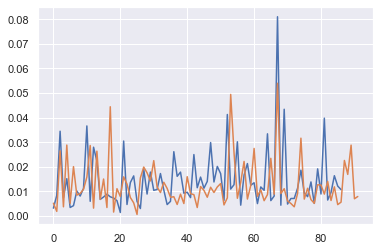

258


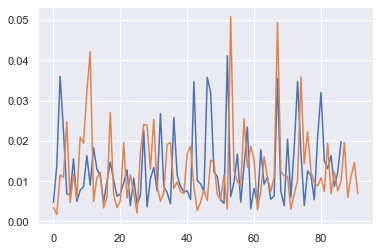

259


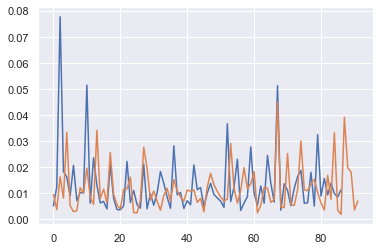

260


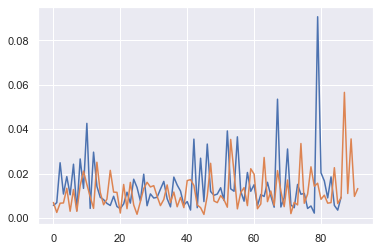

261


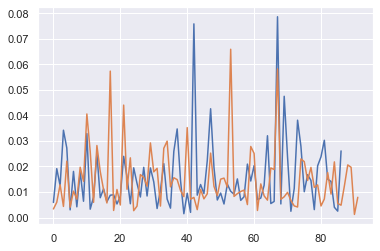

262


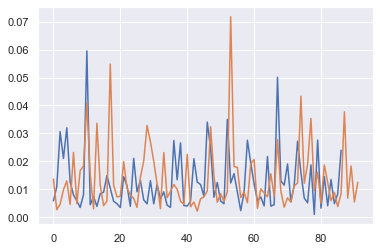

263


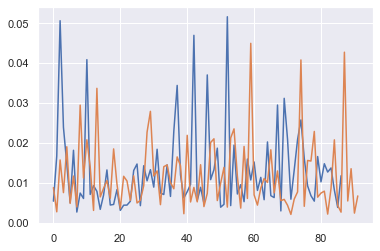

264


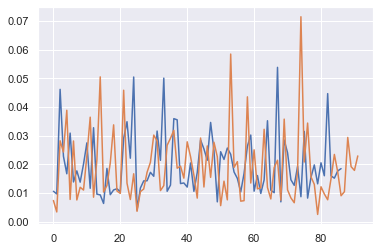

265


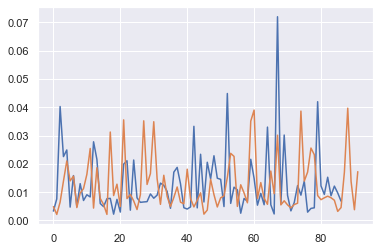

266


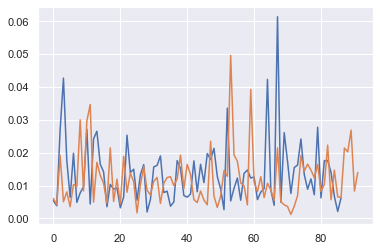

267


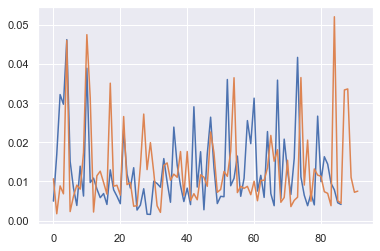

268


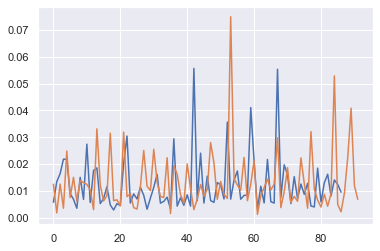

269


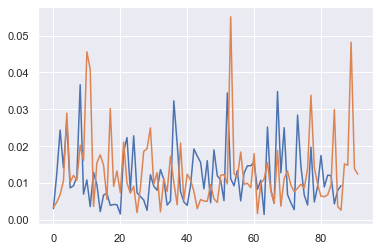

270


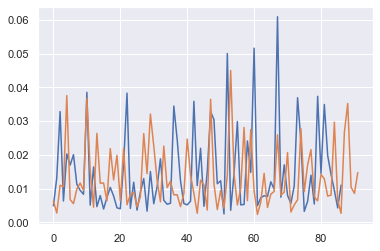

271


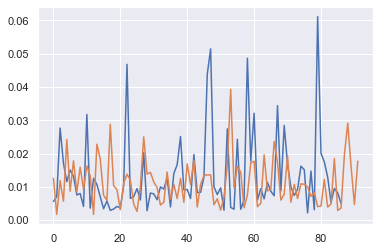

272


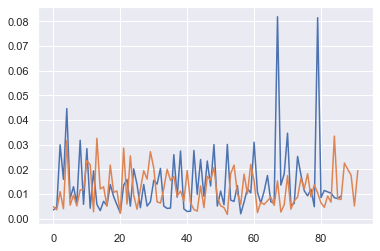

273


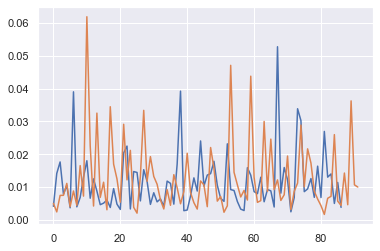

274


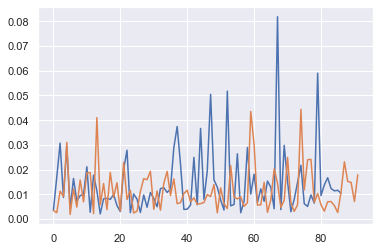

275


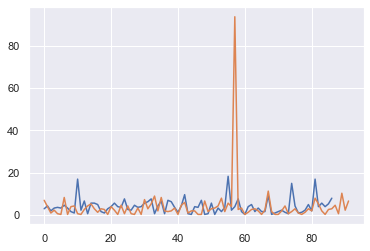

276


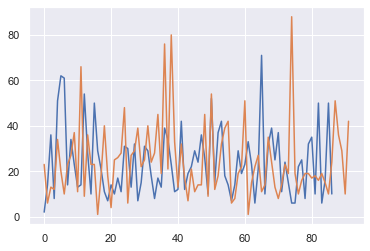

277


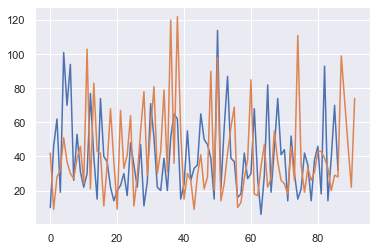

278


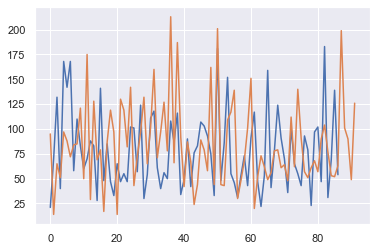

279


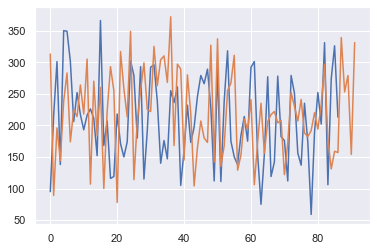

280


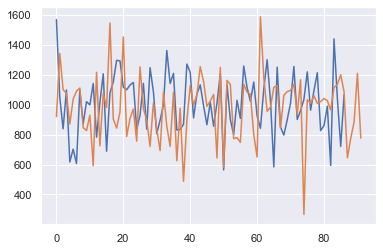

281


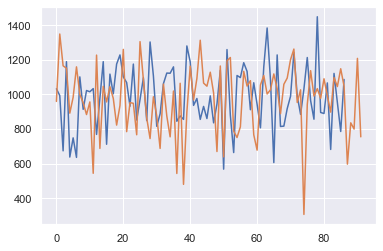

282


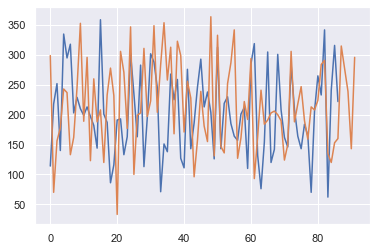

283


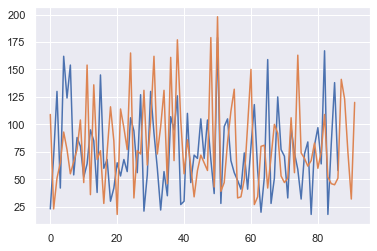

284


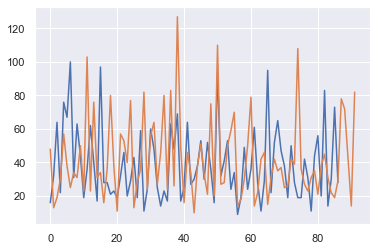

285


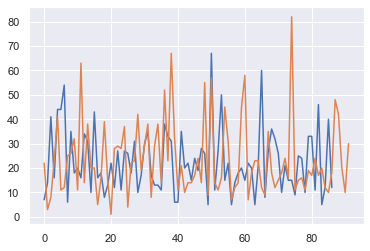

286


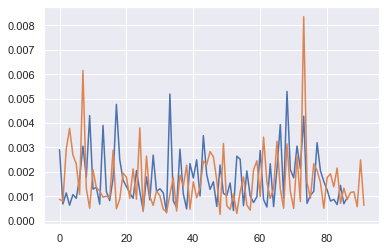

287


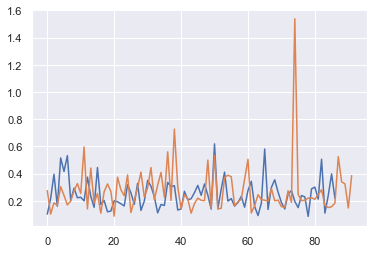

288


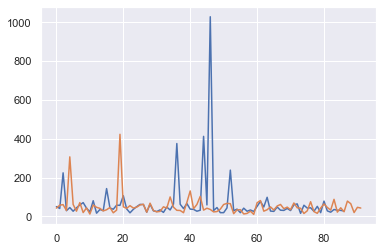

289


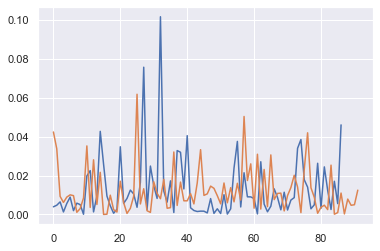

290


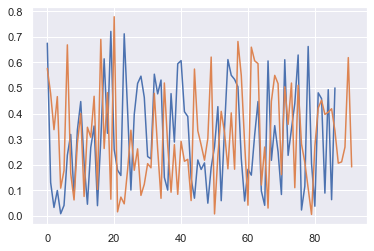

291


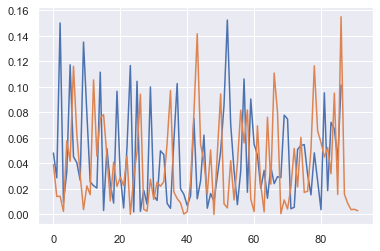

292


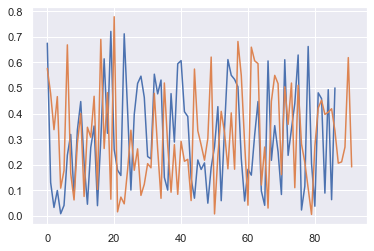

293


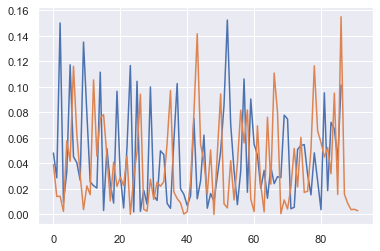

294


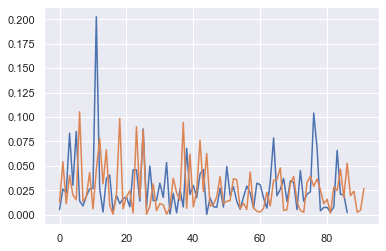

295


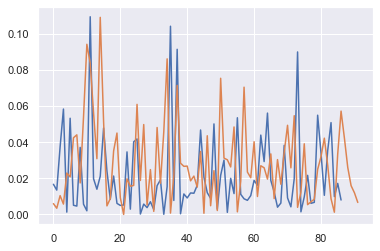

296


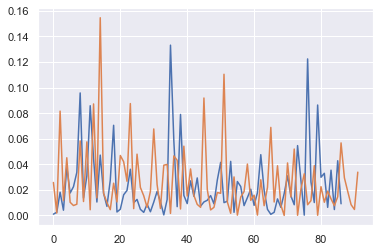

297


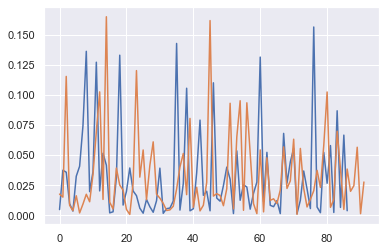

298


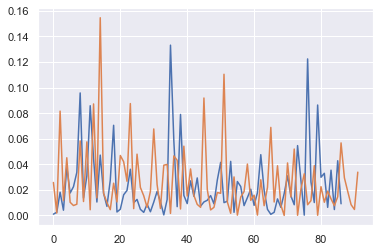

299


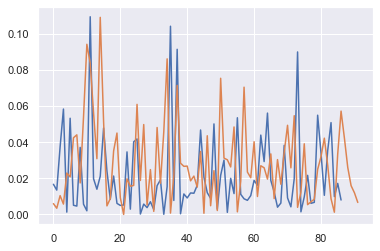

300


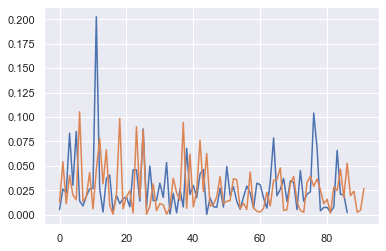

301


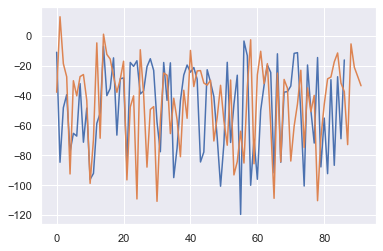

302


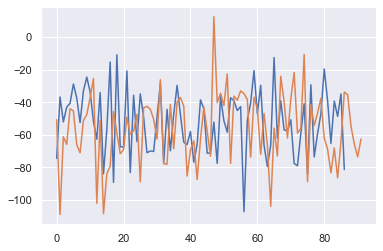

303


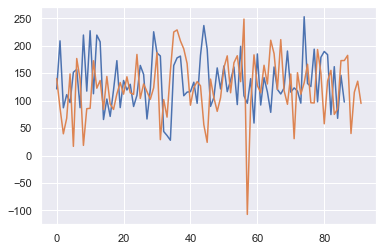

304


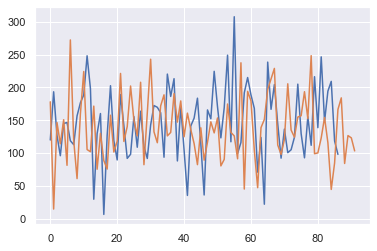

305


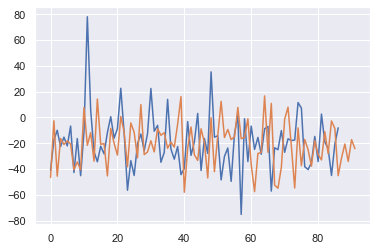

306


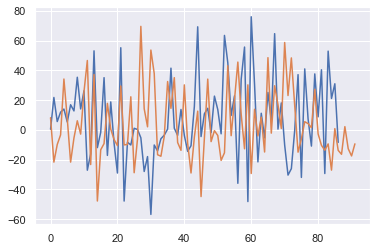

307


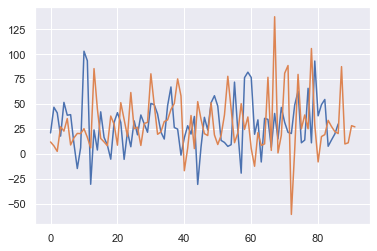

308


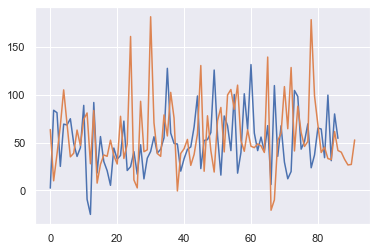

309


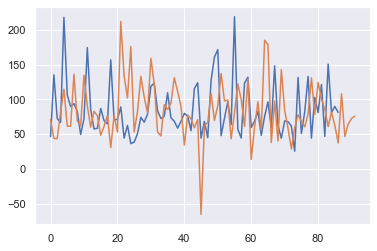

310


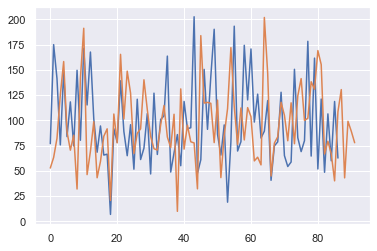

311


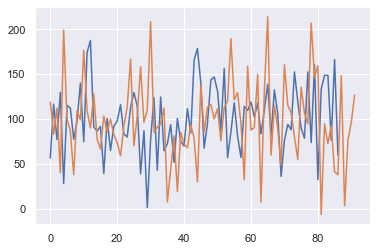

312


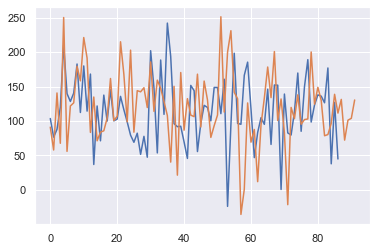

313


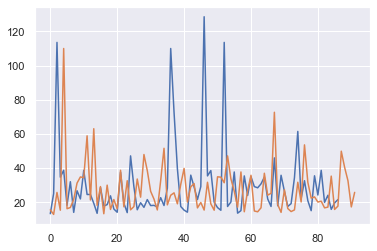

314


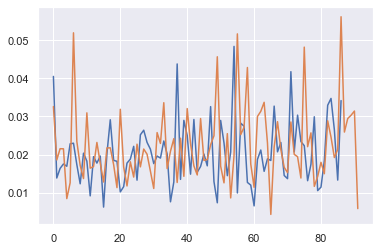

315


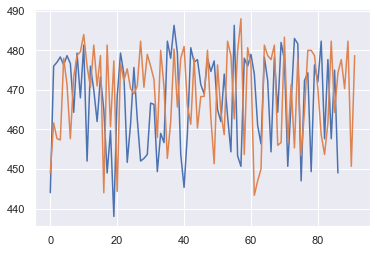

316


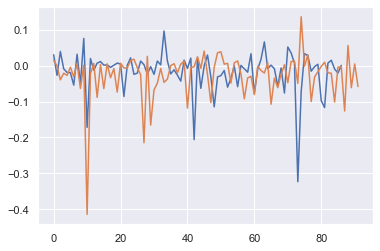

317


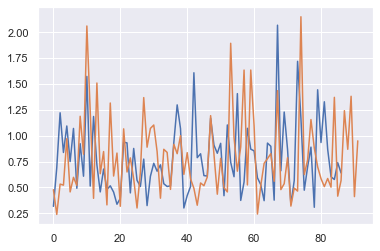

318


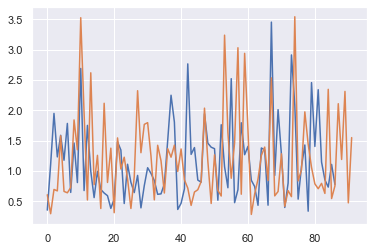

319


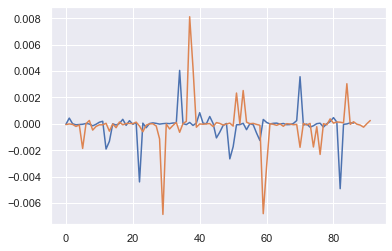

320


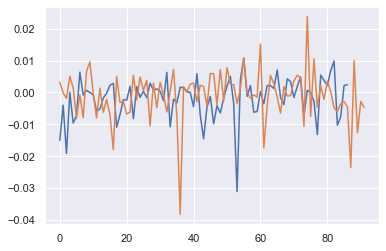

321


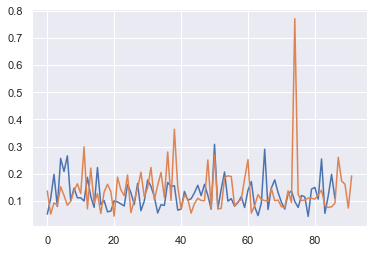

322


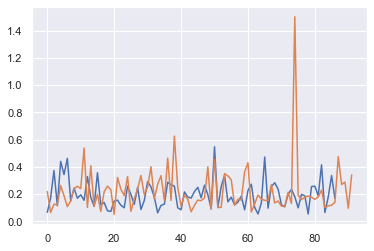

323


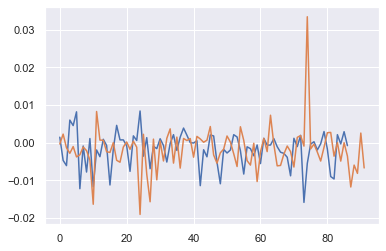

324


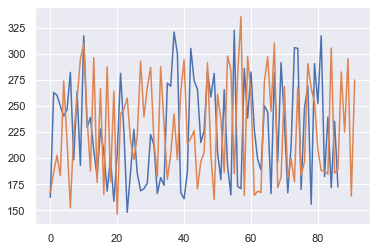

325


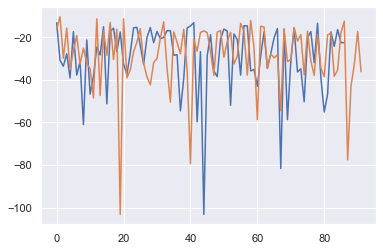

326


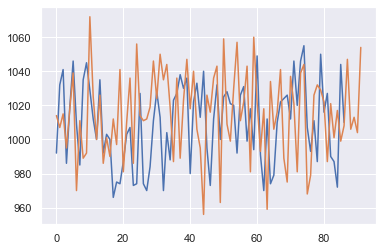

327


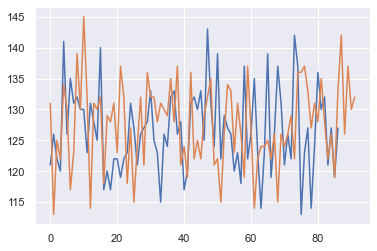

328


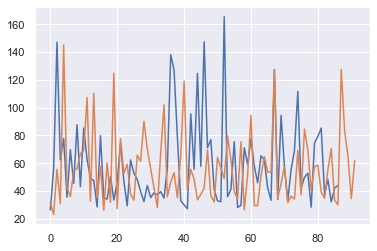

329


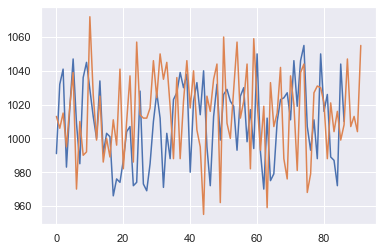

330


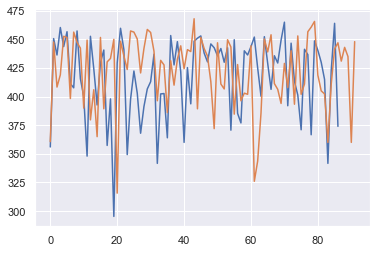

331


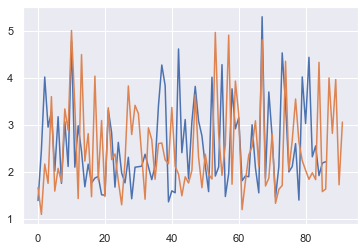

332


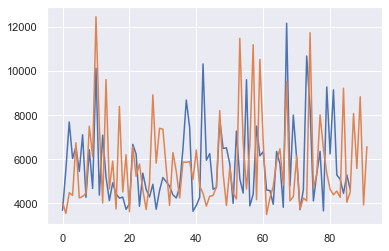

333


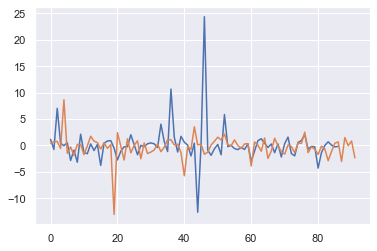

334


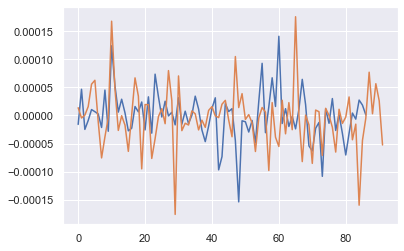

335


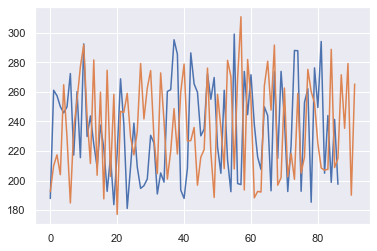

336


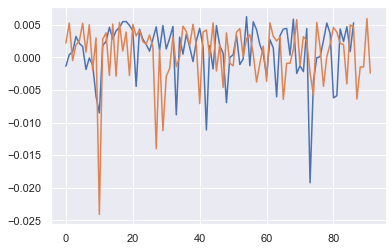

337


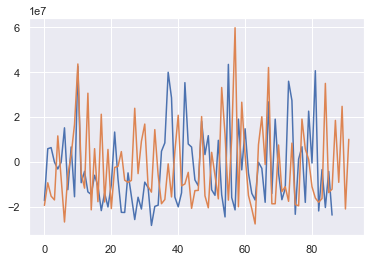

338


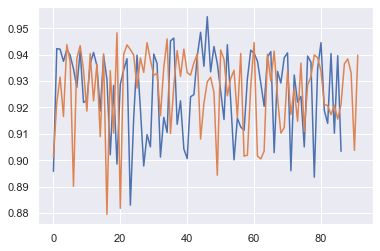

339


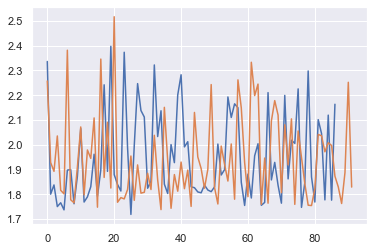

340


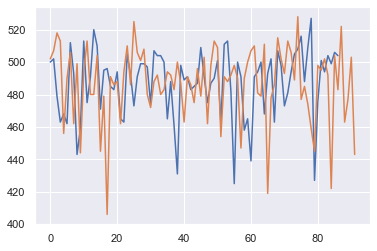

341


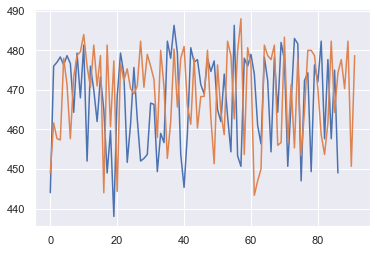

342


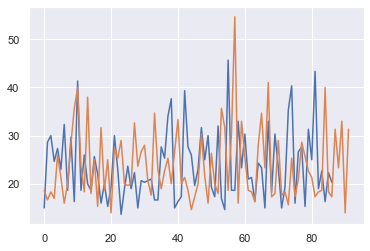

343


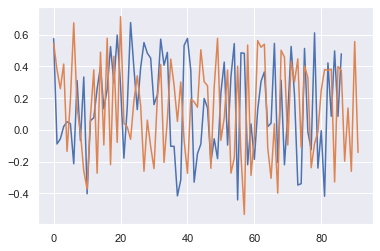

344


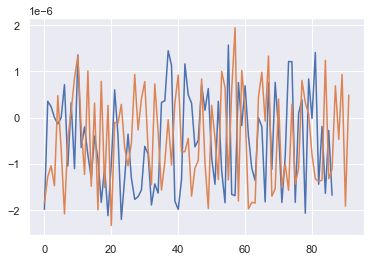

345


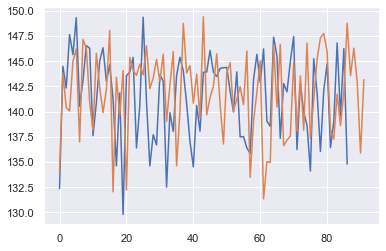

346


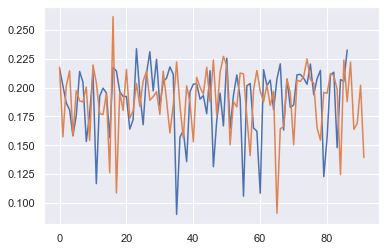

347


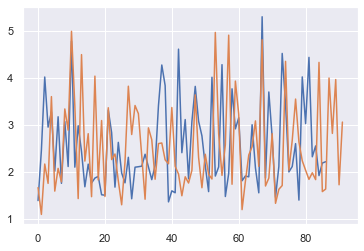

348


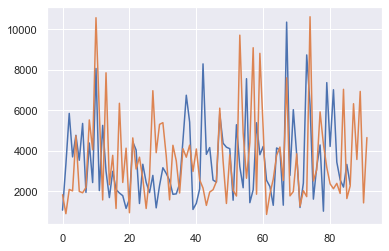

349


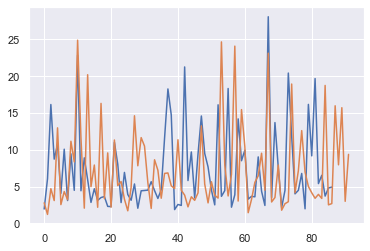

350


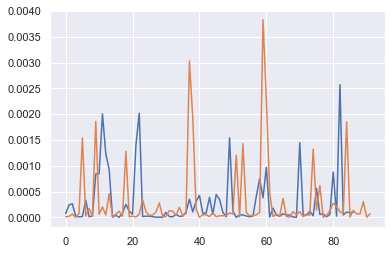

351


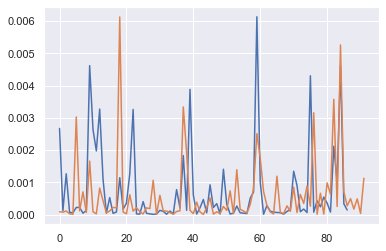

352


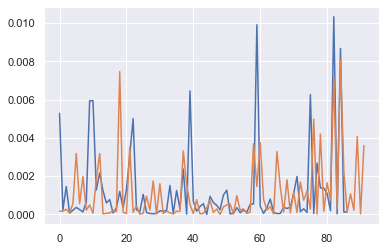

353


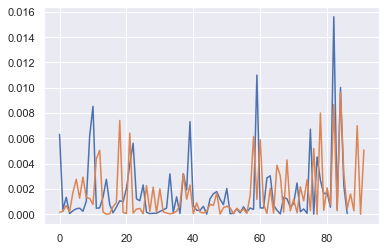

354


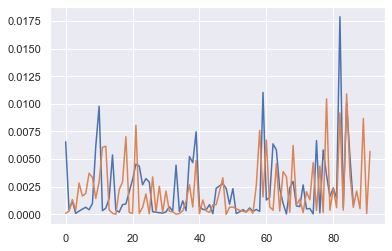

355


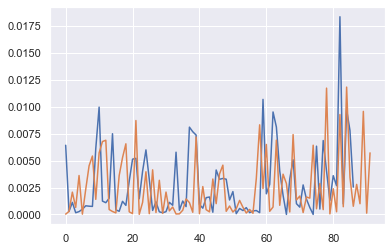

356


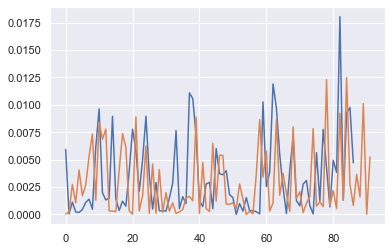

357


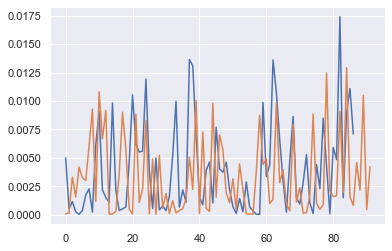

358


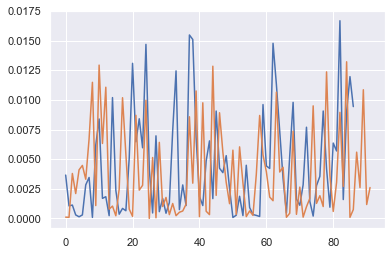

359


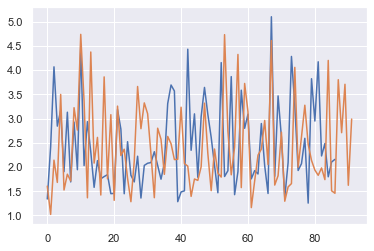

360


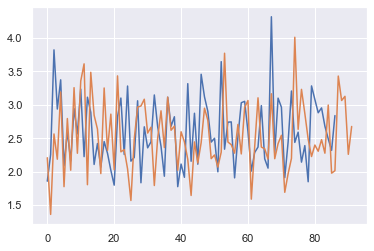

361


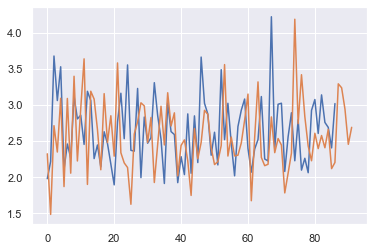

362


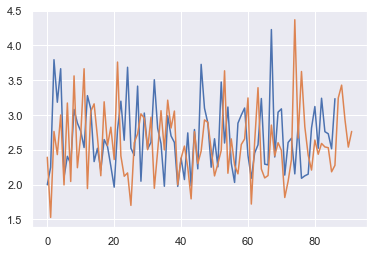

363


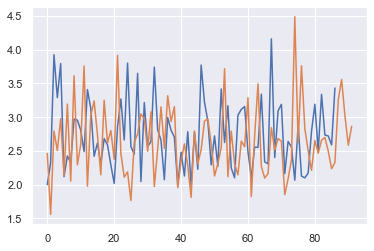

364


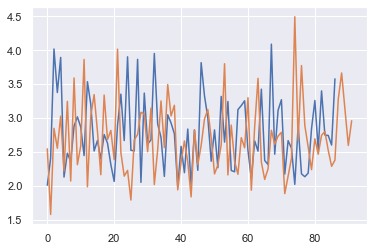

365


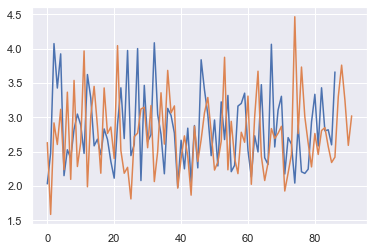

366


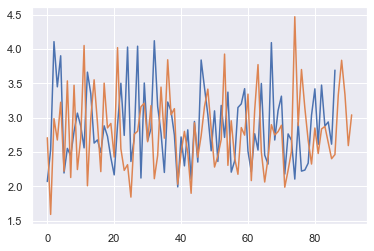

367


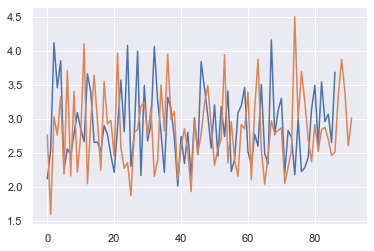

368


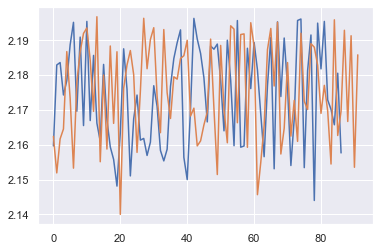

369


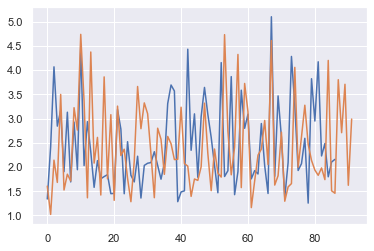

370


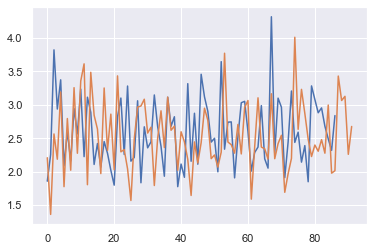

371


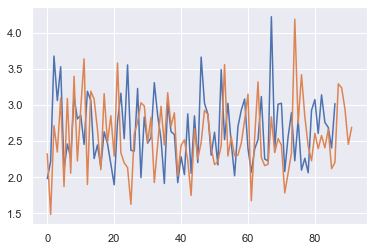

372


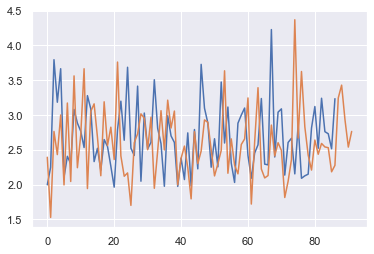

373


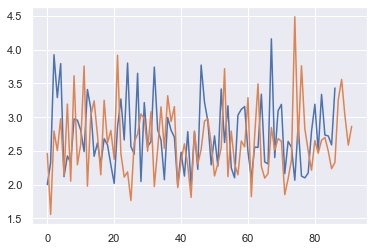

374


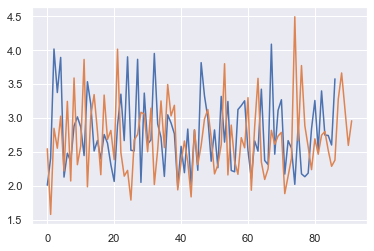

375


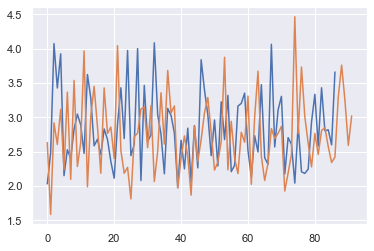

376


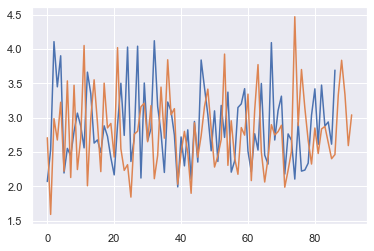

377


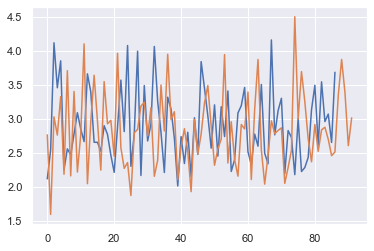

378


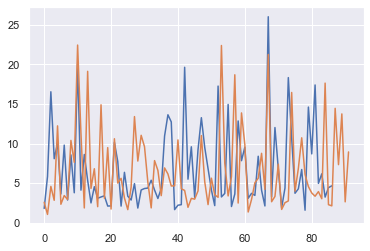

379


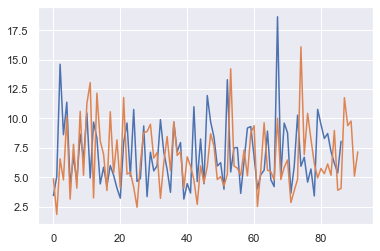

380


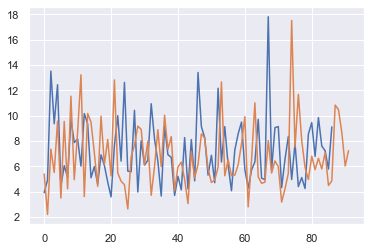

381


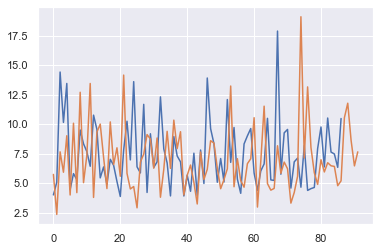

382


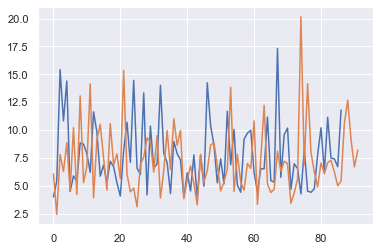

383


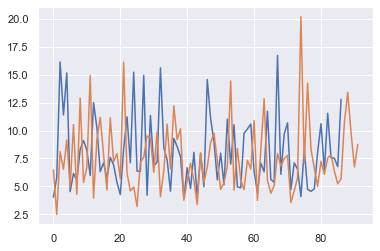

384


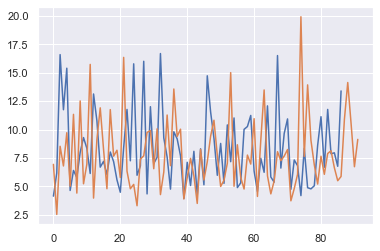

385


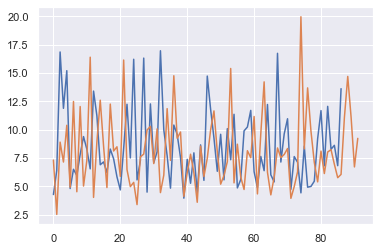

386


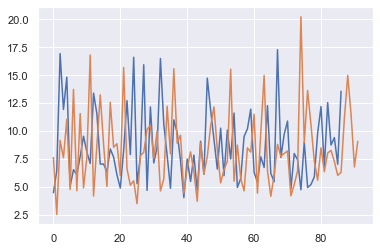

387


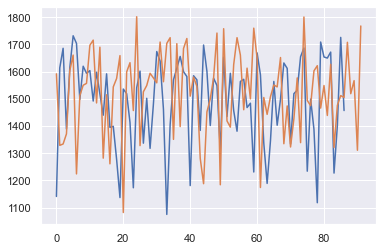

388


In [102]:
results = []
p_vals = []
for i in range(N_features):
    lr_XX_train = np.array(X_train_TSF)[0][i::int(N_features)]
    plt.plot(lr_XX_train[yytrain==1])
    plt.plot(lr_XX_train[yytrain==0])
    p_vals.append(scipy.stats.mannwhitneyu(lr_XX_train[yytrain==0], lr_XX_train[yytrain==1])[1])
    plt.show()
    print(i)

(array([ 8., 17., 39., 37., 38., 40., 39., 50., 53., 68.]),
 array([0.01051352, 0.10946217, 0.20841082, 0.30735947, 0.40630811,
        0.50525676, 0.60420541, 0.70315406, 0.8021027 , 0.90105135,
        1.        ]),
 <BarContainer object of 10 artists>)

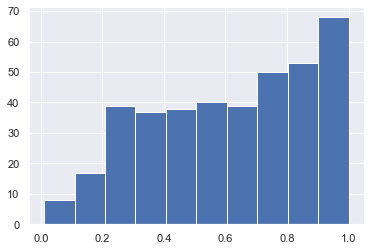

In [107]:
plt.hist(p_vals)

In [100]:
scipy.stats.mannwhitneyu(lr_XX_train[yytrain==0], lr_XX_train[yytrain==1])[1]

0.27848690447796254

In [113]:

for i in range(len(p_vals)):
    if p_vals[i]<0.1:
        print(i)
        print(X_train_TSF.columns[i])

133
0_FFT mean coefficient_20
144
0_FFT mean coefficient_21
155
0_FFT mean coefficient_22
213
0_FFT mean coefficient_42
276
0_Fundamental frequency
296
0_LPCC_4
300
0_LPCC_8


In [114]:
p_vals[276]

0.022533397036050156

In [118]:
Logistic_accuracy[276]

0.5083798882681565

In [108]:
min(p_vals)

0.010513524210380267

In [109]:
X_train_TSF.columns[1]

'0_Area under the curve'

(array([22., 11., 18., 12., 12.,  4.,  3.,  2.,  4.,  1.,  1.,  1.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.]),
 array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]),
 <BarContainer object of 19 artists>)

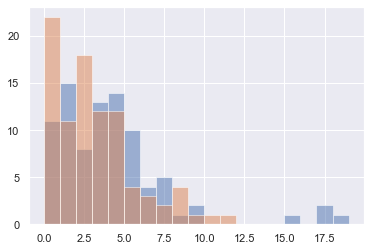

In [121]:
lr_XX_train = np.array(X_train_TSF)[0][276::int(N_features)]
plt.hist(lr_XX_train[yytrain==1],np.arange(20),alpha=0.5)
plt.hist(lr_XX_train[yytrain==0],np.arange(20),alpha=0.5)

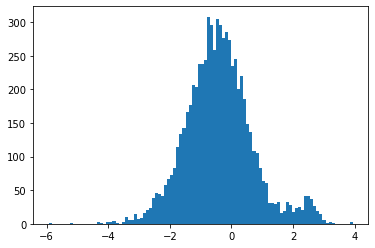

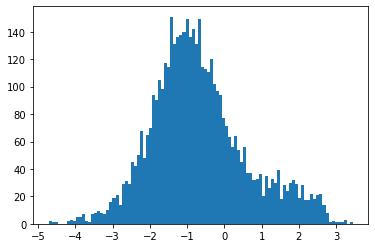

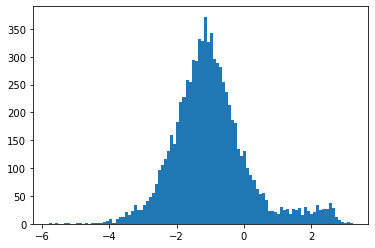

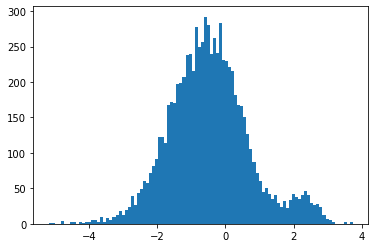

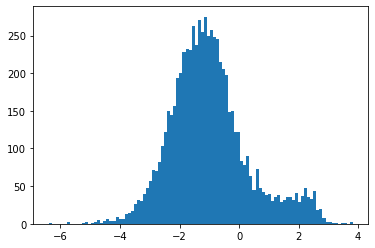

...

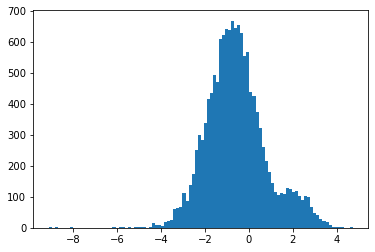

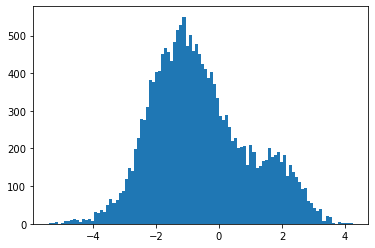

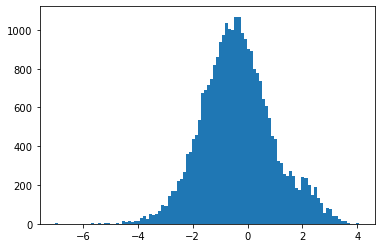

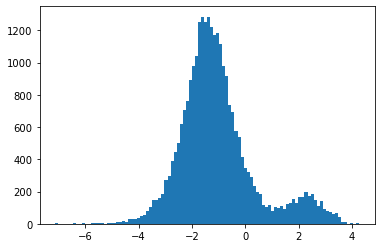

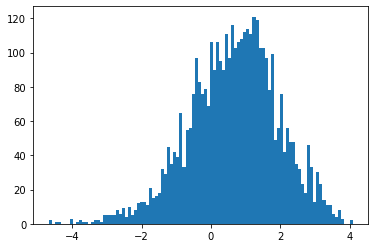

/var/folders/t4/yj25b68j71bg4j7p_w5jwglm0000gn/T/ipykernel_30907/2462790312.py:2: RuntimeWarning: invalid value encountered in log
  plt.hist(np.log(vS[i]),100);


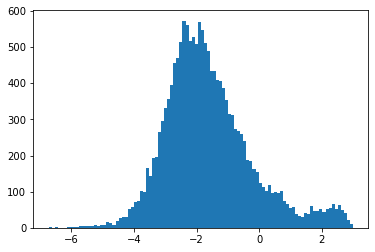

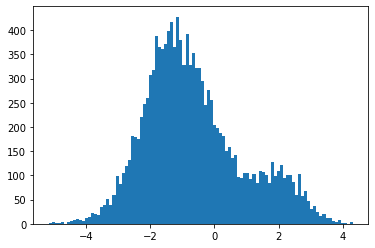

/var/folders/t4/yj25b68j71bg4j7p_w5jwglm0000gn/T/ipykernel_30907/2462790312.py:2: RuntimeWarning: divide by zero encountered in log
  plt.hist(np.log(vS[i]),100);


ValueError: supplied range of [-inf, 3.79653138431706] is not finite

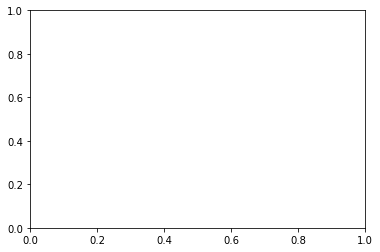

In [14]:
for i in range(len(dS)):
    plt.hist(np.log(vS[i]),100);
    plt.show()

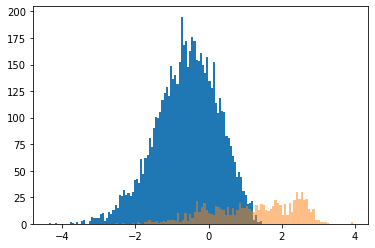

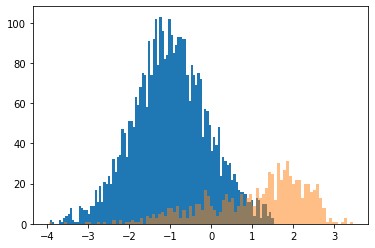

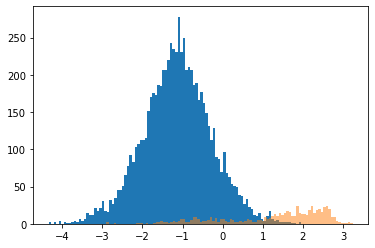

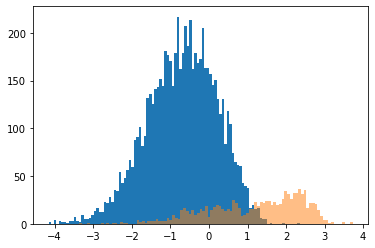

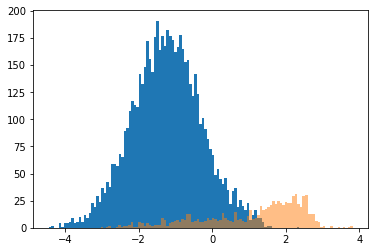

...

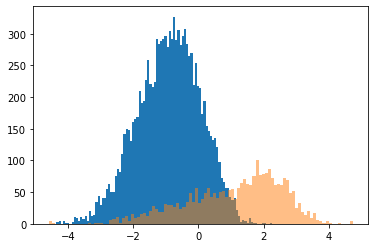

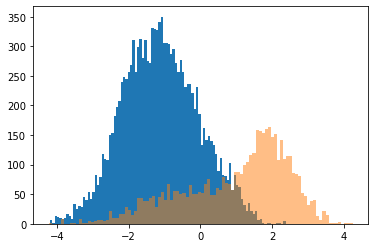

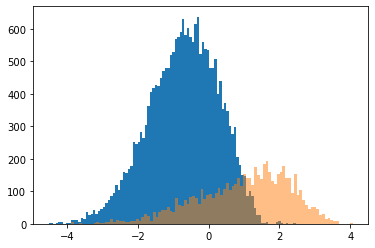

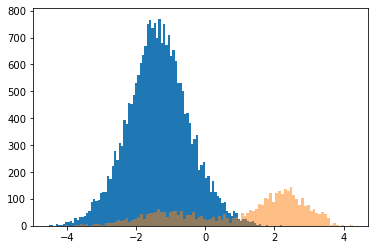

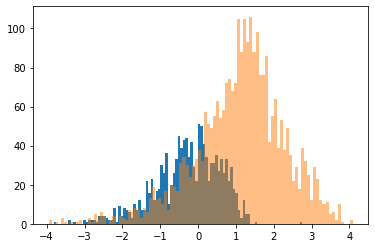

/var/folders/t4/yj25b68j71bg4j7p_w5jwglm0000gn/T/ipykernel_30907/4243057914.py:4: RuntimeWarning: invalid value encountered in log
  plt.hist(np.log(vS[i][saccade[i]==0]+0.01),100);


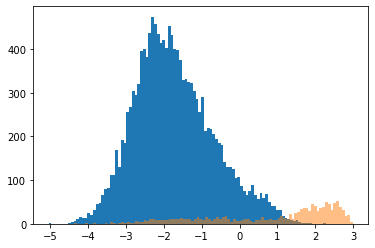

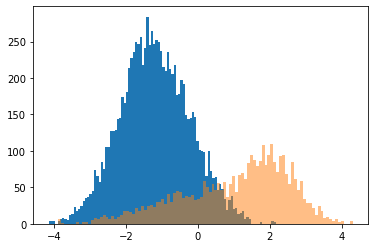

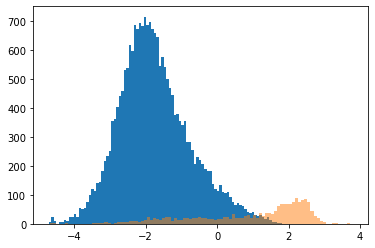

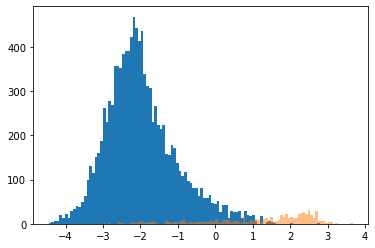

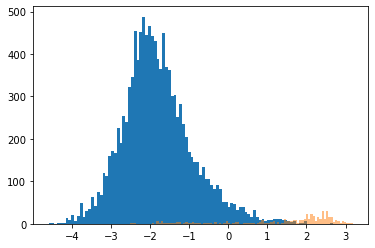

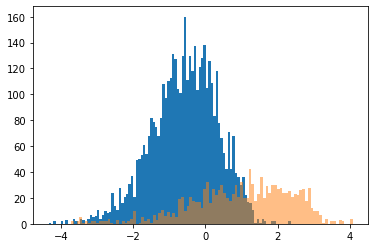

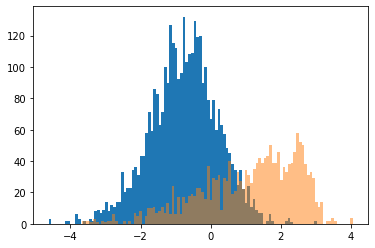

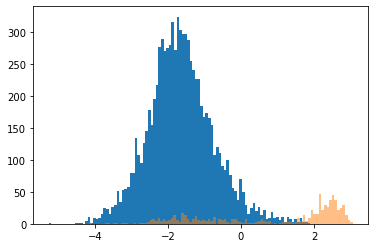

/var/folders/t4/yj25b68j71bg4j7p_w5jwglm0000gn/T/ipykernel_30907/4243057914.py:5: RuntimeWarning: invalid value encountered in log
  plt.hist(np.log(vS[i][saccade[i]]+0.01),100,alpha=0.5);


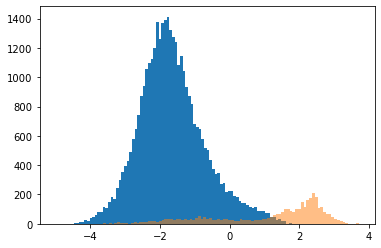

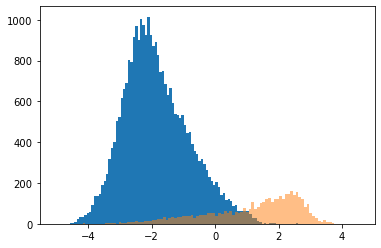

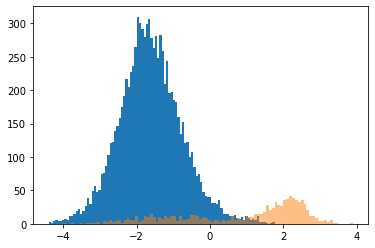

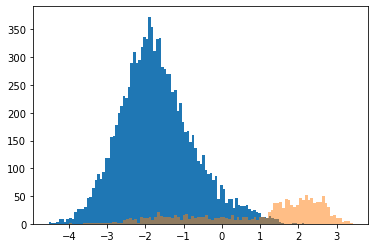

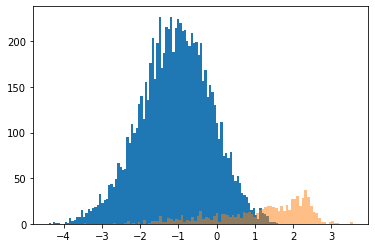

...

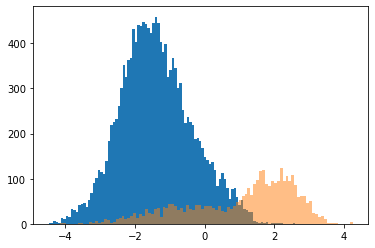

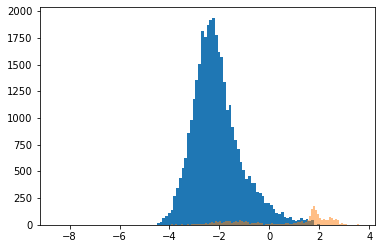

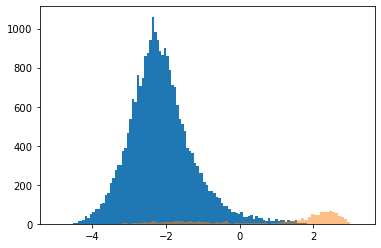

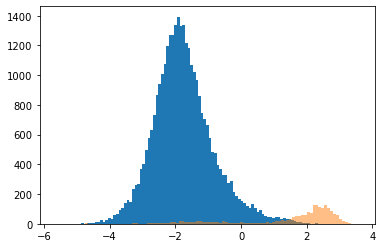

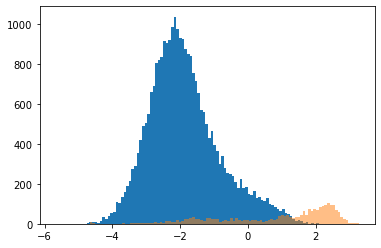

In [15]:
errors = []
for i in range(len(dS)):
    try:
        plt.hist(np.log(vS[i][saccade[i]==0]+0.01),100);
        plt.hist(np.log(vS[i][saccade[i]]+0.01),100,alpha=0.5);
        plt.show()
    except IndexError:
        errors.append(i)

0


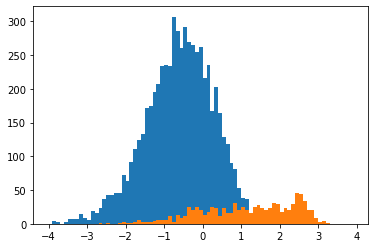

1


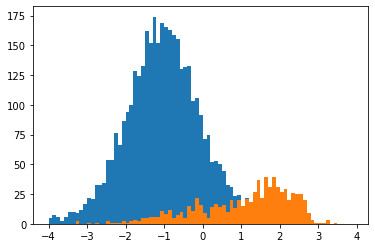

2


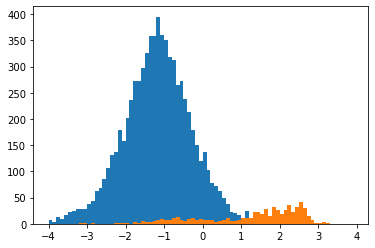

3


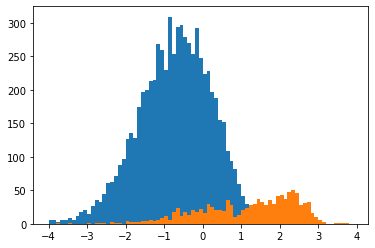

4


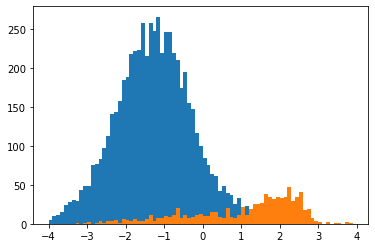

5


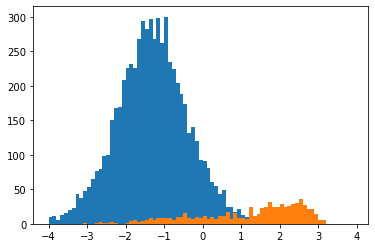

6


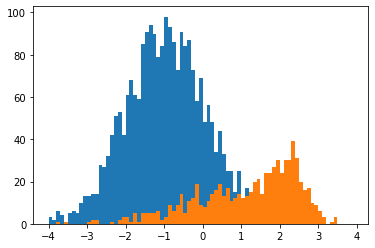

7


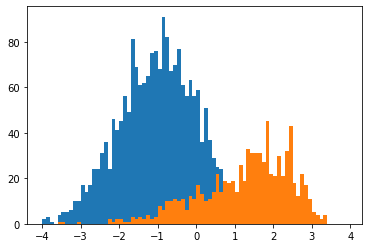

8


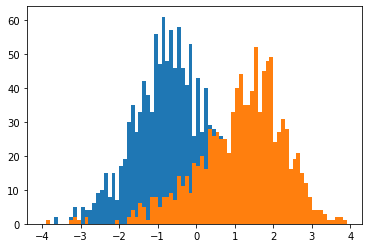

9


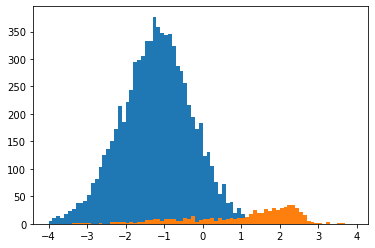

10


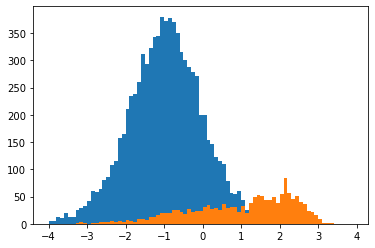

11


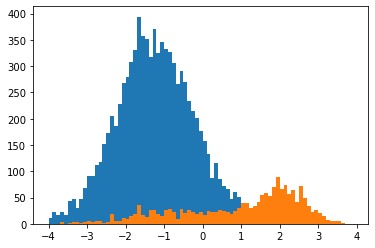

12


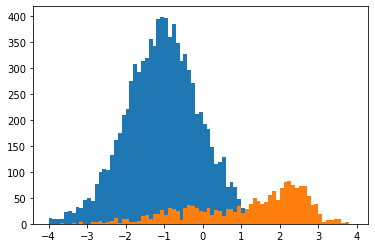

13


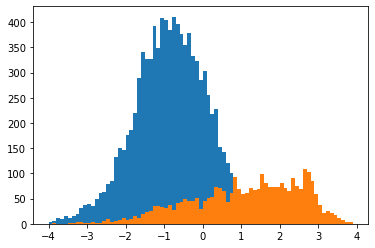

14


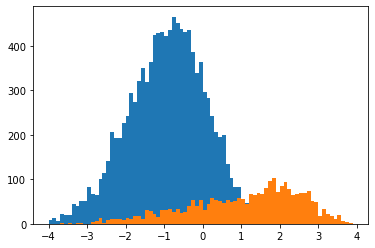

15


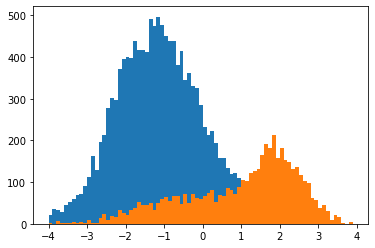

16


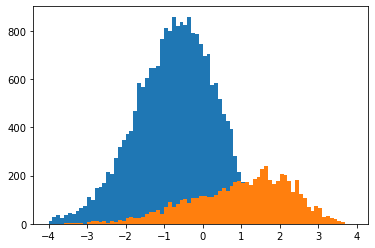

17


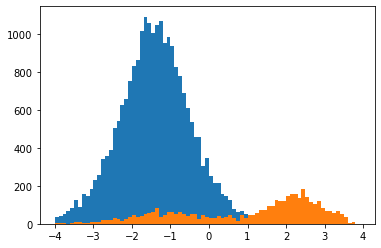

18


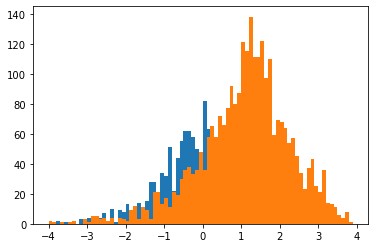

19


/var/folders/t4/yj25b68j71bg4j7p_w5jwglm0000gn/T/ipykernel_30907/1444523794.py:30: RuntimeWarning: invalid value encountered in log
  plt.hist(np.log(guess_dS_fix),np.arange(-4,4,0.1));


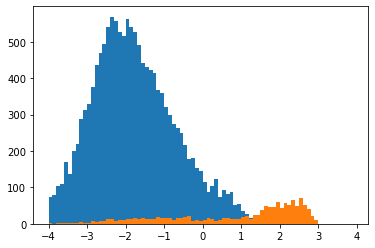

20


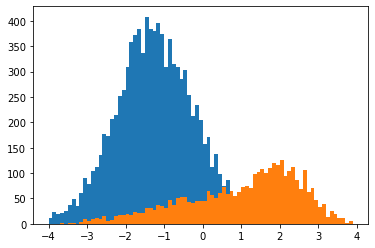

21


/var/folders/t4/yj25b68j71bg4j7p_w5jwglm0000gn/T/ipykernel_30907/1444523794.py:30: RuntimeWarning: divide by zero encountered in log
  plt.hist(np.log(guess_dS_fix),np.arange(-4,4,0.1));
/var/folders/t4/yj25b68j71bg4j7p_w5jwglm0000gn/T/ipykernel_30907/1444523794.py:31: RuntimeWarning: invalid value encountered in log
  plt.hist(np.log(guess_dS_sacc),np.arange(-4,4,0.1));


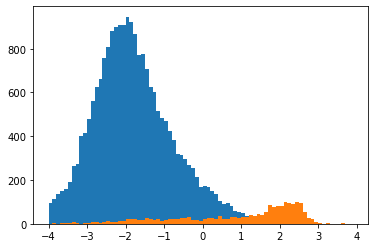

22


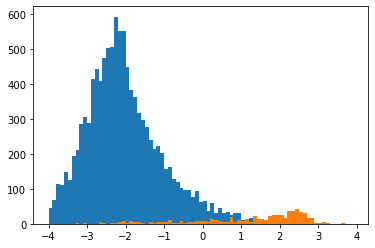

23


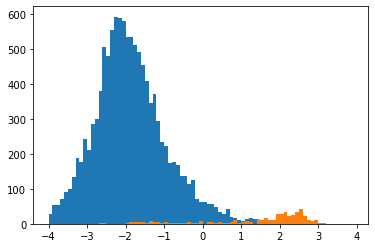

24


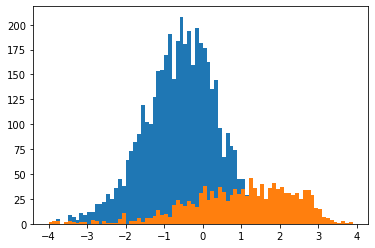

25


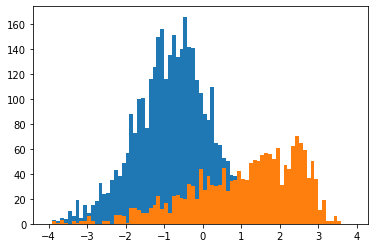

26


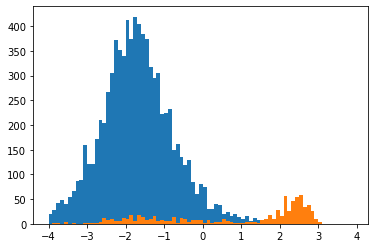

27


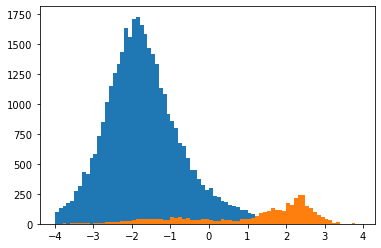

28


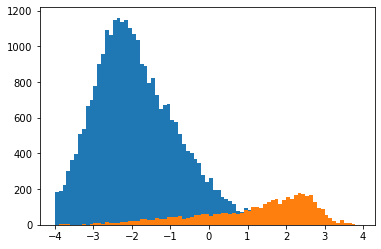

29


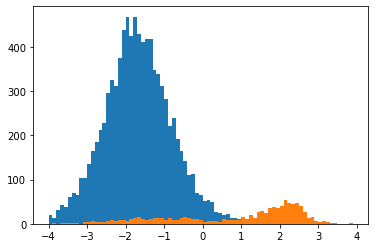

30


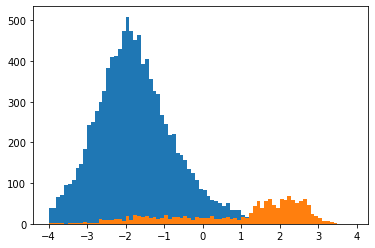

31


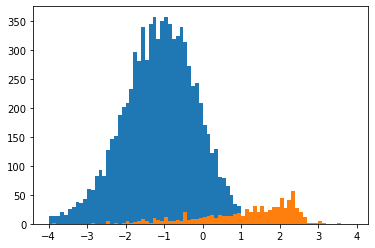

32


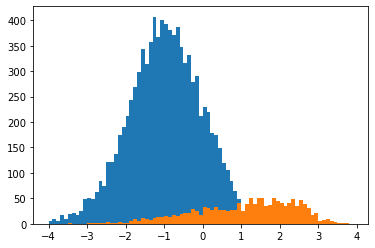

33


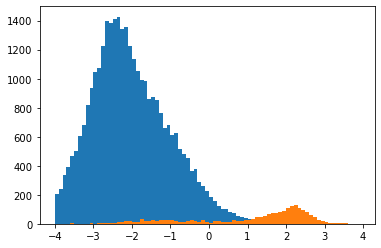

34


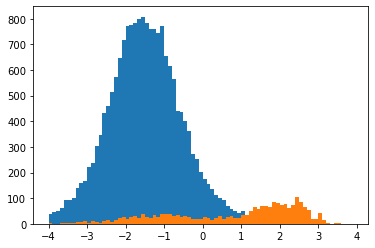

35


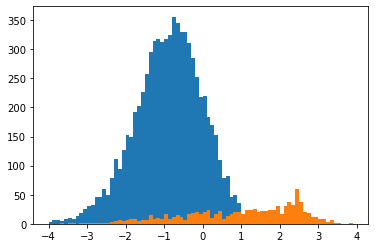

36


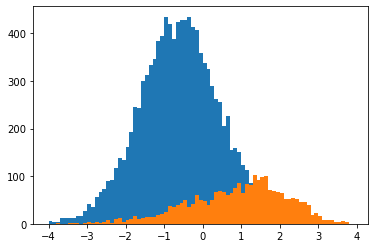

37


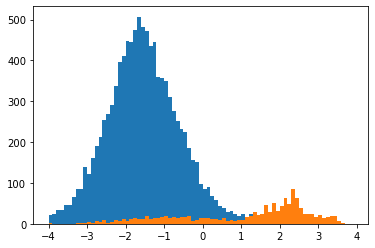

38


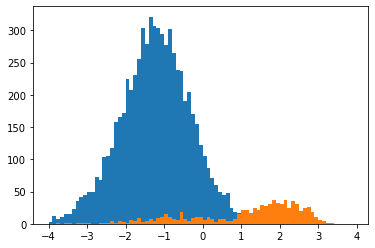

39


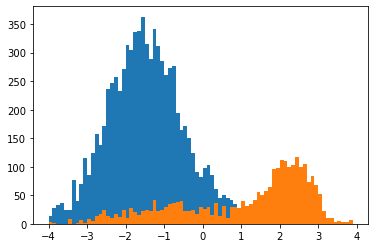

40


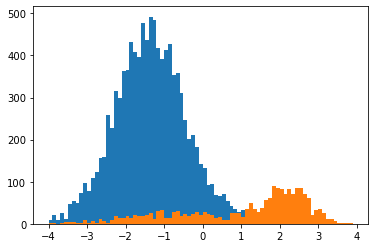

41


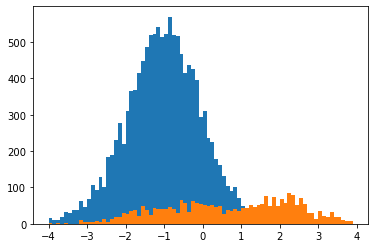

42


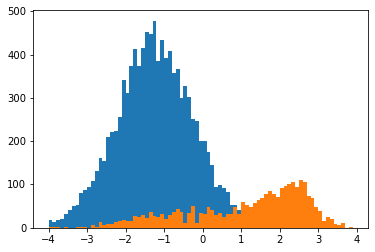

43


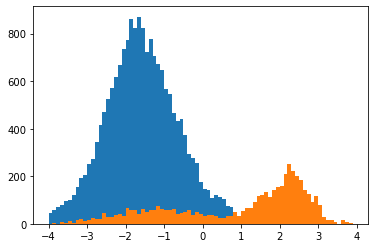

44


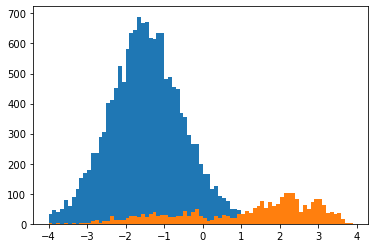

45


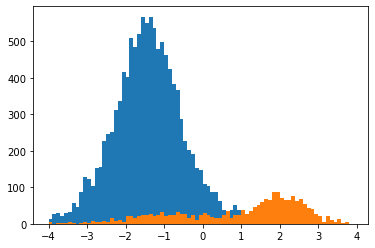

46


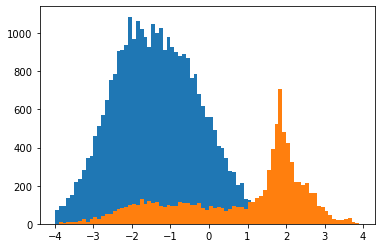

47


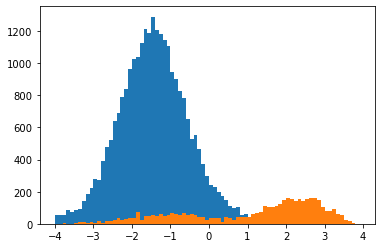

48


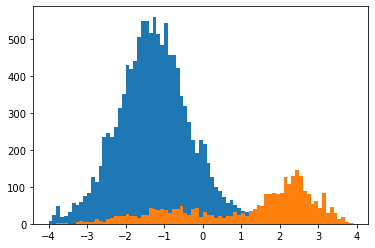

49


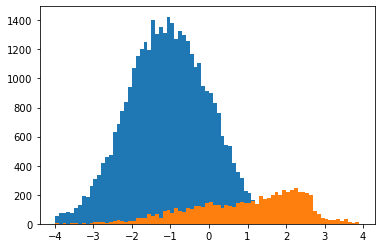

50


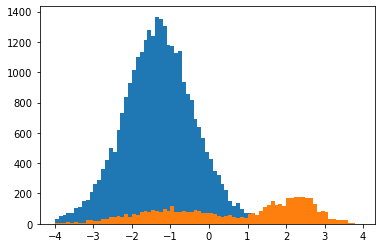

51


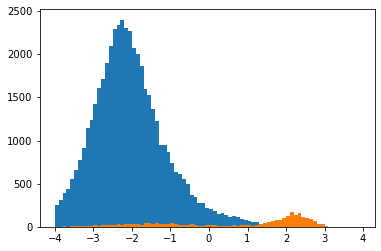

52


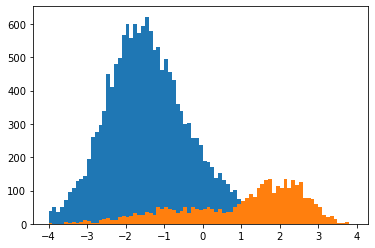

53


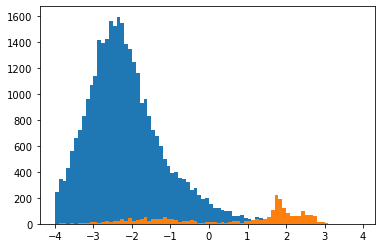

54


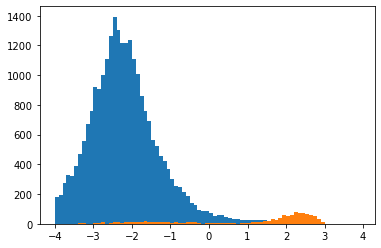

55


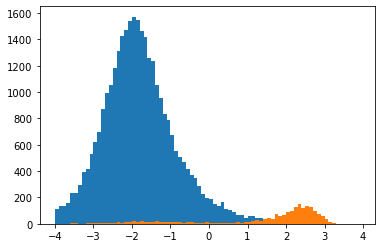

56


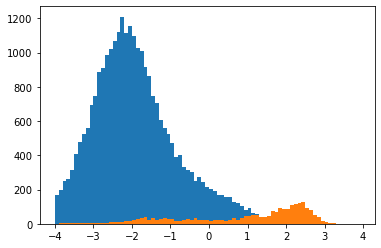

In [16]:
est_sacc_mu = []
est_sacc_sigma = []
est_fix_mu = []
est_fix_sigma = []
est_lambda_B_list = [] #transition saccade to fix 
est_lambda_D_list = [] # vice versa
guess_logdS_fix_list = []
guess_logdS_sacc_list = []
T_matrix = []
for i in range(len(dS)):
    print(i)
    d__ss = vS[i]
    binary_vector = np.array(saccade[i]).astype(int)
    guess_dS_fix = vS[i][binary_vector==0]
    guess_dS_sacc = vS[i][binary_vector==1]
    guess_logdS_fix = np.log(guess_dS_fix[guess_dS_fix>0])
    guess_logdS_fix_list.append(guess_logdS_fix)
    guess_logdS_sacc = np.log(guess_dS_sacc[guess_dS_sacc>0])
    guess_logdS_sacc_list.append(guess_logdS_sacc)
    est_fix_mu.append(np.mean(guess_logdS_fix))
    est_fix_sigma.append(np.std(guess_logdS_fix))
    est_sacc_mu.append(np.mean(guess_logdS_sacc))
    est_sacc_sigma.append(np.std(guess_logdS_sacc))
    Nfix = len(binary_vector) - np.sum(binary_vector)
    Nsacc = np.sum(binary_vector)
    Ntransi = int(np.sum(np.abs(binary_vector[1:] - binary_vector[:-1]))/2)
    T_matrix.append(np.matrix([[1 - Ntransi/Nfix ,Ntransi/Nfix ],[Ntransi/Nsacc ,1 - Ntransi/Nsacc ]]))
    est_lambda_B_list.append(-np.log(Ntransi / Nsacc))
    est_lambda_D_list.append(-np.log(Ntransi / Nfix))
    plt.hist(np.log(guess_dS_fix),np.arange(-4,4,0.1));
    plt.hist(np.log(guess_dS_sacc),np.arange(-4,4,0.1));
    plt.show()
    

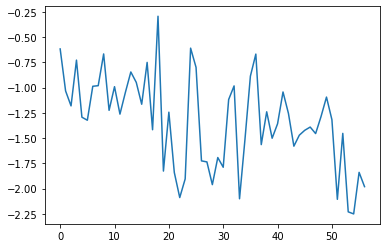

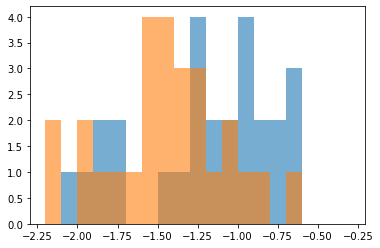

-1.162509094742387
-1.5023862515892152
---------------------


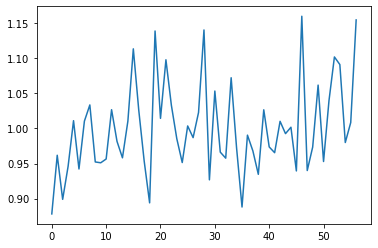

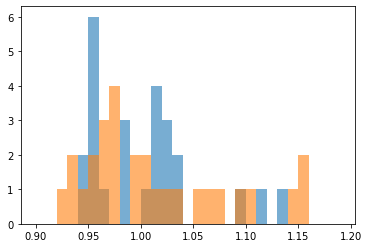

0.9906559146809247
1.0082952529344142
---------------------


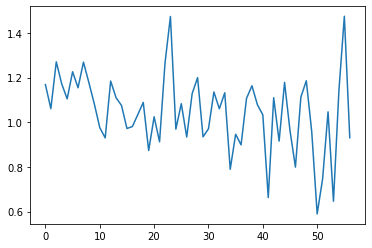

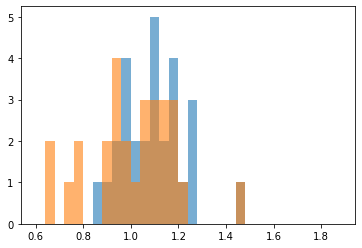

1.0966195776712393
0.9970484336672063
---------------------


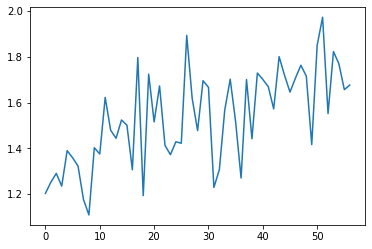

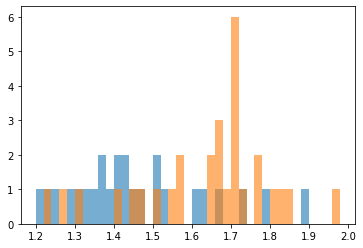

1.430222749969165
1.6313646710148
---------------------


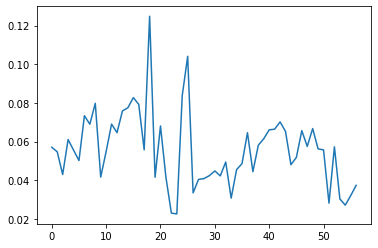

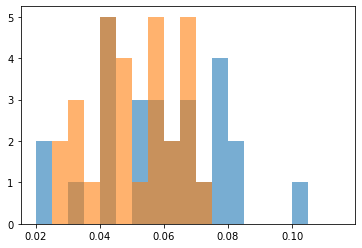

0.061721520447559526
0.05018060146383767
---------------------


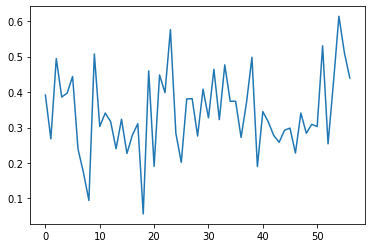

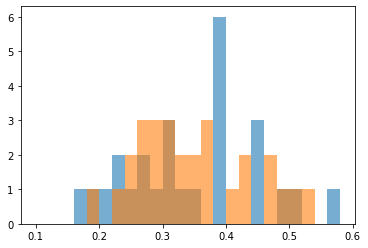

0.3254902932281372
0.35811867886216703


In [17]:
plt.plot(est_fix_mu)
plt.show()
plt.hist(est_fix_mu[:separation_threshold2],np.arange(-2.2,-0.2,0.1),alpha=0.6)
plt.hist(est_fix_mu[separation_threshold2:],np.arange(-2.2,-0.2,0.1),alpha=0.6)
plt.show()
print(np.mean(est_fix_mu[:separation_threshold2]))
print(np.mean(est_fix_mu[separation_threshold2:]))
print("---------------------")
plt.plot(est_fix_sigma)
plt.show()
plt.hist(est_fix_sigma[:separation_threshold2],np.arange(0.9,1.2,0.01),alpha=0.6)
plt.hist(est_fix_sigma[separation_threshold2:],np.arange(0.9,1.2,0.01),alpha=0.6)
plt.show()
print(np.mean(est_fix_sigma[:separation_threshold2]))
print(np.mean(est_fix_sigma[separation_threshold2:]))
print("---------------------")
plt.plot(est_sacc_mu)
plt.show()
plt.hist(est_sacc_mu[:separation_threshold2],np.arange(0.6,1.9,0.04),alpha=0.6)
plt.hist(est_sacc_mu[separation_threshold2:],np.arange(0.6,1.9,0.04),alpha=0.6)
plt.show()
print(np.mean(est_sacc_mu[:separation_threshold2]))
print(np.mean(est_sacc_mu[separation_threshold2:]))
print("---------------------")
plt.plot(est_sacc_sigma)
plt.show()
plt.hist(est_sacc_sigma[:separation_threshold2],np.arange(1.2,2,0.02),alpha=0.6)
plt.hist(est_sacc_sigma[separation_threshold2:],np.arange(1.2,2,0.02),alpha=0.6)
plt.show()
print(np.mean(est_sacc_sigma[:separation_threshold2]))
print(np.mean(est_sacc_sigma[separation_threshold2:]))
print("---------------------")
est_P_fix_sacc = []
for i in range(len(dS)):
    est_P_fix_sacc.append(np.swapaxes(T_matrix,0,1)[0][i][1] )
plt.plot(est_P_fix_sacc)
plt.show()
plt.hist(est_P_fix_sacc[:separation_threshold2],np.arange(0.02,0.12,0.005),alpha=0.6)
plt.hist(est_P_fix_sacc[separation_threshold2:],np.arange(0.02,0.12,0.005),alpha=0.6)
plt.show()
print(np.mean(est_P_fix_sacc[:separation_threshold2]))
print(np.mean(est_P_fix_sacc[separation_threshold2:]))
print("---------------------")
est_P_sacc_fix = []
for i in range(len(dS)):
    est_P_sacc_fix.append(np.swapaxes(T_matrix,0,1)[1][i][0] )
plt.plot(est_P_sacc_fix)
plt.show()
plt.hist(est_P_sacc_fix[:separation_threshold2],np.arange(0.1,0.6,0.02),alpha=0.6)
plt.hist(est_P_sacc_fix[separation_threshold2:],np.arange(0.1,0.6,0.02),alpha=0.6)
plt.show()
print(np.mean(est_P_sacc_fix[:separation_threshold2]))
print(np.mean(est_P_sacc_fix[separation_threshold2:]))

0


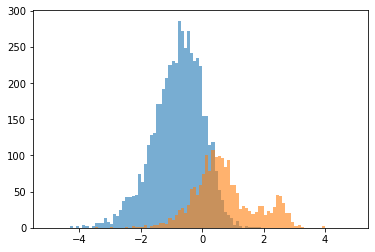

1


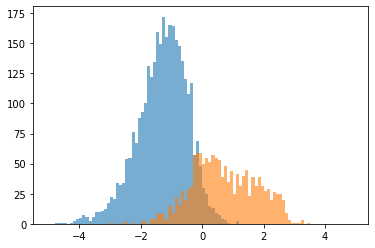

2


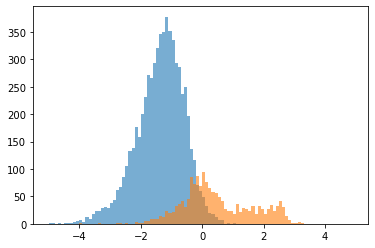

3


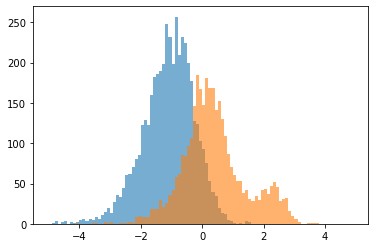

4


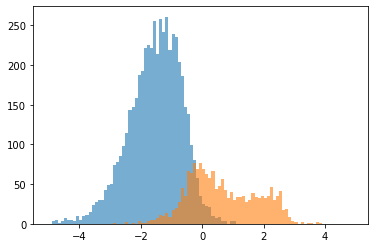

5


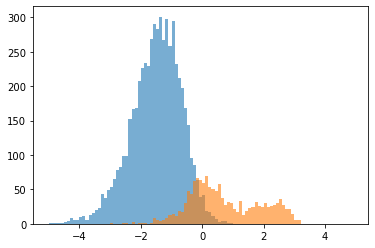

6


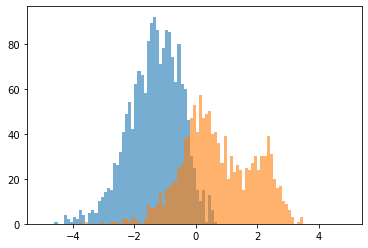

7


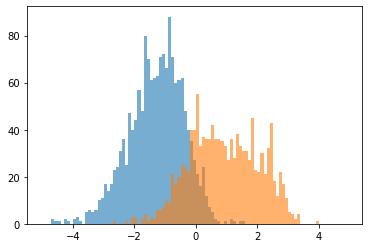

8


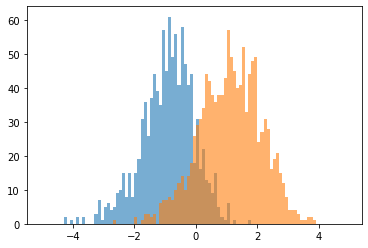

9


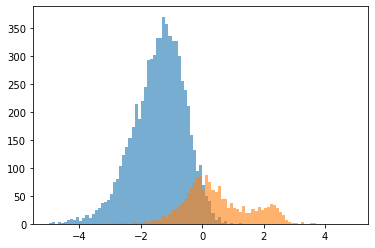

10


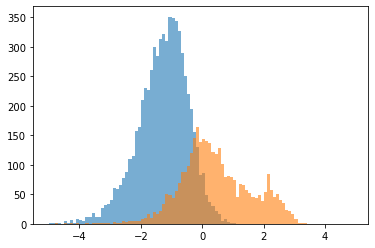

11


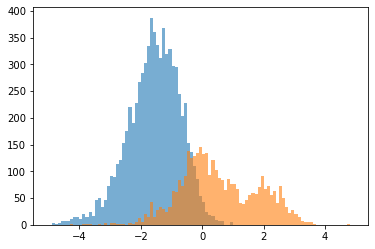

12


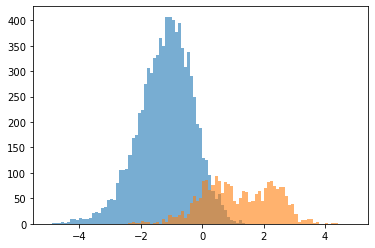

13


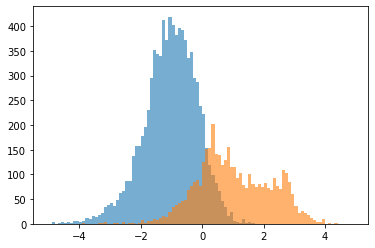

14


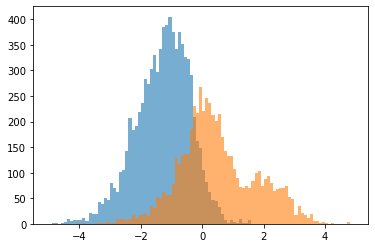

15


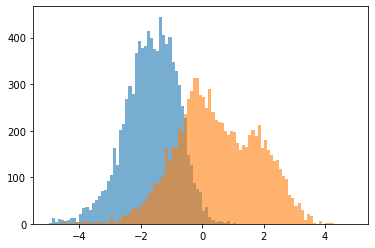

16


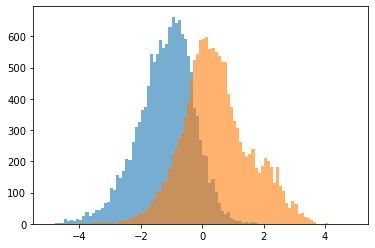

17


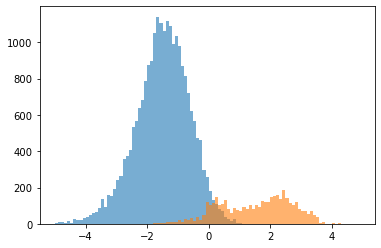

18


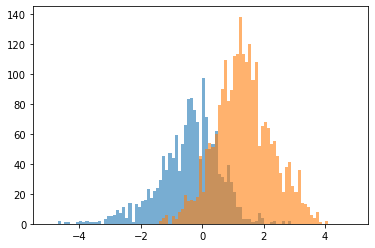

19


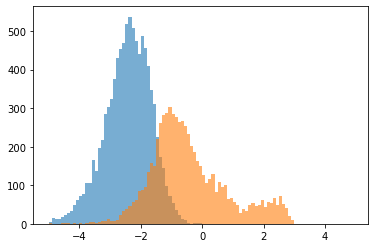

20


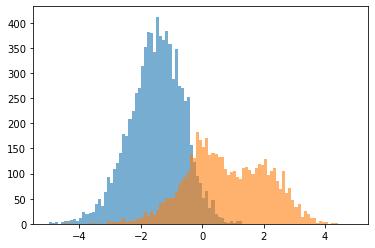

21


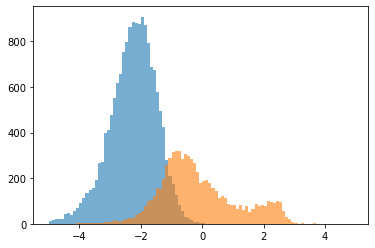

22


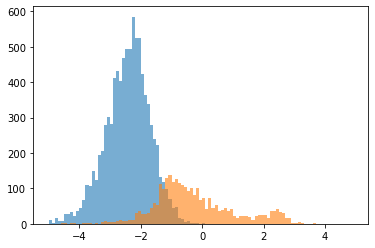

23


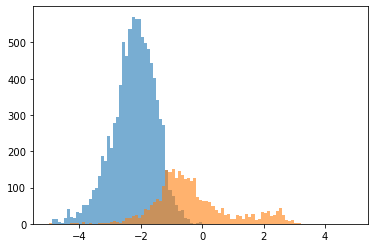

24


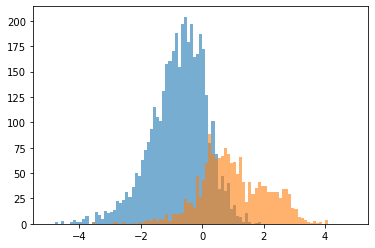

25


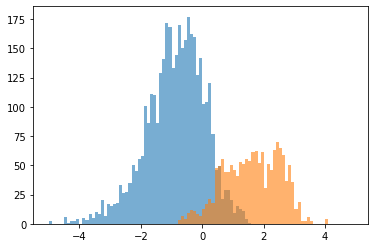

26


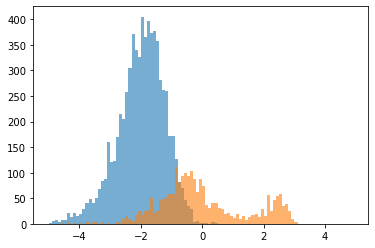

27


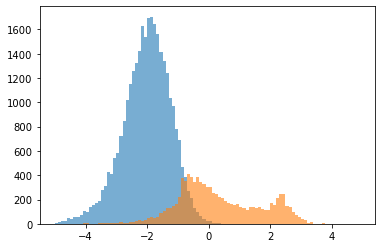

28


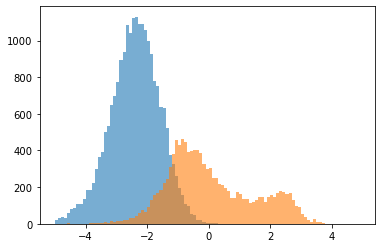

29


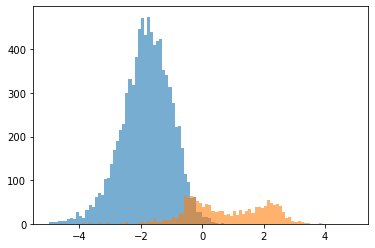

30


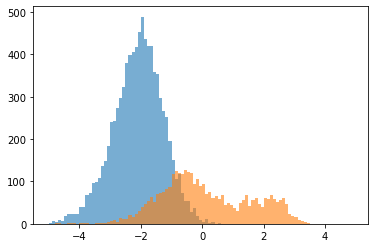

31


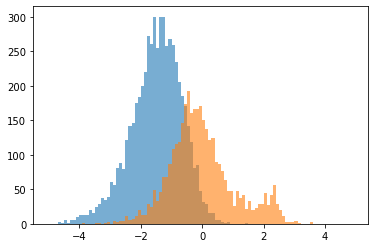

32


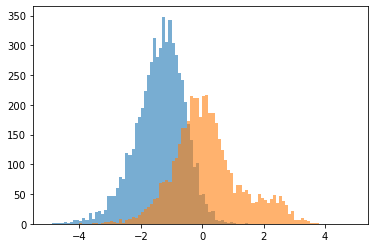

33


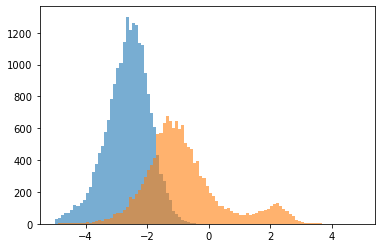

34


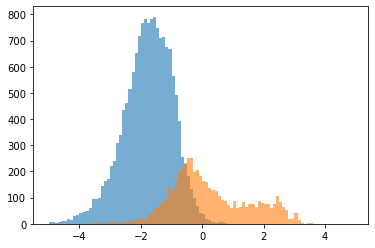

35


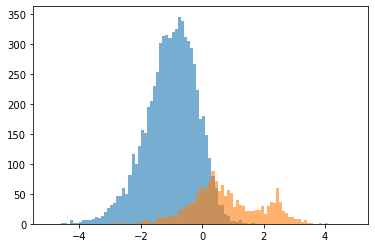

36


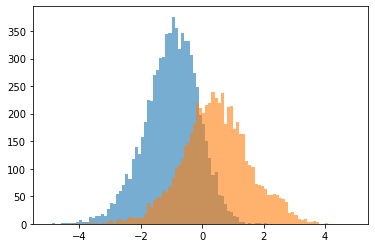

37


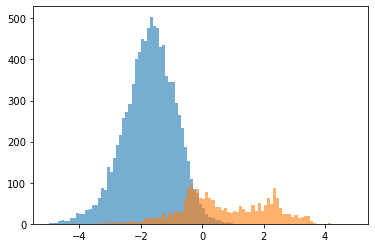

38


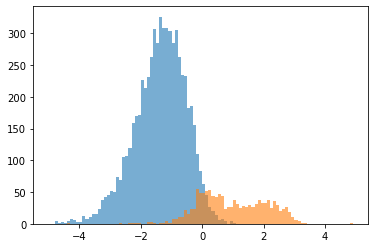

39


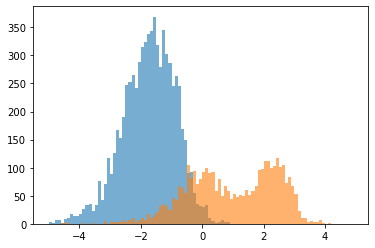

40


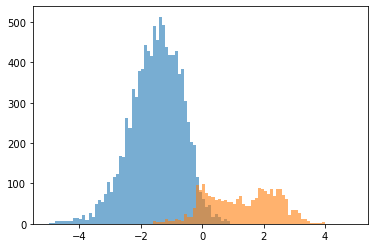

41


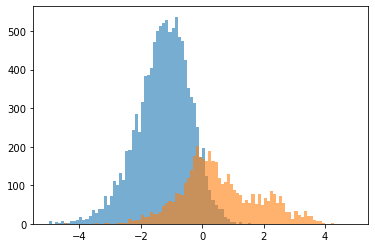

42


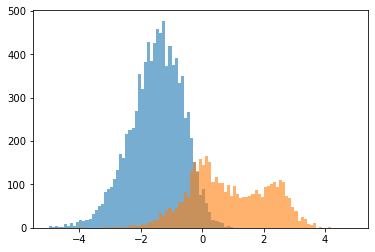

43


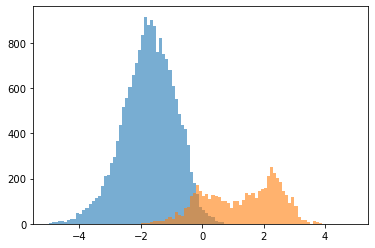

44


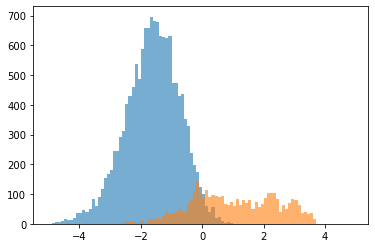

45


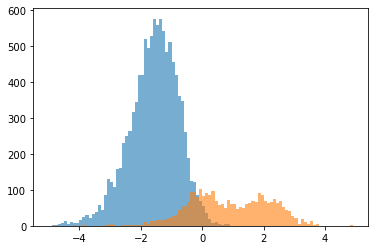

46


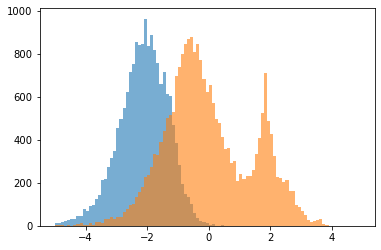

47


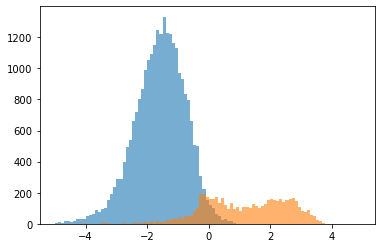

48


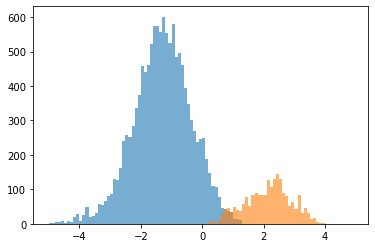

49


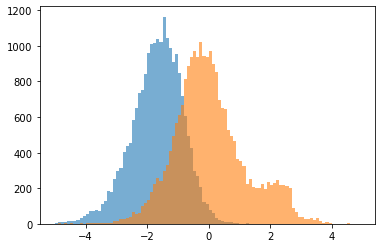

50


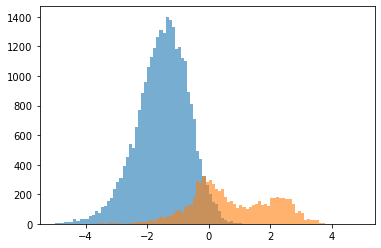

51


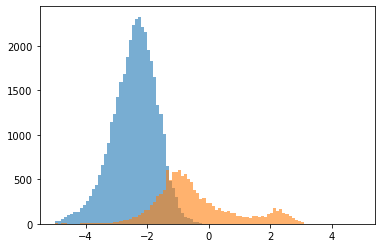

52


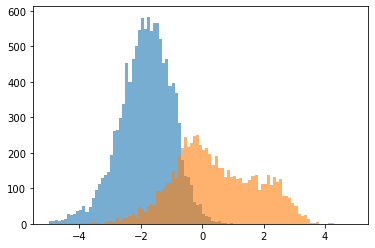

53


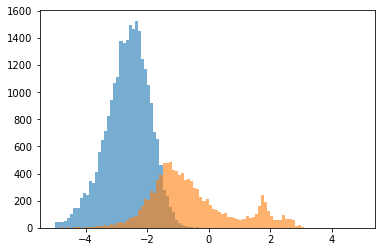

54


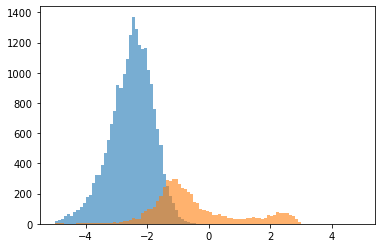

55


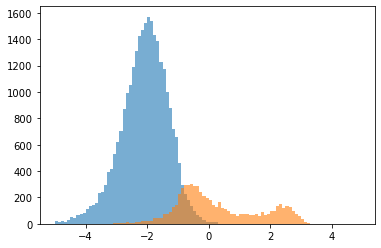

56


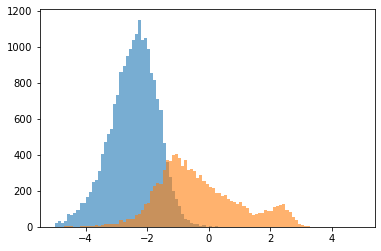

In [18]:


from pomegranate import *
HMM_est_sacc_mu = []
HMM_est_sacc_sigma = []
HMM_est_fix_mu = []
HMM_est_fix_sigma = []
HMM_est_D_list = []
HMM_est_lambda_B_list = []
HMM_est_lambda_D_list = []
HMM_logdS_fix_list = []
HMM_logdS_sacc_list = []
HMM_T_matrix = []

for i in range(len(vS)):
    print(i)
    prbd = np.exp(-est_lambda_B_list[i])
    prbb = 1-prbd
    prdb = np.exp(-est_lambda_D_list[i])
    prdd = 1-prdb
    s1 = State(LogNormalDistribution(est_fix_mu[i], est_fix_sigma[i])) #fixations
    s2 = State(LogNormalDistribution(est_sacc_mu[i], est_sacc_sigma[i])) #saccades
    model = HiddenMarkovModel()
    model.add_states(s1, s2)
    model.add_transition(model.start, s1, 0.5)
    model.add_transition(model.start, s2, 0.5)
    model.add_transition(s1, s1, prdd)
    model.add_transition(s1, s2, prdb)
    model.add_transition(s2, s1, prbd)
    model.add_transition(s2, s2, prbb)
    model.add_transition(s2, model.end, 0.5*len(vS[i][vS[i]>0]))
    model.add_transition(s1, model.end, 0.5*len(vS[i][vS[i]>0]))
    model.bake()
    model.fit( [vS[i][vS[i]>0]] )
    temp_vel = vS[i][vS[i]>0]
    
    s1_mu = model.states[0].distribution.parameters[0]
    s2_mu = model.states[1].distribution.parameters[0]
    
    if s2_mu > s1_mu:
        HMM_est_fix_mu.append(model.states[0].distribution.parameters[0])
        HMM_est_fix_sigma.append(model.states[0].distribution.parameters[1])
        HMM_est_sacc_mu.append(model.states[1].distribution.parameters[0])
        HMM_est_sacc_sigma.append(model.states[1].distribution.parameters[1])
        HMM_bin_vec = np.swapaxes(model.viterbi(vS[i][vS[i]>0])[1],0,1)[0][1:-1]

        
        
        
    else:
        HMM_est_fix_mu.append(model.states[1].distribution.parameters[0])
        HMM_est_fix_sigma.append(model.states[1].distribution.parameters[1])
        HMM_est_sacc_mu.append(model.states[0].distribution.parameters[0])
        HMM_est_sacc_sigma.append(model.states[0].distribution.parameters[1])
        HMM_bin_vec = np.swapaxes(model.viterbi(vS[i][vS[i]>0])[1],0,1)[0][1:-1]
        HMM_bin_vec = np.abs(np.array(HMM_bin_vec) - np.ones(len(HMM_bin_vec)))

    Nfix = len(HMM_bin_vec) - np.sum(HMM_bin_vec)
    Nsacc = np.sum(HMM_bin_vec)
    Ntransi = int(np.sum(np.abs(HMM_bin_vec[1:] - HMM_bin_vec[:-1]))/2)
    HMM_est_lambda_B_list.append(-np.log(1 - Ntransi / Nsacc))
    HMM_est_lambda_D_list.append(-np.log(1 - Ntransi / Nfix))
    HMM_logdS_fix_list.append(temp_vel[HMM_bin_vec==0])
    HMM_logdS_sacc_list.append(temp_vel[HMM_bin_vec==1])
    HMM_T_matrix.append(np.matrix([[1 - Ntransi/Nfix ,Ntransi/Nfix ],[Ntransi/Nsacc ,1 - Ntransi/Nsacc ]]))
    
    plt.hist(np.log(temp_vel[HMM_bin_vec==0]),np.arange(-5,5,0.1),alpha=0.6);
    plt.hist(np.log(temp_vel[HMM_bin_vec==1]),np.arange(-5,5,0.1),alpha=0.6);
    plt.show()

    

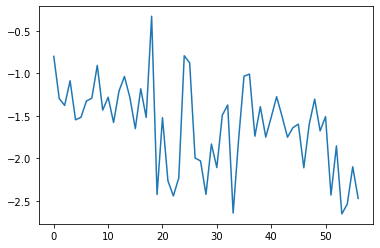

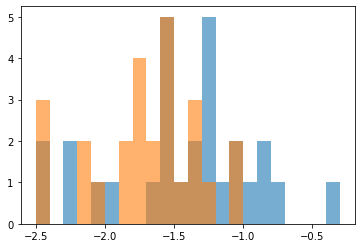

-1.4362556152220145
-1.7957091487274208
---------------------


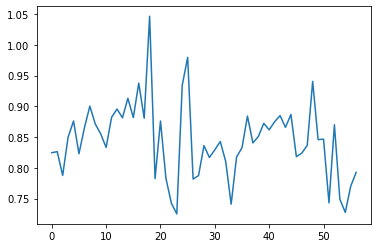

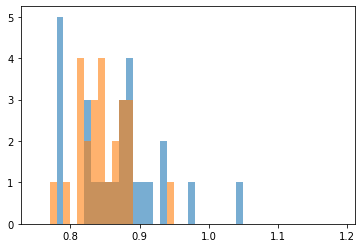

0.8579441325195439
0.8314546381728876
---------------------


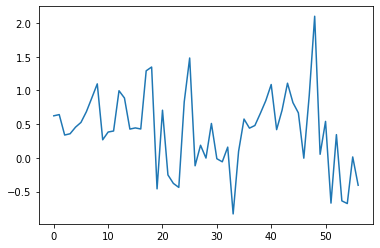

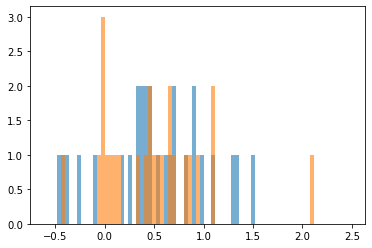

0.5013128337864312
0.3188141652544061
---------------------


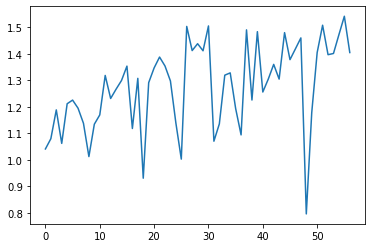

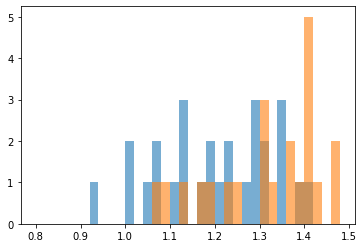

1.215069609365423
1.3367317740654896
---------------------


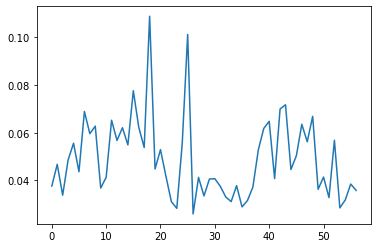

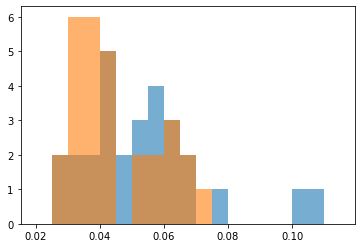

0.05354896389126155
0.04473922886549203
---------------------


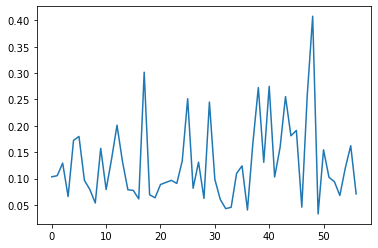

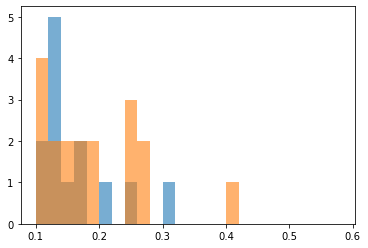

0.11833988460356341
0.14075584522804935


In [19]:
plt.plot(HMM_est_fix_mu)
plt.show()
plt.hist(HMM_est_fix_mu[:separation_threshold2],np.arange(-2.5,-0.2,0.1),alpha=0.6)
plt.hist(HMM_est_fix_mu[separation_threshold2:],np.arange(-2.5,-0.2,0.1),alpha=0.6)
plt.show()
print(np.mean(HMM_est_fix_mu[:separation_threshold2]))
print(np.mean(HMM_est_fix_mu[separation_threshold2:]))
print("---------------------")
plt.plot(HMM_est_fix_sigma)
plt.show()
plt.hist(HMM_est_fix_sigma[:separation_threshold2],np.arange(0.75,1.2,0.01),alpha=0.6)
plt.hist(HMM_est_fix_sigma[separation_threshold2:],np.arange(0.75,1.2,0.01),alpha=0.6)
plt.show()
print(np.mean(HMM_est_fix_sigma[:separation_threshold2]))
print(np.mean(HMM_est_fix_sigma[separation_threshold2:]))
print("---------------------")
plt.plot(HMM_est_sacc_mu)
plt.show()
plt.hist(HMM_est_sacc_mu[:separation_threshold2],np.arange(-0.6,2.5,0.04),alpha=0.6)
plt.hist(HMM_est_sacc_mu[separation_threshold2:],np.arange(-0.6,2.5,0.04),alpha=0.6)
plt.show()
print(np.mean(HMM_est_sacc_mu[:separation_threshold2]))
print(np.mean(HMM_est_sacc_mu[separation_threshold2:]))
print("---------------------")
plt.plot(HMM_est_sacc_sigma)
plt.show()
plt.hist(HMM_est_sacc_sigma[:separation_threshold2],np.arange(0.8,1.5,0.02),alpha=0.6)
plt.hist(HMM_est_sacc_sigma[separation_threshold2:],np.arange(0.8,1.5,0.02),alpha=0.6)
plt.show()
print(np.mean(HMM_est_sacc_sigma[:separation_threshold2]))
print(np.mean(HMM_est_sacc_sigma[separation_threshold2:]))
print("---------------------")
HMM_est_P_fix_sacc = []
for i in range(len(dS)):
    HMM_est_P_fix_sacc.append(np.swapaxes(HMM_T_matrix,0,1)[0][i][1] )
plt.plot(HMM_est_P_fix_sacc)
plt.show()
plt.hist(HMM_est_P_fix_sacc[:separation_threshold2],np.arange(0.02,0.12,0.005),alpha=0.6)
plt.hist(HMM_est_P_fix_sacc[separation_threshold2:],np.arange(0.02,0.12,0.005),alpha=0.6)
plt.show()
print(np.mean(HMM_est_P_fix_sacc[:separation_threshold2]))
print(np.mean(HMM_est_P_fix_sacc[separation_threshold2:]))
print("---------------------")
HMM_est_P_sacc_fix = []
for i in range(len(dS)):
    HMM_est_P_sacc_fix.append(np.swapaxes(HMM_T_matrix,0,1)[1][i][0] )
plt.plot(HMM_est_P_sacc_fix)
plt.show()
plt.hist(HMM_est_P_sacc_fix[:separation_threshold2],np.arange(0.1,0.6,0.02),alpha=0.6)
plt.hist(HMM_est_P_sacc_fix[separation_threshold2:],np.arange(0.1,0.6,0.02),alpha=0.6)
plt.show()
print(np.mean(HMM_est_P_sacc_fix[:separation_threshold2]))
print(np.mean(HMM_est_P_sacc_fix[separation_threshold2:]))

In [24]:
explore_t_ASD = []
explore_t_TD = []
explore_part = []
for t in range(10,400,10):
    explore_temp = []
    #print(t)
    for i in range(len(XX)):
        occu_matrix=np.histogram2d(XX[i][:t], YY[i][:t], bins=[np.arange(-100,1400,50),np.arange(-100,1100,40)],density= False)[0]
        explore_matrix=np.where(occu_matrix != 0, 1, 0)
        explore_temp.append(np.sum(explore_matrix))
        
    explore_t_ASD.append(np.mean(explore_temp[:separation_threshold2]))
    explore_t_TD.append(np.mean(explore_temp[separation_threshold2:]))

In [25]:
times = np.arange(5,350,5)
temp_explore_part = []
mean_explore_part = []
for i in range(len(XX)):
    temp_explore_part.append([])
    for t in times:
        occu_matrix=np.histogram2d(XX[i][:t], YY[i][:t], bins=[np.arange(-200,1500,10),np.arange(-200,1300,10)],density= False)[0]
        explore_matrix=np.where(occu_matrix != 0, 1, 0)
        temp_explore_part[-1].append(np.sum(explore_matrix))
    mean_explore_part.append(np.mean(np.array(temp_explore_part)/times ))


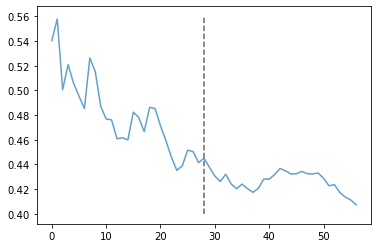

In [26]:
plt.plot(mean_explore_part,color = 'tab:blue',alpha = 0.7)
#plt.hlines(max(mean_explore_part[separation_threshold2:]),55,0,color = 'k')
#plt.hlines(min(mean_explore_part[:separation_threshold2]),55,0,color = 'k')
plt.vlines(separation_threshold2,0.4,0.56,color = 'dimgrey',linestyle='--')

In [29]:
print(np.mean(mean_explore_part[:separation_threshold2]))
print(np.mean(mean_explore_part[separation_threshold2:]))

0.4808169327866548
0.4269497430588965


In [23]:
results = []
for i in range(len(XX)):
    select = np.ones(len(XX))
    select[i] = 0
    lr_X_HMM = [np.array(mean_explore_part)[[np.array(select) == np.ones(len(XX))]]]
    lr_X_HMM = np.swapaxes(lr_X_HMM,0,1)
    lr_Y = np.append(np.ones(separation_threshold2),np.zeros(len(XX)-separation_threshold2))
    lr_Y = lr_Y[[np.array(select) == np.ones(len(XX))]]
    log_reg = LogisticRegression(penalty='none', random_state=0)
    clf_HMM = log_reg.fit(lr_X_HMM, lr_Y)
    
    lr_X_HMM_test = np.array([mean_explore_part[i]])
    results.append(clf_HMM.predict(np.array(lr_X_HMM_test).reshape(-1, 1)))
    
results = np.transpose(results)[0]
lr_Y = np.append(np.ones(separation_threshold2),np.zeros(len(XX)-separation_threshold2))
plt.plot(np.array(results)-lr_Y)
print( np.sum(np.abs(np.array(results)-lr_Y)   ))

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

In [ ]:
plt.plot(lr_X_HMM)

In [ ]:
results = []
coefs_list = []
for i in range(len(XX)):
    select = np.ones(len(XX))
    select[i] = 0
    llr_X_HMM = [est_fix_mu,est_sacc_sigma,est_P_fix_sacc,mean_explore_part]
    for j in range(len(llr_X_HMM)):
        llr_X_HMM[j] = (llr_X_HMM[j]-np.mean(llr_X_HMM[j]))/np.std(llr_X_HMM[j])
    lr_X_HMM =[]
    for j in range(len(llr_X_HMM)):
        lr_X_HMM.append(np.array(llr_X_HMM[j])[[np.array(select) == np.ones(len(XX))]])

    lr_X_HMM = np.swapaxes(lr_X_HMM,0,1)
    lr_Y = np.append(np.ones(separation_threshold2),np.zeros(len(XX)-separation_threshold2))
    lr_Y = lr_Y[[np.array(select) == np.ones(len(XX))]]
    log_reg = LogisticRegression(penalty='none', random_state=0)
    clf_HMM = log_reg.fit(lr_X_HMM, lr_Y)
    
    lr_X_HMM_test =[]
    for j in range(len(llr_X_HMM)):
        lr_X_HMM_test.append(llr_X_HMM[j][i])

    results.append(clf_HMM.predict([lr_X_HMM_test]))
    coefs_list.append(clf_HMM.coef_)
    
results = np.transpose(results)[0]
lr_Y = np.append(np.ones(separation_threshold2),np.zeros(len(XX)-separation_threshold2))
plt.plot(np.array(results)-lr_Y)
print( np.sum(np.abs(np.array(results)-lr_Y)   ))

In [ ]:
PI = permutation_importance(log_reg, np.swapaxes(llr_X_HMM,1,0), lr_Y, n_repeats=10,
                             random_state=0)

In [ ]:
PI['importances_mean']

In [ ]:
np.mean(coefs_list,axis=0)

In [ ]:
clf = RandomForestClassifier(max_depth=2, random_state=0)

In [ ]:
sorted_importances_idx = PI.importances_mean.argsort()
importances = pd.DataFrame(
    result.importances[sorted_importances_idx].T,
    columns=pd.DataFrame(np.swapaxes(llr_X_HMM,1,0), columns =[r'$\mu_{fix}$', r'$\sigma_{sacc}$',r'$P_{FS}$',r'$AVA_{\tau}$']).columns[sorted_importances_idx],
)
[est_fix_mu,est_sacc_sigma,est_P_fix_sacc,mean_explore_part]
ax = importances.plot.box(vert=False, whis=10)
ax.set_title("Permutation Importances ")
ax.axvline(x=0, color="k", linestyle="--")
ax.set_xlabel("Decrease in accuracy score")
ax.figure.tight_layout()

In [ ]:
results = []
coefs_list = []
for i in range(len(XX)):
    select = np.ones(len(XX))
    select[i] = 0
    llr_X_HMM = [est_fix_mu,est_sacc_sigma,est_P_fix_sacc,mean_explore_part]
    for j in range(len(llr_X_HMM)):
        llr_X_HMM[j] = (llr_X_HMM[j]-np.mean(llr_X_HMM[j]))/np.std(llr_X_HMM[j])
    lr_X_HMM =[]
    for j in range(len(llr_X_HMM)):
        lr_X_HMM.append(np.array(llr_X_HMM[j])[[np.array(select) == np.ones(len(XX))]])

    lr_X_HMM = np.swapaxes(lr_X_HMM,0,1)
    lr_Y = np.append(np.ones(separation_threshold2),np.zeros(len(XX)-separation_threshold2))
    lr_Y = lr_Y[[np.array(select) == np.ones(len(XX))]]
    Rand_Forest = RandomForestClassifier(max_depth=3, random_state=0)
    clf_HMM = Rand_Forest.fit(lr_X_HMM, lr_Y)
    
    lr_X_HMM_test =[]
    for j in range(len(llr_X_HMM)):
        lr_X_HMM_test.append(llr_X_HMM[j][i])

    results.append(clf_HMM.predict([lr_X_HMM_test]))
    #coefs_list.append(clf_HMM.coef_)
    
results = np.transpose(results)[0]
lr_Y = np.append(np.ones(separation_threshold2),np.zeros(len(XX)-separation_threshold2))
plt.plot(np.array(results)-lr_Y)
print( np.sum(np.abs(np.array(results)-lr_Y)   ))

In [ ]:
import sklearn.metrics 
y_pred = results
y_test = lr_Y
plt.rcParams.update({'font.size': 14})


cm=sklearn.metrics.confusion_matrix(y_test, y_pred)

fig, ax = plt.subplots()
im = ax.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
ax.figure.colorbar(im, ax=ax)
ax.set(xticks=[0,1], yticks=[0,1], xlabel='Predicted label', ylabel='True label',)
ax.set_xticklabels(['TD', 'ASD'])
ax.set_yticklabels(['TD', 'ASD'])
for i in range(2):
    for j in range(2):
        ax.text(j, i, format(cm[i, j], 'd'), ha='center', va='center', color='white' if cm[i, j] > cm.max() / 2 else 'black')
plt.tight_layout()    
plt.savefig('confusion_matrix.png',dpi=400)

accuracy= (cm[1,1]+cm[0,0])/(cm[1,0]+cm[1,1] + cm[0,0]+cm[0,1])
print('Accuracy : ', accuracy)

specificity= cm[0,0]/(cm[0,0]+cm[0,1])
print('Specificity : ', specificity)

sensitivity= cm[1,1]/(cm[1,0]+cm[1,1])
print('Sensitivity : ', sensitivity)

precision= cm[1,1]/(cm[0,1]+cm[1,1])
print('Precision : ', accuracy)

In [ ]:
for i in range(separation_threshold2):
    lim = 300
    lpart = i
    plt.scatter(XX[lpart][:lim],YY[lpart][:lim])
    plt.plot(XX[lpart][:lim][saccade[lpart][:lim]],YY[lpart][:lim][saccade[lpart][:lim]],c='r',alpha=0.66)
    plt.hlines(0,0,1280,color = 'k')
    plt.hlines(1024,0,1280,color = 'k')
    plt.vlines(0,0,1024,color = 'k')
    plt.vlines(1280,0,1024,color = 'k')
    plt.savefig('GT-ASD_all_'+str(i)+'.png',dpi=300)
    plt.show()

In [ ]:
for i in range(separation_threshold2,len(XX)):
    lim = 300
    lpart = i
    print(i)
    plt.scatter(XX[lpart][:lim],YY[lpart][:lim])
    plt.plot(XX[lpart][:lim][saccade[lpart][:lim]],YY[lpart][:lim][saccade[lpart][:lim]],c='r',alpha=0.66)
    plt.hlines(0,0,1280,color = 'k')
    plt.hlines(1024,0,1280,color = 'k')
    plt.vlines(0,0,1024,color = 'k')
    plt.vlines(1280,0,1024,color = 'k')
    plt.savefig('GT-TD_all_'+str(i)+'.png',dpi=300)
    plt.show()

In [ ]:
# Import libraries
import tsfel
import glob
import zipfile

import numpy as np
import pandas as pd
import seaborn as sns

from matplotlib import pyplot as plt
from sklearn import preprocessing
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
from sklearn.feature_selection import VarianceThreshold
from sklearn.metrics import confusion_matrix, accuracy_score
sns.set()

In [14]:
pip install pandas

Note: you may need to restart the kernel to use updated packages.
